# Imports and dataset load

In [ ]:
# ************************ install library *************************************

!pip install barbar
!pip install tqdm


# ************************ import library **************************************
import torch
import numpy                        as np
from torchvision                    import datasets
from torch.utils.data               import DataLoader
import torchvision.transforms       as transforms
import torch.nn                     as nn
import torch.nn.functional          as F
from torch                          import optim
from torch.autograd                 import Variable
import torchvision.utils            as vutils
import torchvision                  as torchvision
from barbar                         import Bar
from google.colab                   import drive
import matplotlib.pyplot            as plt
import matplotlib.image             as mpimg
from tqdm                           import tqdm
from google.colab                   import files
from sklearn.neighbors              import KNeighborsClassifier
from skimage                        import io, transform
import torch                        as T
from sklearn.metrics                import accuracy_score
import time
import cv2
import pickle 
import shutil
import random
import os



print(torch.__version__)

# ************************ import dataset **************************************

drive.mount('/content/drive')
DATASET_DIR = '/content/drive/My Drive/NN/datasets/'
IMAGE_DIR = '/content/drive/My Drive/NN/datasets/images/'


# reduce resolution to train for generator and discriminator, higher for encoder 

def get_cifar10(data_dir=DATASET_DIR):
    """Returning cifar dataloder."""
    transform = transforms.Compose([transforms.Resize(32), #3x32x32 images.
                                    transforms.ToTensor()])
    train             = datasets.CIFAR10(root=data_dir, train=True, download=True, transform=transform)
    test              = datasets.CIFAR10(root=data_dir, train=False, download=True, transform=transform)
    train_dataloader  = DataLoader(train, batch_size=BATCH_SIZE, shuffle=True)
    test_dataloader   = DataLoader(test, batch_size=BATCH_SIZE, shuffle=True)
    DATASET           = "cifar10"
    return train_dataloader,test_dataloader

def get_SVHN(data_dir=DATASET_DIR):
    """Returning svhn dataloder."""
    transform = transforms.Compose([transforms.Resize(32), #3x32x32 images.
                                    transforms.ToTensor()])
    train             = datasets.SVHN(root=data_dir, split='train', download=True, transform=transform)
    test              = datasets.SVHN(root=data_dir, split='test', download=True, transform=transform)
    train_dataloader  = DataLoader(train, batch_size=BATCH_SIZE, shuffle=True)
    test_dataloader   = DataLoader(test, batch_size=BATCH_SIZE, shuffle=True)
    DATASET           = "SVHN"
    return train_dataloader,test_dataloader

def get_CELEB_A(data_dir=DATASET_DIR):
    """Returning celeb_a dataloder."""
    transform = transforms.Compose([transforms.Resize(32), #3x32x32 images.
                                    transforms.ToTensor()])
    train               = datasets.CelebA(root=data_dir, split='train', download=True, transform=transform)
    test                = datasets.CelebA(root=data_dir, split='test', download=True, transform=transform)
    train_dataloader    = DataLoader(train, batch_size=BATCH_SIZE, shuffle=True)
    test_dataloader     = DataLoader(test, batch_size=BATCH_SIZE, shuffle=True)
    return train_dataloader,test_dataloader

def get_MNIST(data_dir=DATASET_DIR):
    """Returning mnist dataloder."""
    transform = transforms.Compose([transforms.Resize(32), #1x32x32 images.
                                    transforms.ToTensor()])
    train               = datasets.MNIST(root=data_dir, train=True, download=True, transform=transform)
    test                = datasets.MNIST(root=data_dir, train=False, download=True, transform=transform)
    train_dataloader    = DataLoader(train, batch_size=BATCH_SIZE, shuffle=True)
    test_dataloader     = DataLoader(test, batch_size=BATCH_SIZE, shuffle=True)
    DATASET             = "MNIST"
    return train_dataloader,test_dataloader


1.8.1+cu101
Mounted at /content/drive


In [ ]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1 and classname != 'Conv':
        torch.nn.init.normal_(m.weight.data, 0.0, 1e-3)
        if m.bias is not None:
            m.bias.data.fill_(0)
    elif classname.find("Linear") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 1e-3)
        if m.bias is not None:
            m.bias.data.fill_(0)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.01)
        if m.bias is not None:
            m.bias.data.fill_(0)

## Mount drive folder

In [ ]:
# se da errore, Runtime -> ripristina dati di fabbrica runtime
from google.colab import drive
drive.mount('/content/drive/', force_remount=True)

Mounted at /content/drive/


#Bigan Models

In [ ]:
'''
E and G cannot directly communicate, they must learn to invert the another in order
to fool the BIGAN discriminator.
In this context the latent representation z may be thought of as a "label" for x
, which comes for free without the need of supervisors. 
'''
class Discriminator(nn.Module):
    def __init__(self,z_dim=32):
        super(Discriminator, self).__init__()

        # Inference over x
        
        self.conv1_over_x   = nn.Conv2d(IMAGE_COLOR_DEEP, 32, 5, stride=1, bias=False)
        self.conv2_over_x   = nn.Conv2d(32, 64, 4, stride=2, bias=False)
        self.conv3_over_x   = nn.Conv2d(64, 128, 4, stride=1, bias=False)
        self.conv4_over_x   = nn.Conv2d(128, 256, 4, stride=2, bias=False)
        self.conv5_over_x   = nn.Conv2d(256, 512, 4, stride=1, bias=False)


        self.batch_normal2_over_x     = nn.BatchNorm2d(64)
        self.batch_normal3_over_x     = nn.BatchNorm2d(128)
        self.batch_normal4_over_x     = nn.BatchNorm2d(256)
        self.batch_normal5_over_x     = nn.BatchNorm2d(512)



        # Inference over z
        self.conv1_over_z = nn.Conv2d(z_dim, 512, 1, stride=1, bias=False)
        self.conv2_over_z = nn.Conv2d(512, 512, 1, stride=1, bias=False)

        # Joint inference
        self.conv1_inference_xz = nn.Conv2d(1024, 1024, 1, stride=1, bias=False)
        self.conv2_inference_xz = nn.Conv2d(1024, 1024, 1, stride=1, bias=False)
        self.conv3_inference_xz = nn.Conv2d(1024, 1, 1, stride=1, bias=False)


    def inference_x(self, x):
        x = F.dropout2d(F.leaky_relu(self.conv1_over_x(x), negative_slope=0.2), 0.2)
        x = F.dropout2d(F.leaky_relu(self.batch_normal2_over_x(self.conv2_over_x(x)), negative_slope=0.2), 0.2)
        x = F.dropout2d(F.leaky_relu(self.batch_normal3_over_x(self.conv3_over_x(x)), negative_slope=0.2), 0.2)
        x = F.dropout2d(F.leaky_relu(self.batch_normal4_over_x(self.conv4_over_x(x)), negative_slope=0.2), 0.2)
        x = F.dropout2d(F.leaky_relu(self.batch_normal5_over_x(self.conv5_over_x(x)), negative_slope=0.2), 0.2)
        return x

    def inference_z(self, z):
        z = F.dropout2d(F.leaky_relu(self.conv1_over_z(z), negative_slope=0.2), 0.2)
        z = F.dropout2d(F.leaky_relu(self.conv2_over_z(z), negative_slope=0.2), 0.2)
        return z

    def inference_xz(self, xz):
        xz = F.dropout(F.leaky_relu(self.conv1_inference_xz(xz), negative_slope=0.2), 0.2)
        xz = F.dropout(F.leaky_relu(self.conv2_inference_xz(xz), negative_slope=0.2), 0.2)
        return self.conv3_inference_xz(xz)

    def forward(self, x, z):
        x = self.inference_x(x)
        z = self.inference_z(z)
        xz = torch.cat((x,z), dim=1)
        out = self.inference_xz(xz)
        return torch.sigmoid(out)


class Generator(nn.Module):
    def __init__(self,z_dim=32):
        super(Generator, self).__init__()
        
        self.z_dim = z_dim

        self.output_bias = nn.Parameter(torch.zeros(IMAGE_COLOR_DEEP, 32, 32), requires_grad=True)

        self.deconv1_over_z = nn.ConvTranspose2d(z_dim, 256, 4, stride=1, bias=False)
        self.deconv2_over_z = nn.ConvTranspose2d(256, 128, 4, stride=2, bias=False)
        self.deconv3_over_z = nn.ConvTranspose2d(128, 64, 4, stride=1, bias=False)
        self.deconv4_over_z = nn.ConvTranspose2d(64, 32, 4, stride=2, bias=False)
        self.deconv5_over_z = nn.ConvTranspose2d(32, 32, 5, stride=1, bias=False)
        self.deconv6_over_z = nn.Conv2d(32, IMAGE_COLOR_DEEP, 1, stride=1, bias=True)


        self.batch_normal1_over_z = nn.BatchNorm2d(256)
        self.batch_normal2_over_z = nn.BatchNorm2d(128)
        self.batch_normal3_over_z = nn.BatchNorm2d(64)
        self.batch_normal4_over_z = nn.BatchNorm2d(32)
        self.batch_normal5_over_z = nn.BatchNorm2d(32)

    def forward(self, z):
        z = F.relu(self.batch_normal1_over_z(self.deconv1_over_z(z)))
        z = F.relu(self.batch_normal2_over_z(self.deconv2_over_z(z)))
        z = F.relu(self.batch_normal3_over_z(self.deconv3_over_z(z)))
        z = F.relu(self.batch_normal4_over_z(self.deconv4_over_z(z)))
        z = F.relu(self.batch_normal5_over_z(self.deconv5_over_z(z)))
        return torch.tanh(self.deconv6_over_z(z) + self.output_bias)


class Encoder(nn.Module):
    def __init__(self,z_dim=32, reparametrization = True):
        super(Encoder, self).__init__()

        self.z_dim = z_dim

        self.conv1_over_x = nn.Conv2d(IMAGE_COLOR_DEEP, 32, 5, stride=1, bias=False)
        self.conv2_over_x = nn.Conv2d(32, 64, 4, stride=2, bias=False)
        self.conv3_over_x = nn.Conv2d(64, 128, 4, stride=1, bias=False)
        self.conv4_over_x = nn.Conv2d(128, 256, 4, stride=2, bias=False)
        self.conv5_over_x = nn.Conv2d(256, 512, 4, stride=1, bias=False)
        self.conv6_over_x = nn.Conv2d(512, 512, 1, stride=1, bias=False)
        if reparametrization:
          self.conv7_over_x = nn.Conv2d(512, self.z_dim*2, 1, stride=1, bias=True)
        else:
          self.conv7_over_x = nn.Conv2d(512, self.z_dim, 1, stride=1, bias=True)


        self.batch_normal1_over_x = nn.BatchNorm2d(32)
        self.batch_normal2_over_x = nn.BatchNorm2d(64)
        self.batch_normal3_over_x = nn.BatchNorm2d(128)
        self.batch_normal4_over_x = nn.BatchNorm2d(256)
        self.batch_normal5_over_x = nn.BatchNorm2d(512)

        self.batch_normal6_over_x = nn.BatchNorm2d(512)

    def reparameterize(self, z):
        z = z.view(z.size(0), -1)
        mu, log_sigma = z[:, :self.z_dim], z[:, self.z_dim:]
        std = torch.exp(log_sigma)
        eps = torch.randn_like(std)
        return mu + eps * std

    def forward(self, x, reparametrization= True):
        x = F.leaky_relu(self.batch_normal1_over_x(self.conv1_over_x(x)), negative_slope=0.2)
        x = F.leaky_relu(self.batch_normal2_over_x(self.conv2_over_x(x)), negative_slope=0.2)
        x = F.leaky_relu(self.batch_normal3_over_x(self.conv3_over_x(x)), negative_slope=0.2)
        x = F.leaky_relu(self.batch_normal4_over_x(self.conv4_over_x(x)), negative_slope=0.2)
        x = F.leaky_relu(self.batch_normal5_over_x(self.conv5_over_x(x)), negative_slope=0.2)
        x = F.leaky_relu(self.batch_normal6_over_x(self.conv6_over_x(x)), negative_slope=0.2)
        if reparametrization:
          z = self.reparameterize(self.conv7_over_x(x))
        else:
          z = self.conv7_over_x(x)
        return z.view(x.size(0), self.z_dim, 1, 1)

# Learning process



In [ ]:
# formula 3 paper 
def D_loss(DG, DE, eps=1e-6):
    loss = torch.log(DE + eps) + torch.log(1 - DG + eps)
    return -torch.mean(loss)

# formula APPENDIX B LEARNING DETAILS (page 16/18)
def EG_loss(DG, DE, eps=1e-6):
  loss = torch.log(DG + eps) + torch.log(1 - DE + eps)
  return -torch.mean(loss)



if not os.path.exists("/prj_gen_images"):
    os.makedirs("/prj_gen_images")
if not os.path.exists("/test"):
    os.makedirs("/test")
    



class TrainerBiGAN:

    def __init__(self, data, device):

        self.train_loader = data
        self.device = device

        # definition and initialization of models
        self.G = Generator(LATENT_DIMENSION).to(self.device)
        self.E = Encoder(LATENT_DIMENSION).to(self.device)
        self.D = Discriminator(LATENT_DIMENSION).to(self.device)

        self.G.apply(weights_init_normal)
        self.E.apply(weights_init_normal)
        self.D.apply(weights_init_normal)


    def getModel(self):
      return self.G,self.D,self.E
    
    def import_models(self):
      path = '/content/drive/My Drive/Colab Notebooks/NN/Models/{}/'.format(DATASET)

      %ls

      discriminator_path    = path + "D.pt"
      encoder_path          = path + "E.pt"
      generator_path        = path + "G.pt"


      print('Loading models from : \n - {}\n - {}\n - {}\n'.format(discriminator_path,
                                                                   encoder_path,
                                                                   generator_path))
      #import model
      if discriminator_path is not None:
          self.D.load_state_dict(torch.load(discriminator_path))
      if encoder_path is not None:
          self.E.load_state_dict(torch.load(encoder_path))
      if generator_path is not None:
          self.G.load_state_dict(torch.load(generator_path))



    def train(self):
        """Training the BiGAN"""
   

        optimizer_ge      = optim.Adam(list(self.G.parameters()) +
                                       list(self.E.parameters()),
                                       lr=RL_ADAM)
        
        optimizer_d       = optim.Adam(self.D.parameters(),
                                       lr=RL_ADAM)
        


        fixed_z           = Variable(torch.randn((16, LATENT_DIMENSION, 1, 1)),
                                     requires_grad=False).to(self.device)

        stored_d_loss     = []
        stored_ge_loss    = []


        for epoch in range(NUMBER_OF_EPOCH + 1):


            ge_loss_accuracy    = 0
            d_loss_accuracy     = 0

            '''
            both G and D are learned using the the adversarial (minimax) objective
            minmax V(D,G).
            The full bigan objective function is defined as min max V(D,E,G), adding the encoder
            that map data the a latent space, used from the discriminator as input 
            '''

            for i,(image,label)  in enumerate(tqdm(self.train_loader)):

                ################################################################################################
                #######################                                         ################################
                #######################         DISCRIMINATOR TRAINING          ################################
                #######################                                         ################################
                ################################################################################################

                # Cleaning gradient of D.
                optimizer_d.zero_grad()

                # Generator:
                z_for_generator = Variable(torch.randn((image.size(0), LATENT_DIMENSION, 1, 1)).to(self.device),
                                           requires_grad=False)
                # compute G(z)
                x_result_from_generator = self.G(z_for_generator.to(self.device))

                if ADD_NOISE :
                  #Noise for improving training.
                  noise1 = Variable(torch.Tensor(image.size()).normal_(0, 
                                    0.1 * ((NUMBER_OF_EPOCH + 1) - epoch) / (NUMBER_OF_EPOCH + 1)),
                                    requires_grad=False).to(self.device)
                  noise2 = Variable(torch.Tensor(image.size()).normal_(0, 
                                    0.1 * ((NUMBER_OF_EPOCH + 1) - epoch) / (NUMBER_OF_EPOCH + 1)),
                                    requires_grad=False).to(self.device)

                # Encoder:
                x_for_encoder         = image.float().to(self.device)
                # compute E(x)
                z_result_from_encoder = self.E(x_for_encoder)

                # $ edits for the no double evaluations of x and z 
                out_discriminator_for_encoder   = None
                out_discriminator_for_generator = None


                if ADD_NOISE :
                  # Discriminator
                  # compute D(x, E(x))
                  out_discriminator_for_encoder   = self.D(x_for_encoder + noise1, z_result_from_encoder)
                  # compute D(G(z),z)
                  out_discriminator_for_generator = self.D(x_result_from_generator + noise2, z_for_generator)
                else:
                  # Discriminator
                  # compute D(x, E(x))
                  out_discriminator_for_encoder   = self.D(x_for_encoder , z_result_from_encoder)
                  # compute D(G(z),z)
                  out_discriminator_for_generator = self.D(x_result_from_generator , z_for_generator)



                # compute losses
                loss_d            = D_loss(out_discriminator_for_generator,out_discriminator_for_encoder)
                d_loss_accuracy  += loss_d.item()

                # Computing gradients and backpropagate in order to train the discriminator.
                loss_d.backward(retain_graph=True)
                optimizer_d.step()

                ################################################################################################
                #######################                                         ################################
                #######################         GEN & ENC TRAINING              ################################
                #######################                                         ################################
                ################################################################################################


                # Cleaning gradient.
                optimizer_ge.zero_grad()

                """
                Why we are defining another random latent variable? 
                to handle this problem of the grandiet:
              
                "RuntimeError: Trying to backward through the graph a second time,
                but the saved intermediate results have already been freed. 
                Specify retain_graph=True when calling .backward() or autograd.grad() the first time."

                """
                
                if ADD_NOISE :
                  #Noise for improving training.
                  # mean must be grater than zero
                  noise1 = Variable(torch.Tensor(image.size()).normal_(0, 
                                    0.1 * ((NUMBER_OF_EPOCH + 1) - epoch) / (NUMBER_OF_EPOCH + 1)),
                                    requires_grad=False).to(self.device)
                  noise2 = Variable(torch.Tensor(image.size()).normal_(0, 
                                    0.1 * ((NUMBER_OF_EPOCH + 1)- epoch) / (NUMBER_OF_EPOCH + 1)),
                                    requires_grad=False).to(self.device)
                
                if ADD_NOISE :
                  # Discriminator
                  # compute D(x, E(x))
                  out_discriminator_for_encoder   = self.D(x_for_encoder + noise1, z_result_from_encoder)
                  # compute D(G(z),z)
                  out_discriminator_for_generator = self.D(x_result_from_generator + noise2, z_for_generator)
                else:
                  # Discriminator
                  # compute D(x, E(x))
                  out_discriminator_for_encoder   = self.D(x_for_encoder , z_result_from_encoder)
                  # compute D(G(z),z)
                  out_discriminator_for_generator = self.D(x_result_from_generator , z_for_generator)



                # compute losses
                loss_ge           = EG_loss(out_discriminator_for_generator,out_discriminator_for_encoder)
                ge_loss_accuracy += loss_ge.item()

                # Computing gradients and backpropagate in order to train the generator and encoder.
                loss_ge.backward()
                optimizer_ge.step()
              

            # for each epoch update the loss dict and plot value
            stored_d_loss.append(d_loss_accuracy/len(self.train_loader))
            stored_ge_loss.append(ge_loss_accuracy/len(self.train_loader))


            # Plotting and save section
            if (epoch % PLOTTING_AND_SAVE_IMAGE_OF_BIGAN_LEARNING_EVERY_) == 0:
                with torch.no_grad():

                    z_for_generator = Variable(torch.randn((image.size(0), LATENT_DIMENSION, 1, 1)).to(self.device),
                                               requires_grad=False)
                    
                    g_result  = self.G(z_for_generator)
                    ge_result = self.G(self.E(image.float().to(self.device)))

                    vutils.save_image(g_result[:16].data,     '/prj_gen_images/{}_G_fake.png'.format(epoch))
                    vutils.save_image(image[:16].cpu().data,  '/prj_gen_images/{}_X_fake.png'.format(epoch))
                    vutils.save_image(ge_result[:16].data,    '/prj_gen_images/{}_G(E(x))_fake.png'.format(epoch))

                    g_img   = mpimg.imread('/prj_gen_images/{}_G_fake.png'.format(epoch))
                    ge_img  = mpimg.imread('/prj_gen_images/{}_G(E(x))_fake.png'.format(epoch))
                    x_img   = mpimg.imread('/prj_gen_images/{}_X_fake.png'.format(epoch))


                    fig, ax = plt.subplots(4, 1, figsize=(15, 7))
                    fig.subplots_adjust(wspace=0.05, hspace=0.4)
                    plt.rcParams.update({'font.size': 20})
                    fig.suptitle('Epoch {}'.format(epoch))
                    fig.text(0.04, 0.80, 'G(z)', ha='left')
                    fig.text(0.04, 0.60, 'x', ha='left')
                    fig.text(0.04, 0.40, 'G(E(x))', ha='left')

                    ax[0].imshow(g_img, cmap='gray')
                    ax[0].axis('off')
                    ax[1].imshow(x_img, cmap='gray')
                    ax[1].axis('off')
                    ax[2].imshow(ge_img, cmap='gray')
                    ax[2].axis('off')
                    ax[3].plot(stored_ge_loss,label='GE loss')
                    ax[3].plot(stored_d_loss,label='D loss')
                    ax[3].legend()
                    plt.show()
  
  
                    fig = ax[3].get_figure()
                    fig.savefig('/prj_gen_images/{}_graphics.png'.format(epoch))

            print("\nTraining... Epoch: {}, Discrimiantor Loss: {:.3f}, Generator Loss: {:.3f}".format(
                  epoch, d_loss_accuracy/len(self.train_loader), ge_loss_accuracy/len(self.train_loader))
            )

    # test the imported model showing resuts from the first element of the dataset
    def test_model(self):

      # take a batch randomly
      idx = random.randint(0,len(self.train_loader))  #128 batch size
      for i in range(idx):
        x = next(iter(self.train_loader))[0]

      print("encoder image input shape -> {}".format(x.shape))

      # generate results 
      z_for_generator = Variable(torch.randn((x.size(0), LATENT_DIMENSION, 1, 1)).to(self.device),
                                 requires_grad=False)
      
      g_result  = self.G(z_for_generator)
      print("generator result shape -> {}".format(g_result.shape))
      
      ge_result = self.G(self.E(x.float().to(self.device)))
      print("generator_encoder result shape -> {}".format(ge_result.shape))


      # save locally results
      vutils.save_image(g_result[:16].data,   '/test/_G_fake.png')
      vutils.save_image(x[:16].cpu().data,    '/test/_X.png')
      vutils.save_image(ge_result[:16].data,  '/test/_G(E(x))_fake.png')
                                                                          
      g_img   = mpimg.imread('/test/_G_fake.png')
      x_img   = mpimg.imread('/test/_X.png')
      ge_img  = mpimg.imread('/test/_G(E(x))_fake.png')

      # Plot it 
      fig, ax = plt.subplots(3, 1, figsize=(15, 7))
      fig.subplots_adjust(wspace=0.05, hspace=0.4)
      plt.rcParams.update({'font.size': 20})

      fig.text(0.04, 0.80, 'G(z)', ha='left')
      fig.text(0.04, 0.60, 'x', ha='left')
      fig.text(0.04, 0.40, 'G(E(x))', ha='left')

      
      ax[0].imshow(g_img, cmap='gray')
      ax[0].axis('off')
      ax[1].imshow(x_img, cmap='gray')
      ax[1].axis('off')
      ax[2].imshow(ge_img, cmap='gray')
      ax[2].axis('off')
      plt.show()

# Main section

100%|██████████| 469/469 [00:55<00:00,  8.48it/s]


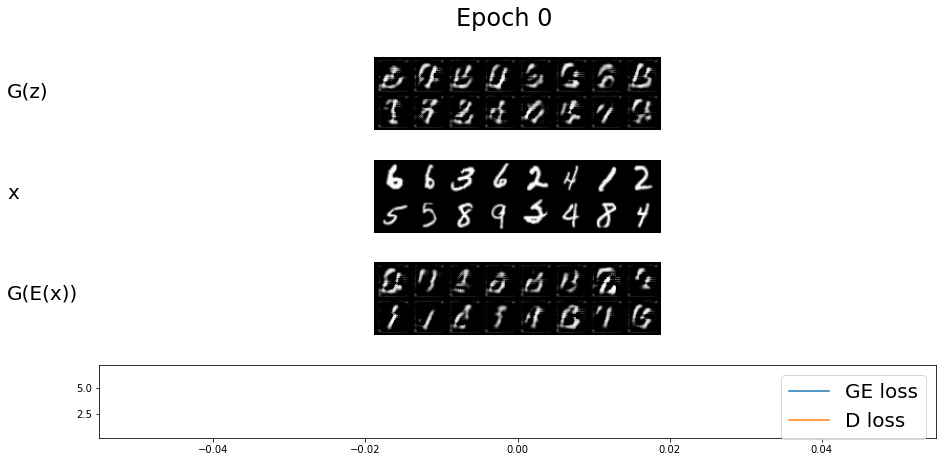

  0%|          | 0/469 [00:00<?, ?it/s]


Training... Epoch: 0, Discrimiantor Loss: 0.546, Generator Loss: 6.926


100%|██████████| 469/469 [00:58<00:00,  8.02it/s]


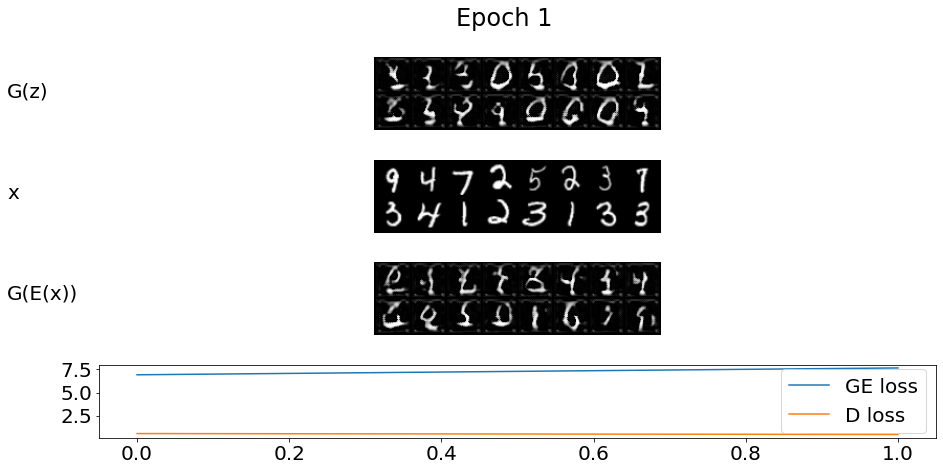

  0%|          | 0/469 [00:00<?, ?it/s]


Training... Epoch: 1, Discrimiantor Loss: 0.447, Generator Loss: 7.668


100%|██████████| 469/469 [00:59<00:00,  7.83it/s]


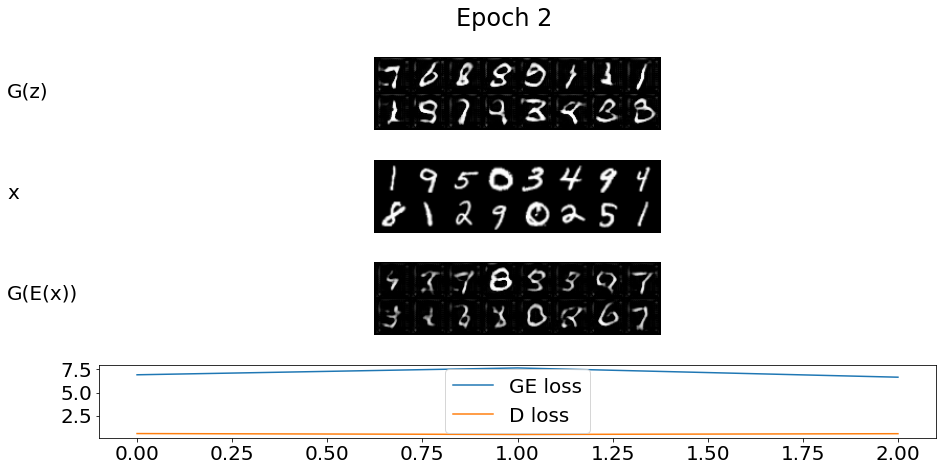

  0%|          | 0/469 [00:00<?, ?it/s]


Training... Epoch: 2, Discrimiantor Loss: 0.531, Generator Loss: 6.664


100%|██████████| 469/469 [00:59<00:00,  7.84it/s]


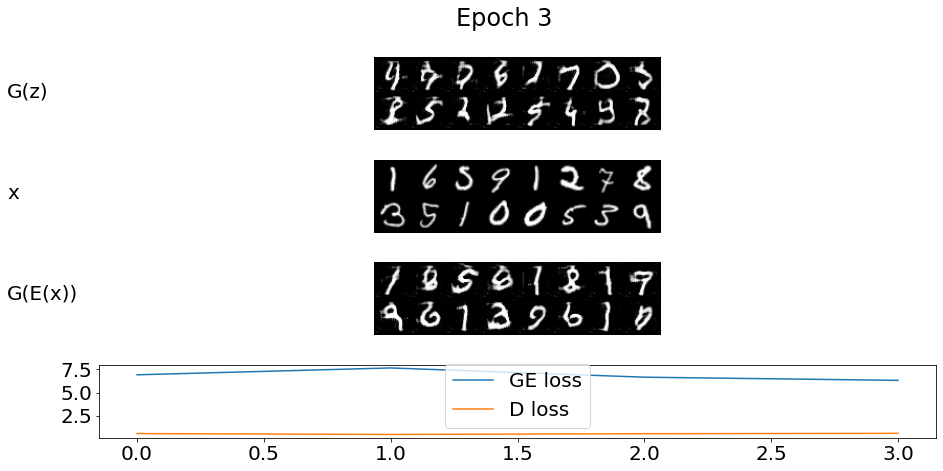

  0%|          | 0/469 [00:00<?, ?it/s]


Training... Epoch: 3, Discrimiantor Loss: 0.569, Generator Loss: 6.319


100%|██████████| 469/469 [00:59<00:00,  7.85it/s]


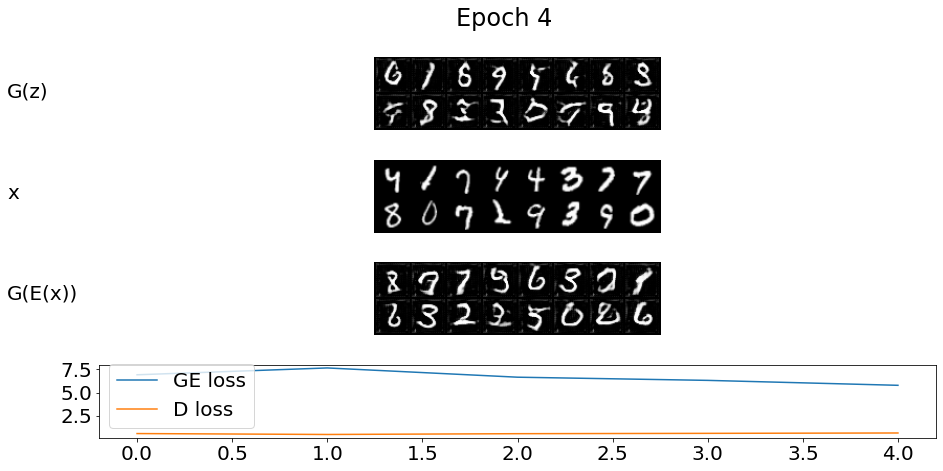

  0%|          | 1/469 [00:00<00:47,  9.86it/s]


Training... Epoch: 4, Discrimiantor Loss: 0.608, Generator Loss: 5.783


100%|██████████| 469/469 [00:59<00:00,  7.84it/s]


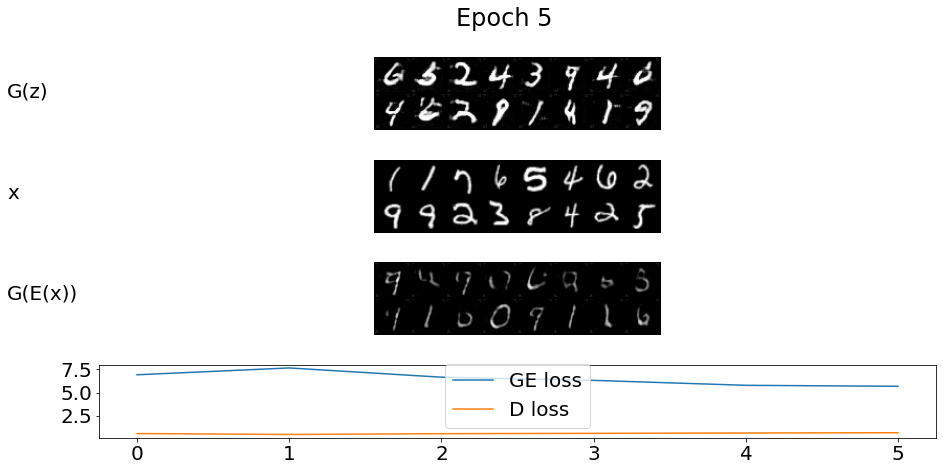

  0%|          | 0/469 [00:00<?, ?it/s]


Training... Epoch: 5, Discrimiantor Loss: 0.634, Generator Loss: 5.676


100%|██████████| 469/469 [00:59<00:00,  7.84it/s]


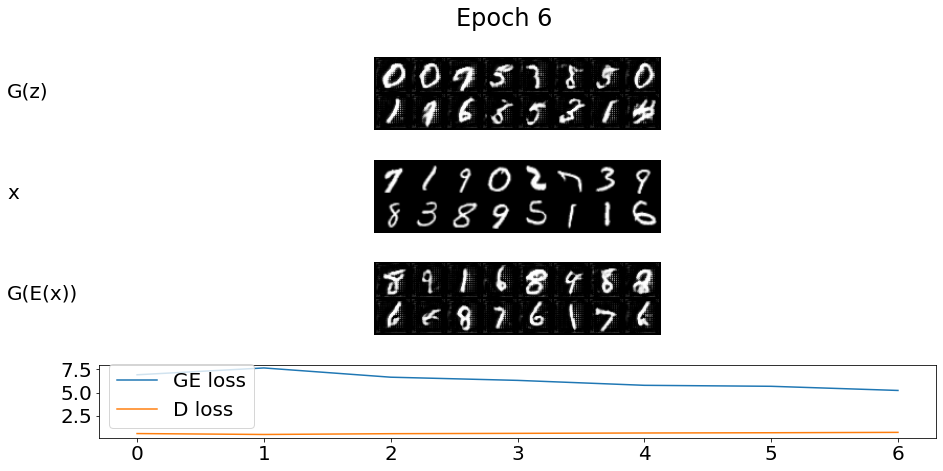

  0%|          | 0/469 [00:00<?, ?it/s]


Training... Epoch: 6, Discrimiantor Loss: 0.676, Generator Loss: 5.225


100%|██████████| 469/469 [00:59<00:00,  7.85it/s]


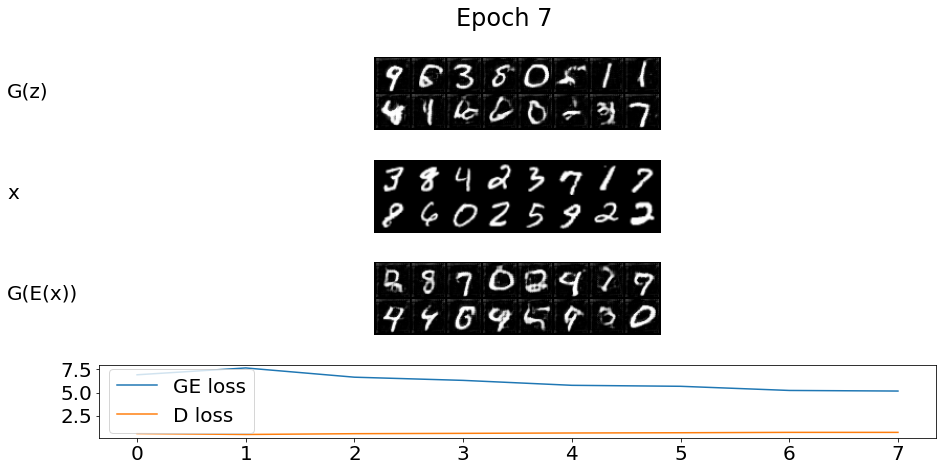

  0%|          | 1/469 [00:00<00:47,  9.89it/s]


Training... Epoch: 7, Discrimiantor Loss: 0.675, Generator Loss: 5.160


100%|██████████| 469/469 [00:59<00:00,  7.84it/s]


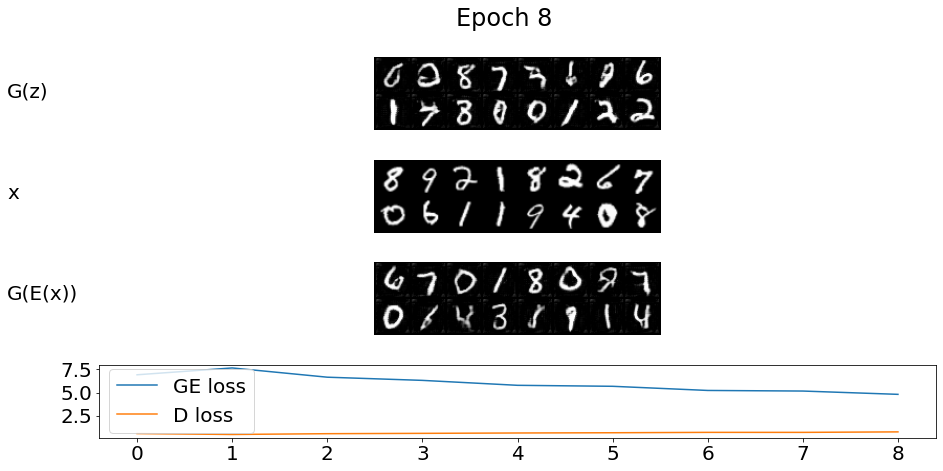

  0%|          | 1/469 [00:00<00:48,  9.63it/s]


Training... Epoch: 8, Discrimiantor Loss: 0.728, Generator Loss: 4.802


100%|██████████| 469/469 [00:59<00:00,  7.82it/s]


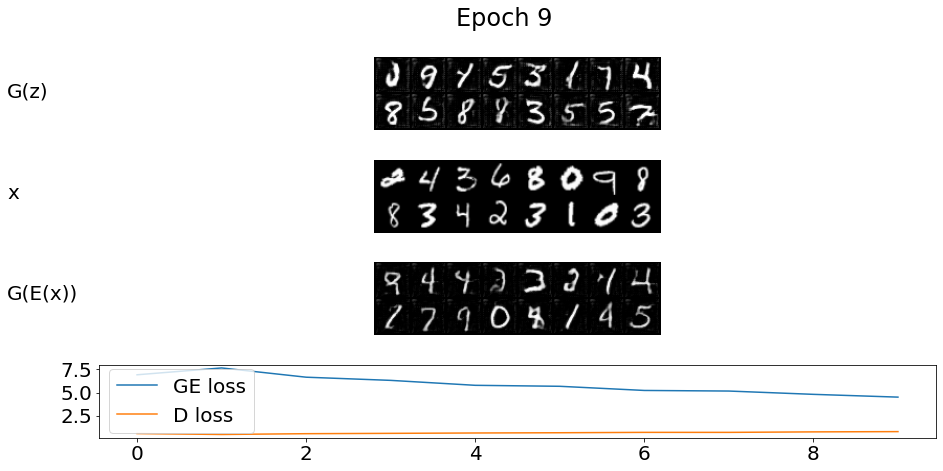

  0%|          | 1/469 [00:00<00:51,  9.14it/s]


Training... Epoch: 9, Discrimiantor Loss: 0.756, Generator Loss: 4.501


100%|██████████| 469/469 [00:59<00:00,  7.83it/s]


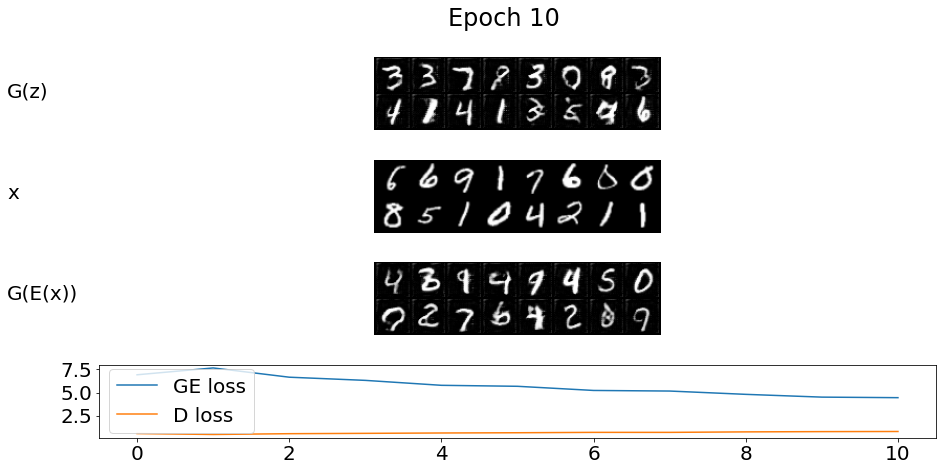

  0%|          | 1/469 [00:00<00:47,  9.84it/s]


Training... Epoch: 10, Discrimiantor Loss: 0.771, Generator Loss: 4.442


100%|██████████| 469/469 [00:59<00:00,  7.83it/s]


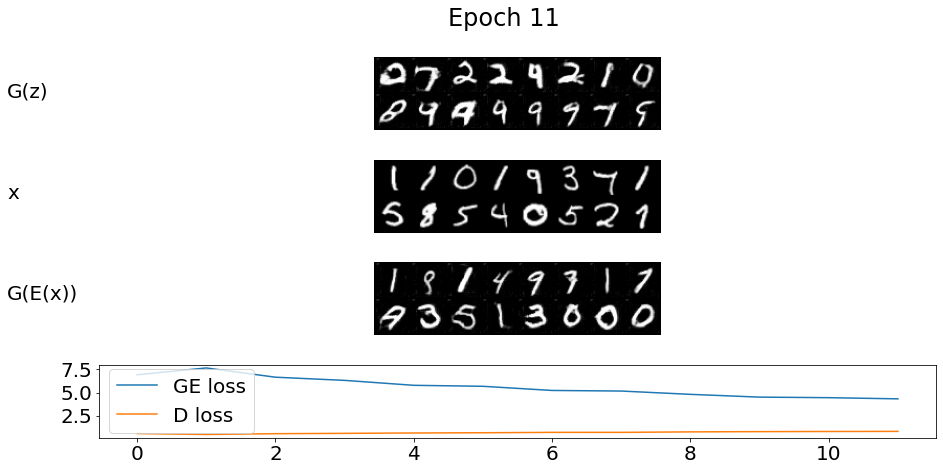

  0%|          | 1/469 [00:00<00:46,  9.96it/s]


Training... Epoch: 11, Discrimiantor Loss: 0.782, Generator Loss: 4.314


100%|██████████| 469/469 [00:59<00:00,  7.83it/s]


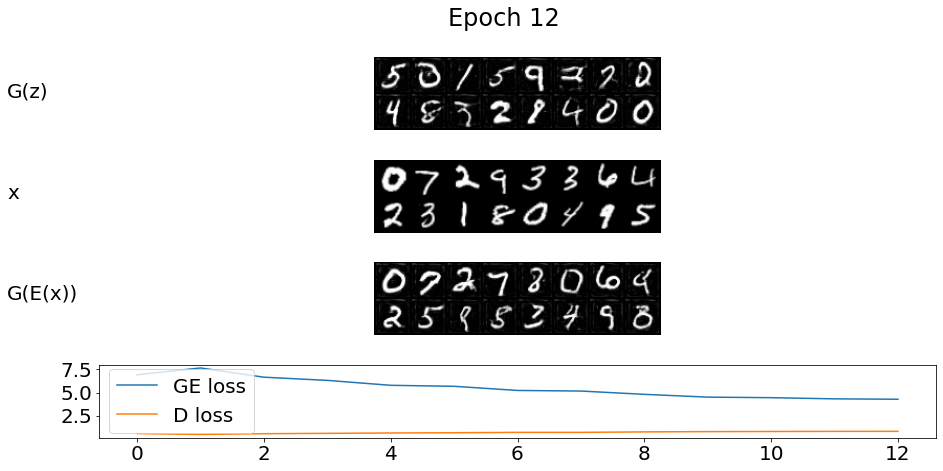

  0%|          | 1/469 [00:00<00:50,  9.23it/s]


Training... Epoch: 12, Discrimiantor Loss: 0.787, Generator Loss: 4.270


100%|██████████| 469/469 [00:59<00:00,  7.83it/s]


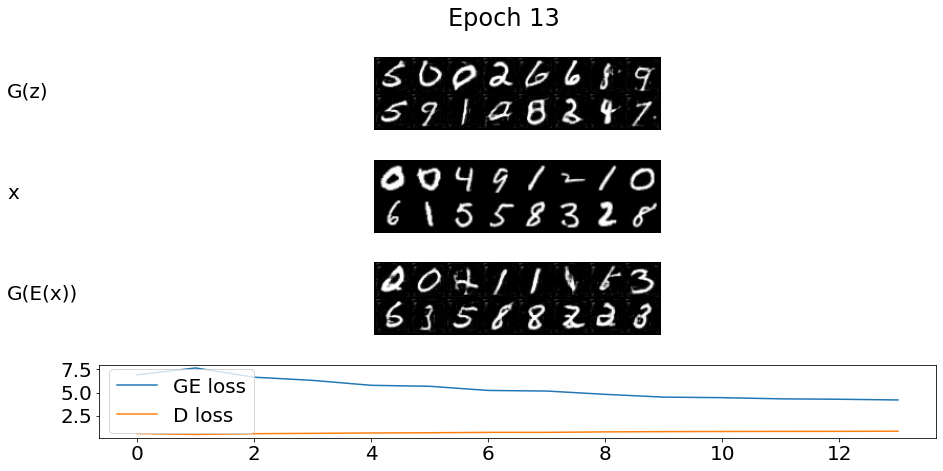

  0%|          | 1/469 [00:00<00:48,  9.56it/s]


Training... Epoch: 13, Discrimiantor Loss: 0.802, Generator Loss: 4.194


100%|██████████| 469/469 [00:59<00:00,  7.83it/s]


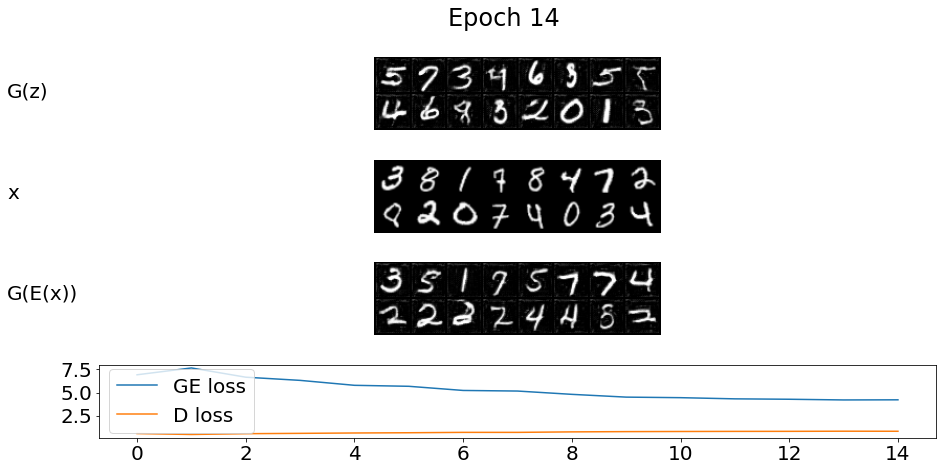

  0%|          | 1/469 [00:00<00:48,  9.72it/s]


Training... Epoch: 14, Discrimiantor Loss: 0.795, Generator Loss: 4.208


100%|██████████| 469/469 [00:59<00:00,  7.82it/s]


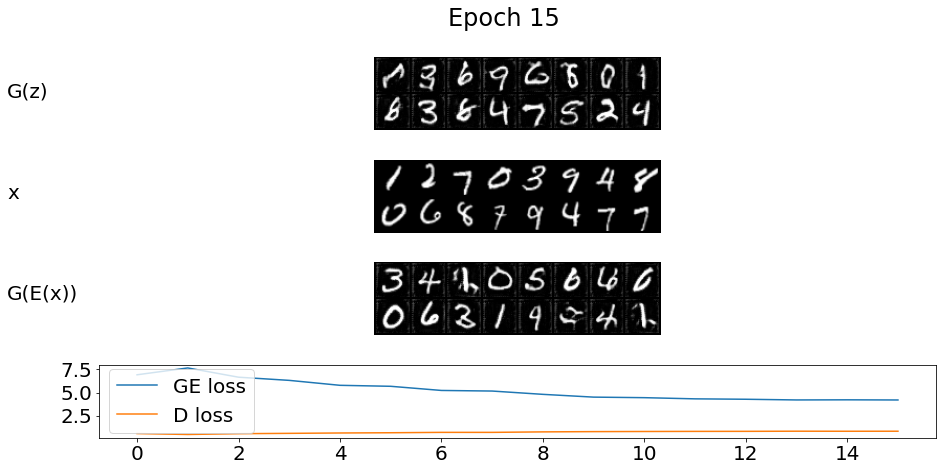

  0%|          | 1/469 [00:00<00:47,  9.83it/s]


Training... Epoch: 15, Discrimiantor Loss: 0.800, Generator Loss: 4.191


100%|██████████| 469/469 [00:59<00:00,  7.82it/s]


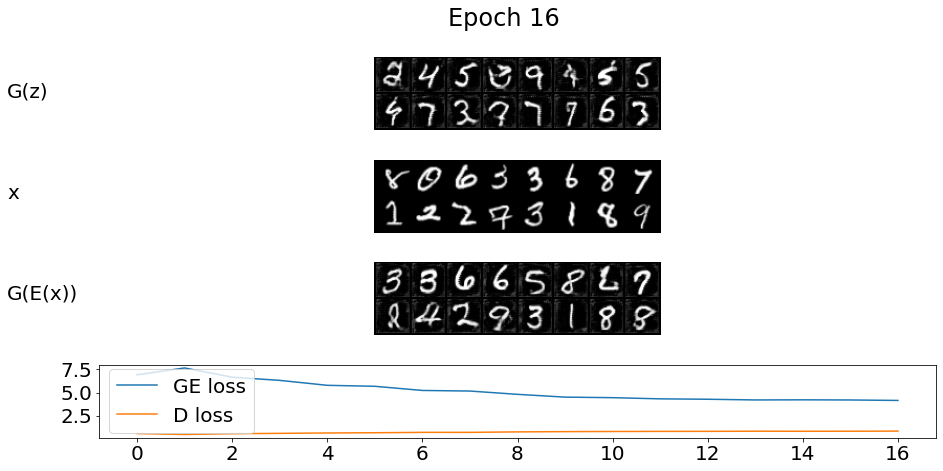

  0%|          | 1/469 [00:00<00:47,  9.77it/s]


Training... Epoch: 16, Discrimiantor Loss: 0.810, Generator Loss: 4.142


100%|██████████| 469/469 [00:59<00:00,  7.83it/s]


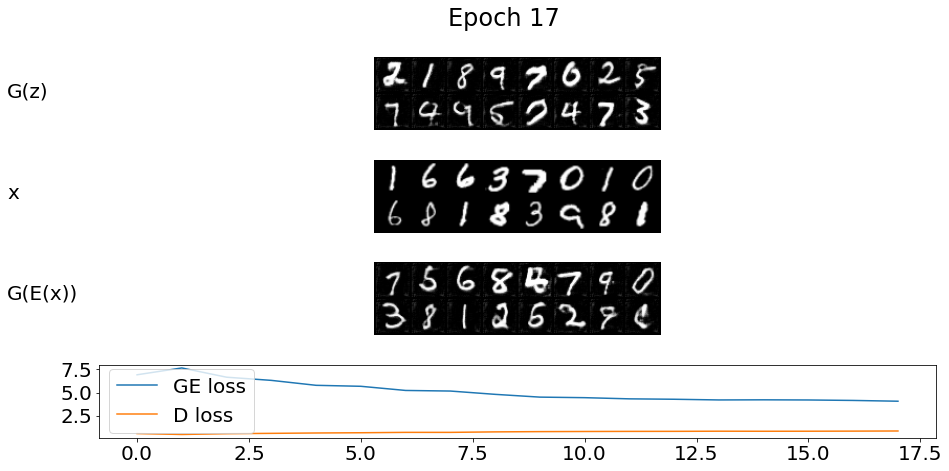

  0%|          | 1/469 [00:00<00:48,  9.58it/s]


Training... Epoch: 17, Discrimiantor Loss: 0.825, Generator Loss: 4.056


100%|██████████| 469/469 [00:59<00:00,  7.82it/s]


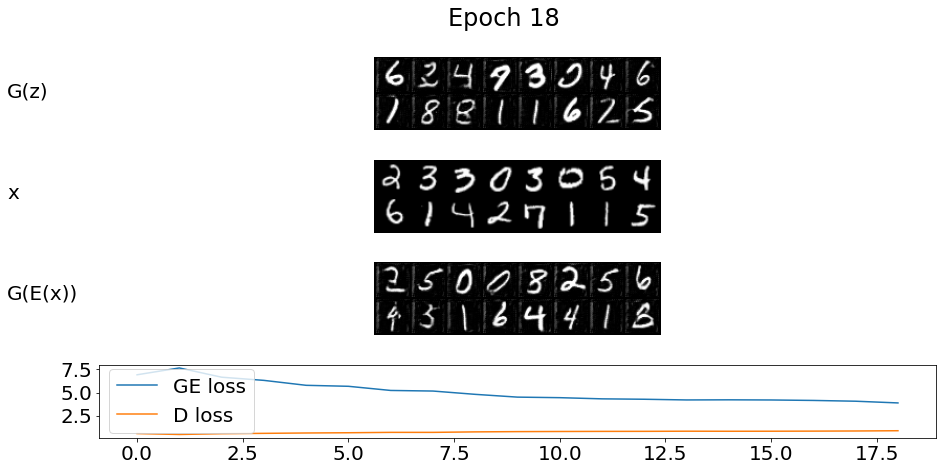

  0%|          | 1/469 [00:00<00:50,  9.22it/s]


Training... Epoch: 18, Discrimiantor Loss: 0.853, Generator Loss: 3.871


100%|██████████| 469/469 [00:59<00:00,  7.82it/s]


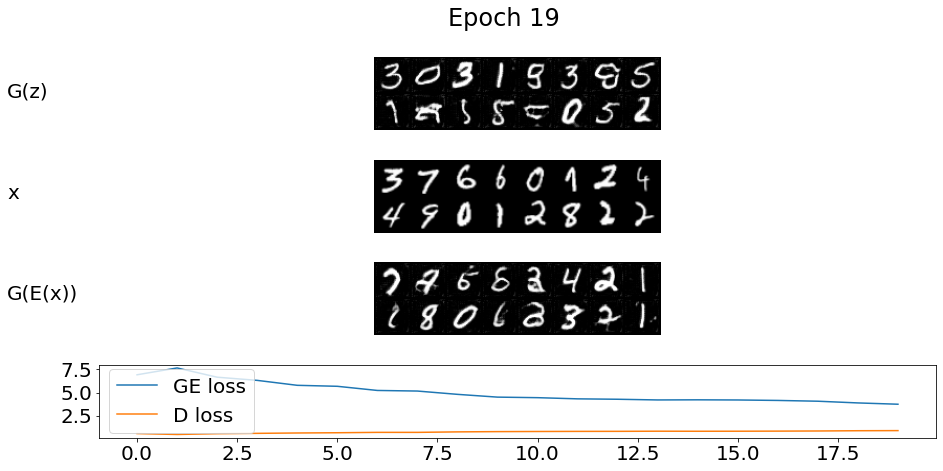

  0%|          | 1/469 [00:00<00:49,  9.48it/s]


Training... Epoch: 19, Discrimiantor Loss: 0.866, Generator Loss: 3.730


100%|██████████| 469/469 [01:00<00:00,  7.81it/s]


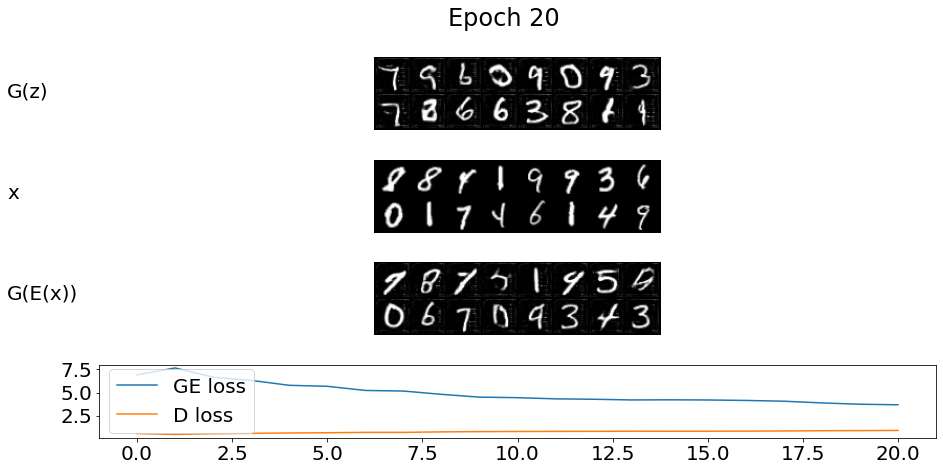

  0%|          | 1/469 [00:00<00:47,  9.78it/s]


Training... Epoch: 20, Discrimiantor Loss: 0.885, Generator Loss: 3.669


100%|██████████| 469/469 [01:00<00:00,  7.82it/s]


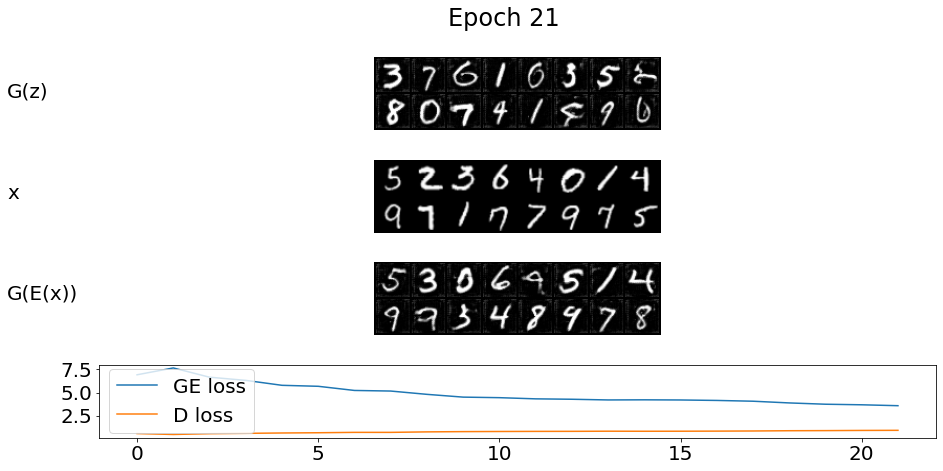

  0%|          | 1/469 [00:00<00:47,  9.80it/s]


Training... Epoch: 21, Discrimiantor Loss: 0.897, Generator Loss: 3.570


100%|██████████| 469/469 [00:59<00:00,  7.82it/s]


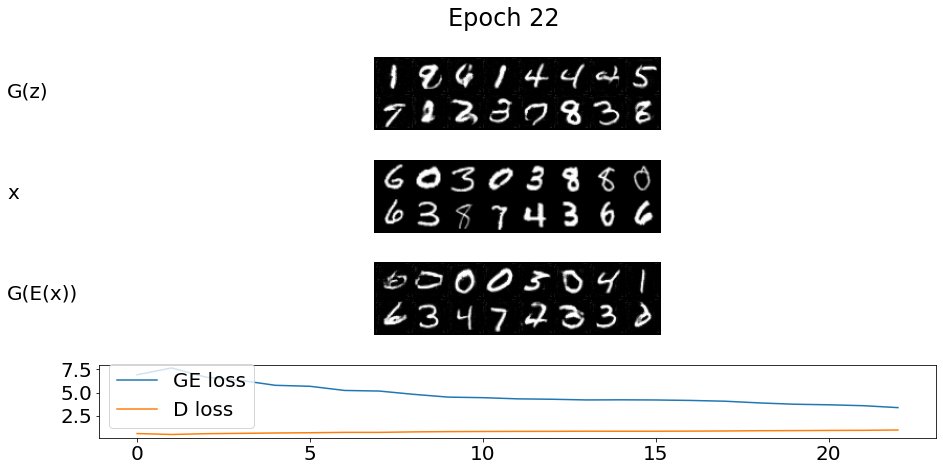

  0%|          | 1/469 [00:00<00:51,  9.02it/s]


Training... Epoch: 22, Discrimiantor Loss: 0.934, Generator Loss: 3.361


100%|██████████| 469/469 [01:00<00:00,  7.82it/s]


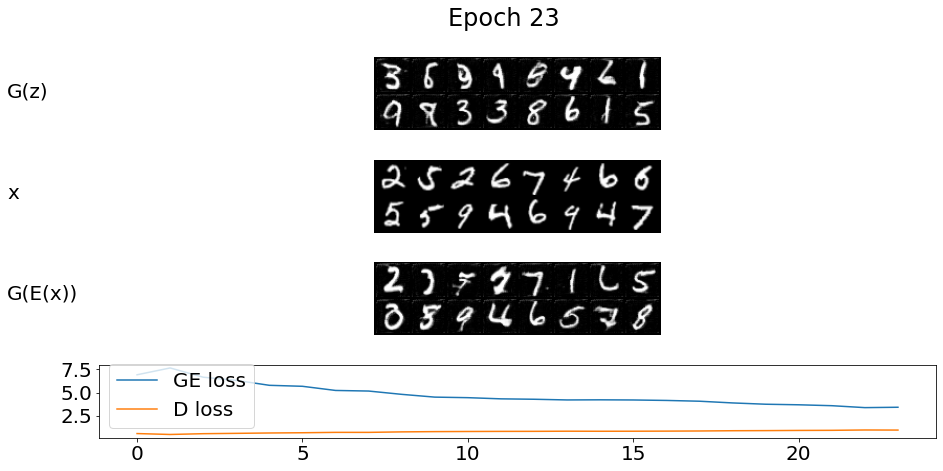

  0%|          | 1/469 [00:00<00:49,  9.49it/s]


Training... Epoch: 23, Discrimiantor Loss: 0.924, Generator Loss: 3.401


100%|██████████| 469/469 [01:00<00:00,  7.81it/s]


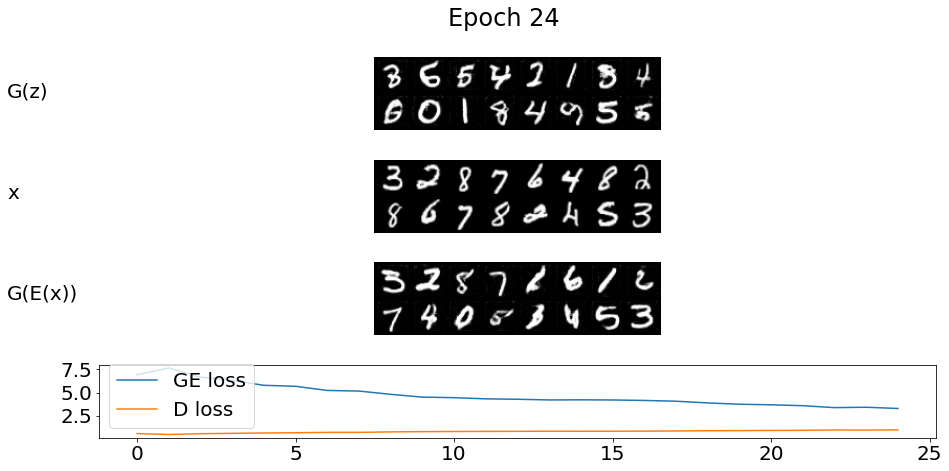

  0%|          | 1/469 [00:00<00:48,  9.75it/s]


Training... Epoch: 24, Discrimiantor Loss: 0.947, Generator Loss: 3.268


100%|██████████| 469/469 [01:00<00:00,  7.81it/s]


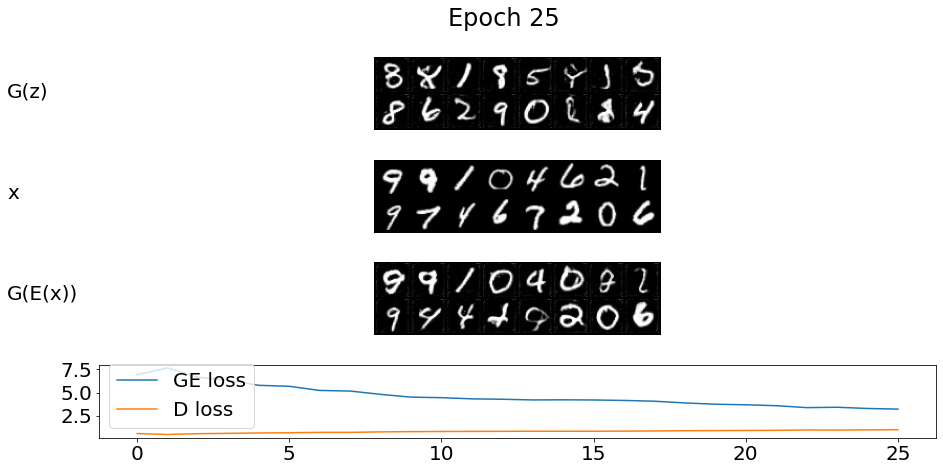

  0%|          | 1/469 [00:00<00:49,  9.53it/s]


Training... Epoch: 25, Discrimiantor Loss: 0.962, Generator Loss: 3.200


100%|██████████| 469/469 [01:00<00:00,  7.79it/s]


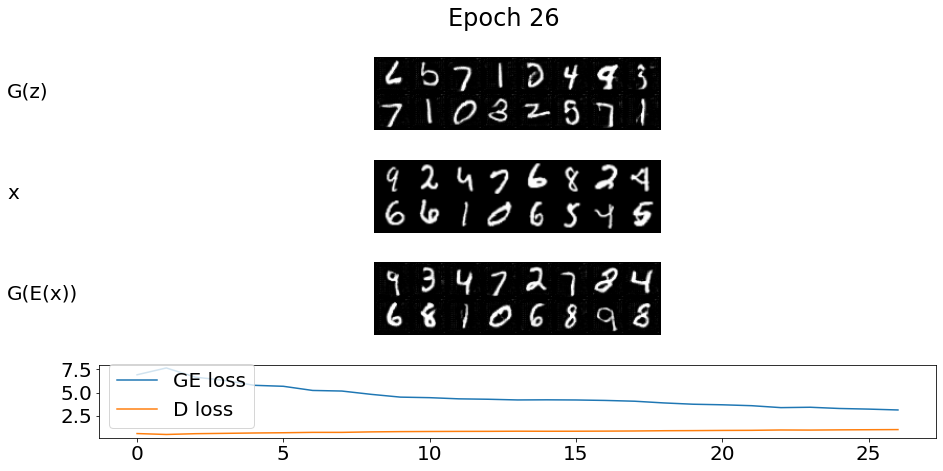

  0%|          | 1/469 [00:00<00:46,  9.97it/s]


Training... Epoch: 26, Discrimiantor Loss: 0.977, Generator Loss: 3.107


100%|██████████| 469/469 [01:00<00:00,  7.79it/s]


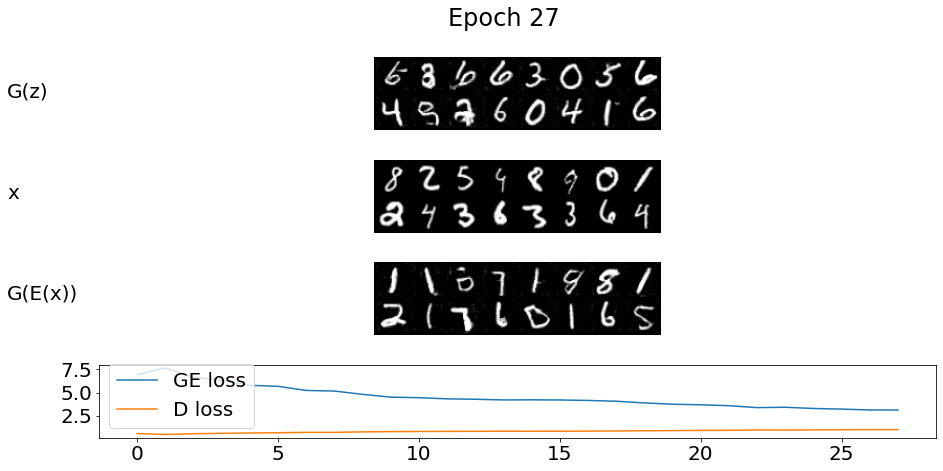

  0%|          | 1/469 [00:00<00:48,  9.61it/s]


Training... Epoch: 27, Discrimiantor Loss: 0.976, Generator Loss: 3.103


100%|██████████| 469/469 [01:00<00:00,  7.78it/s]


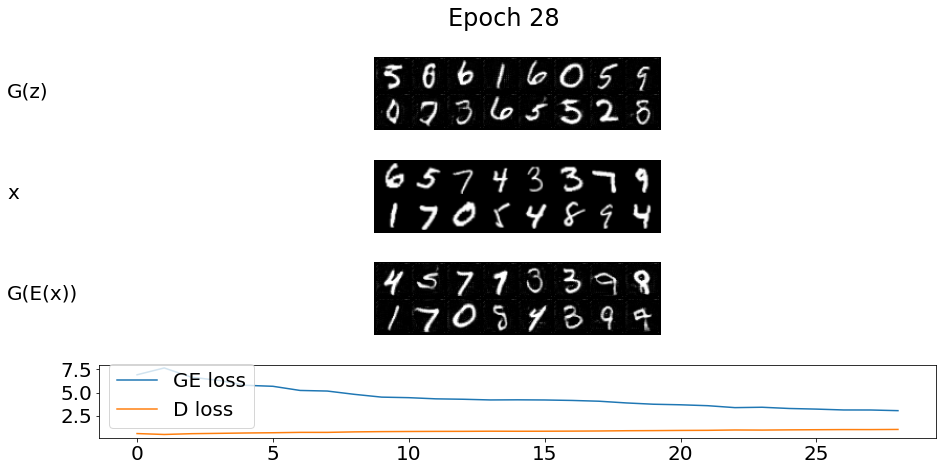

  0%|          | 1/469 [00:00<00:48,  9.64it/s]


Training... Epoch: 28, Discrimiantor Loss: 0.993, Generator Loss: 3.032


100%|██████████| 469/469 [01:00<00:00,  7.78it/s]


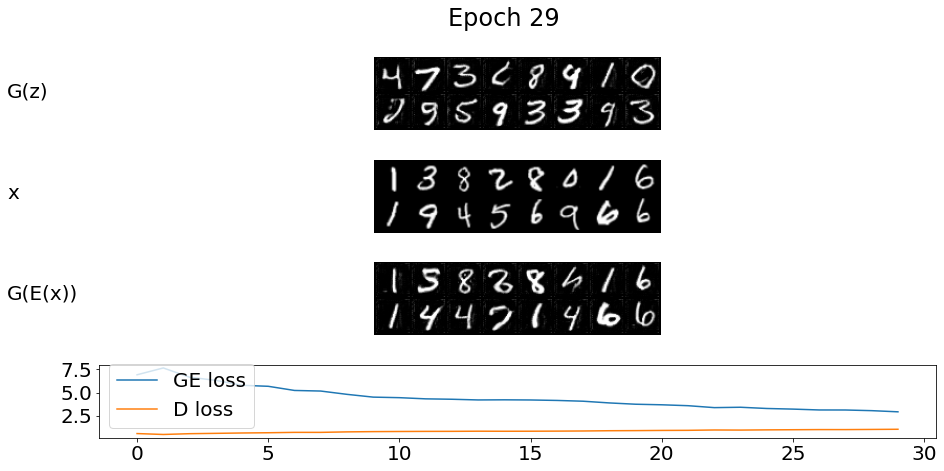

  0%|          | 1/469 [00:00<00:47,  9.88it/s]


Training... Epoch: 29, Discrimiantor Loss: 1.012, Generator Loss: 2.906


100%|██████████| 469/469 [01:00<00:00,  7.77it/s]


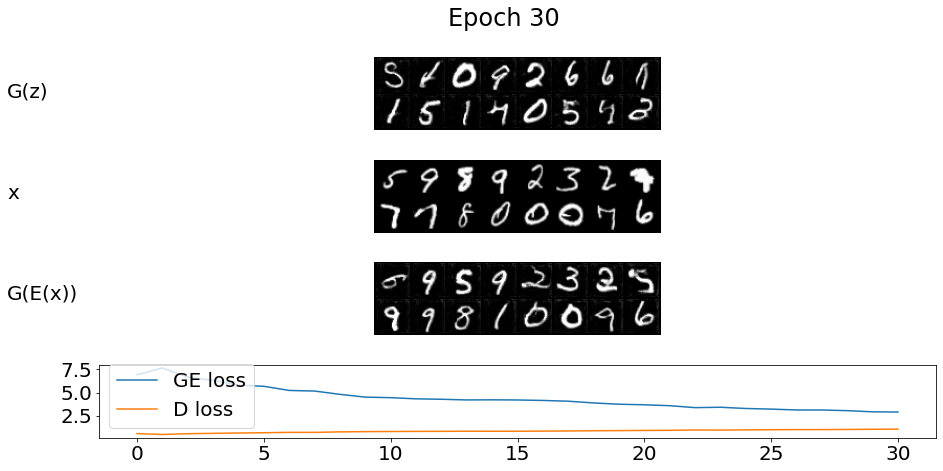

  0%|          | 1/469 [00:00<00:48,  9.65it/s]


Training... Epoch: 30, Discrimiantor Loss: 1.023, Generator Loss: 2.883


100%|██████████| 469/469 [01:00<00:00,  7.79it/s]


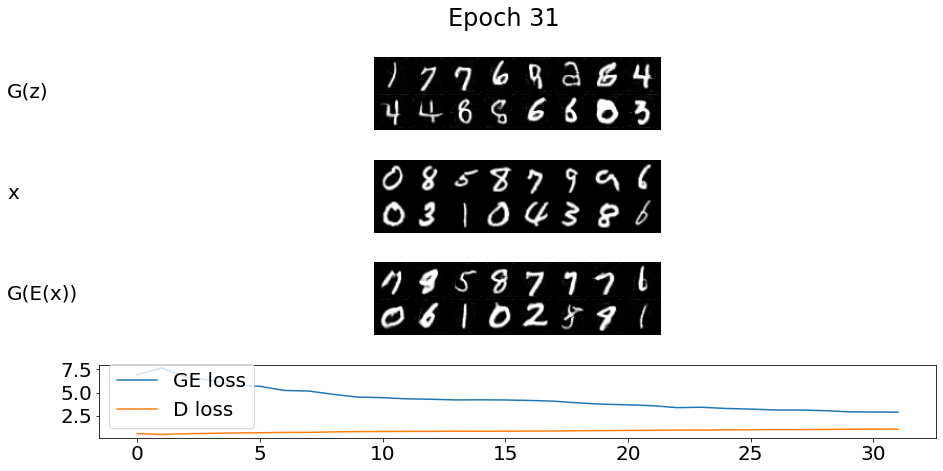

  0%|          | 1/469 [00:00<00:48,  9.56it/s]


Training... Epoch: 31, Discrimiantor Loss: 1.022, Generator Loss: 2.872


100%|██████████| 469/469 [01:00<00:00,  7.78it/s]


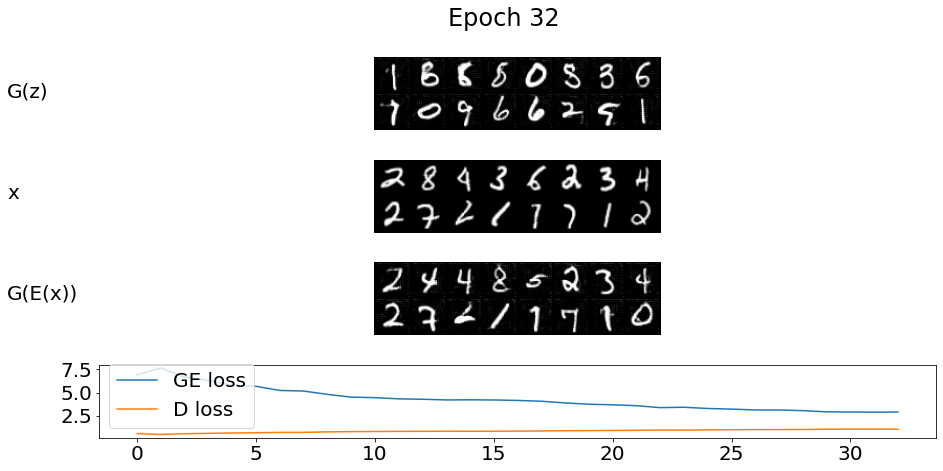

  0%|          | 1/469 [00:00<00:49,  9.40it/s]


Training... Epoch: 32, Discrimiantor Loss: 1.024, Generator Loss: 2.879


100%|██████████| 469/469 [01:00<00:00,  7.78it/s]


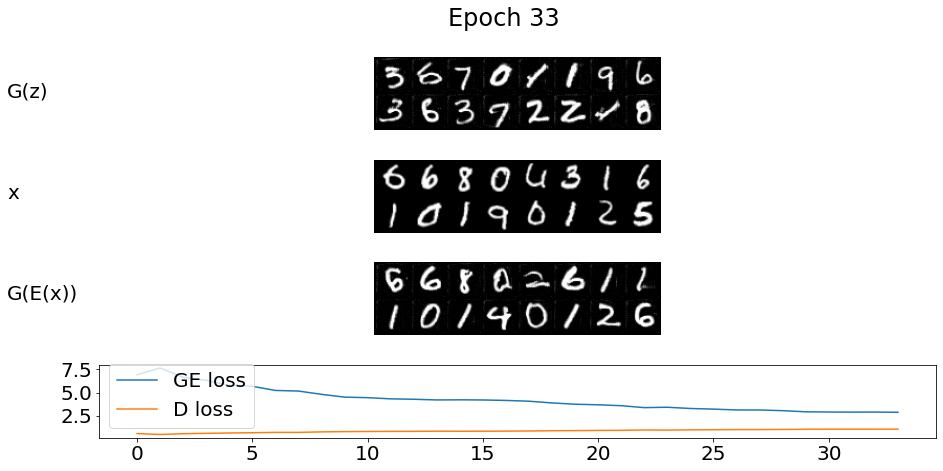

  0%|          | 1/469 [00:00<00:47,  9.96it/s]


Training... Epoch: 33, Discrimiantor Loss: 1.024, Generator Loss: 2.855


100%|██████████| 469/469 [01:00<00:00,  7.78it/s]


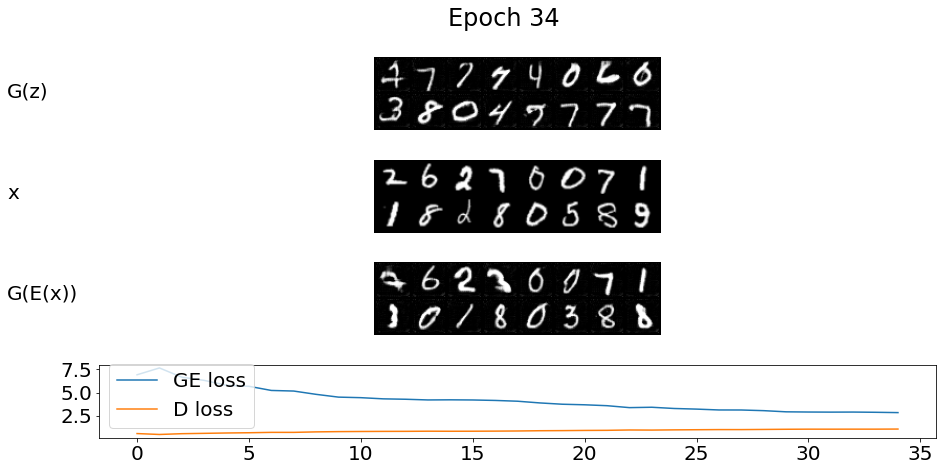

  0%|          | 1/469 [00:00<00:48,  9.58it/s]


Training... Epoch: 34, Discrimiantor Loss: 1.035, Generator Loss: 2.820


100%|██████████| 469/469 [01:00<00:00,  7.81it/s]


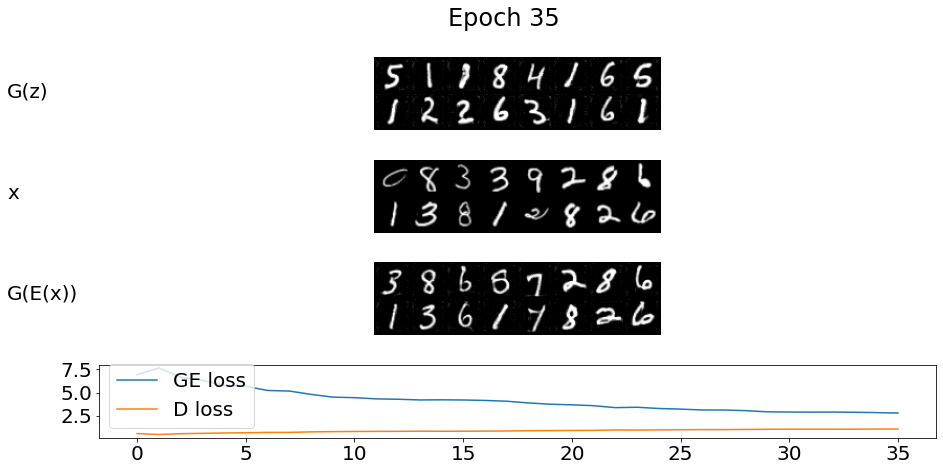

  0%|          | 1/469 [00:00<00:49,  9.44it/s]


Training... Epoch: 35, Discrimiantor Loss: 1.040, Generator Loss: 2.773


100%|██████████| 469/469 [01:00<00:00,  7.79it/s]


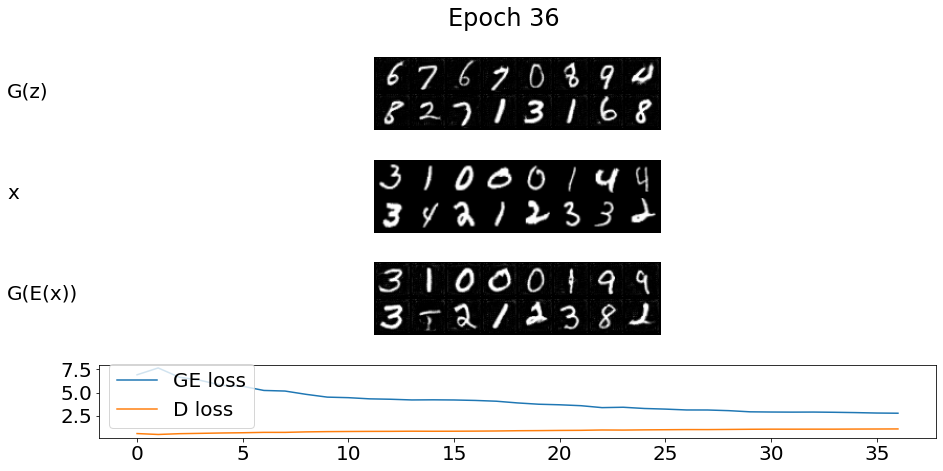

  0%|          | 1/469 [00:00<00:47,  9.93it/s]


Training... Epoch: 36, Discrimiantor Loss: 1.048, Generator Loss: 2.753


100%|██████████| 469/469 [01:00<00:00,  7.80it/s]


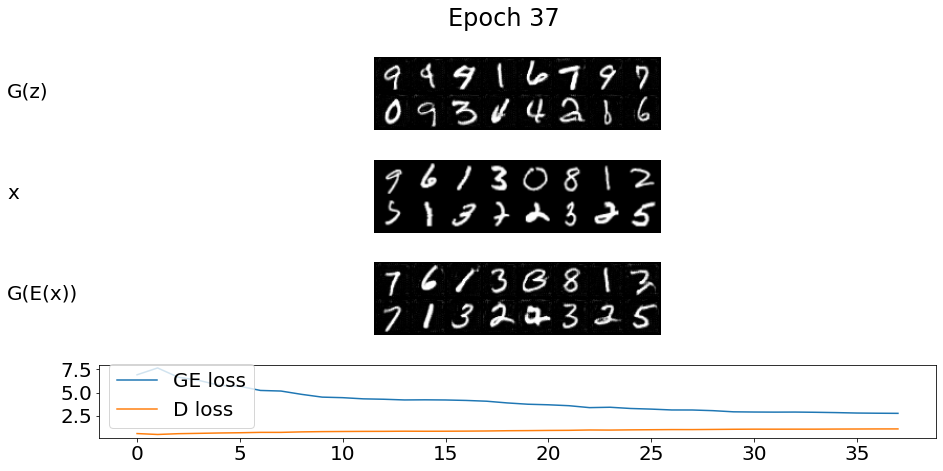

  0%|          | 1/469 [00:00<00:48,  9.60it/s]


Training... Epoch: 37, Discrimiantor Loss: 1.049, Generator Loss: 2.740


100%|██████████| 469/469 [01:00<00:00,  7.79it/s]


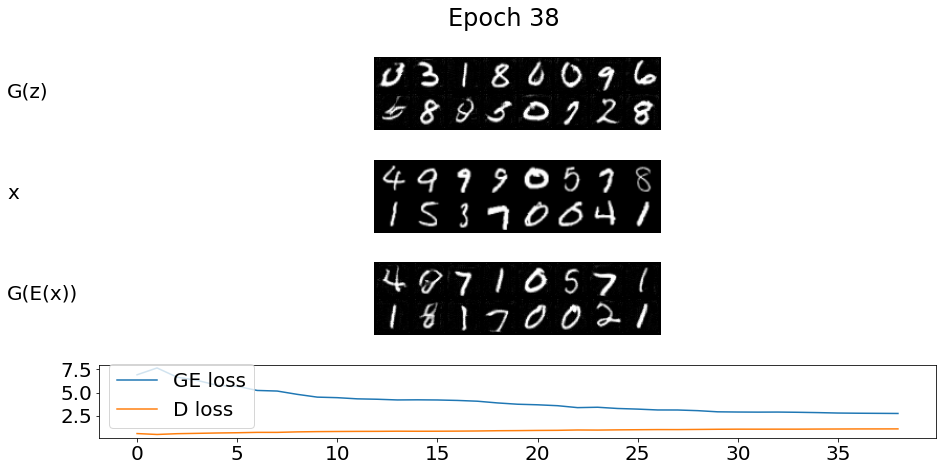

  0%|          | 1/469 [00:00<00:48,  9.68it/s]


Training... Epoch: 38, Discrimiantor Loss: 1.052, Generator Loss: 2.727


100%|██████████| 469/469 [01:00<00:00,  7.78it/s]


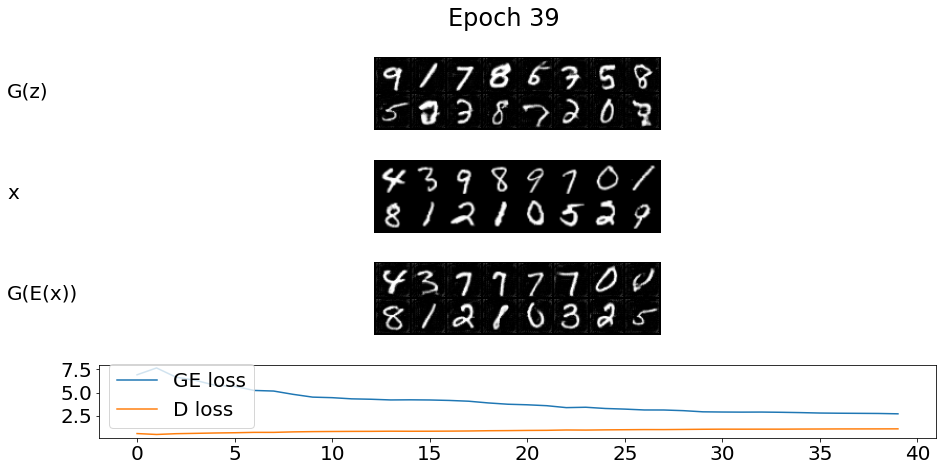

  0%|          | 1/469 [00:00<00:50,  9.34it/s]


Training... Epoch: 39, Discrimiantor Loss: 1.057, Generator Loss: 2.689


100%|██████████| 469/469 [01:00<00:00,  7.78it/s]


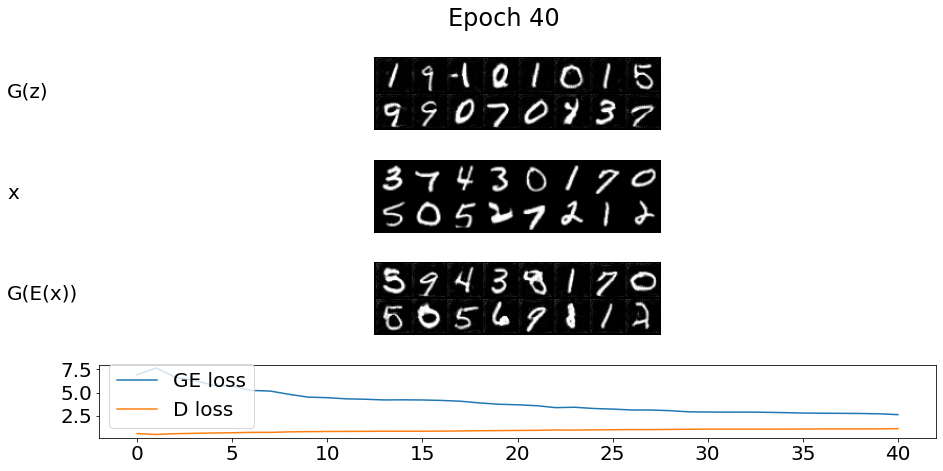

  0%|          | 1/469 [00:00<00:48,  9.59it/s]


Training... Epoch: 40, Discrimiantor Loss: 1.078, Generator Loss: 2.598


100%|██████████| 469/469 [01:00<00:00,  7.79it/s]


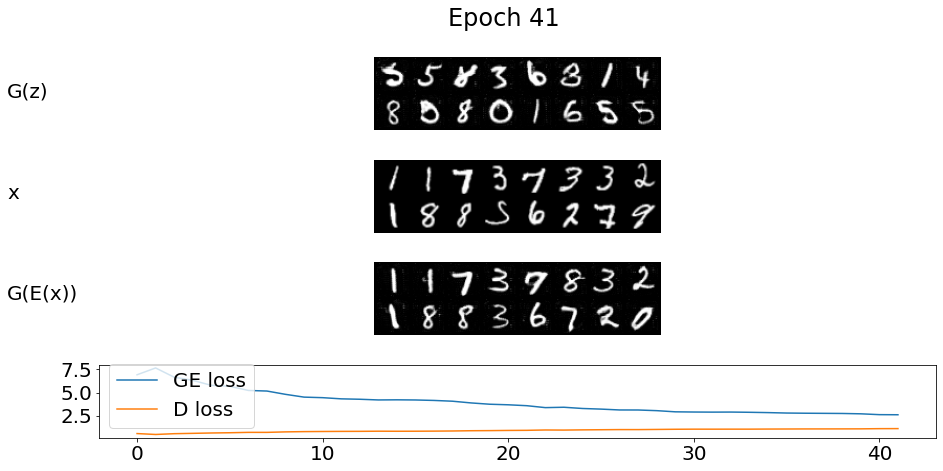

  0%|          | 1/469 [00:00<00:48,  9.64it/s]


Training... Epoch: 41, Discrimiantor Loss: 1.083, Generator Loss: 2.587


100%|██████████| 469/469 [01:00<00:00,  7.79it/s]


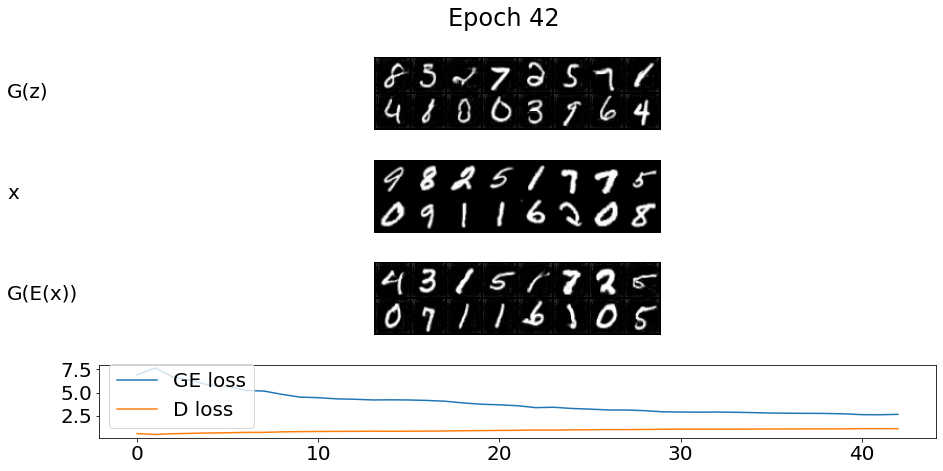

  0%|          | 1/469 [00:00<00:47,  9.80it/s]


Training... Epoch: 42, Discrimiantor Loss: 1.072, Generator Loss: 2.630


100%|██████████| 469/469 [01:00<00:00,  7.79it/s]


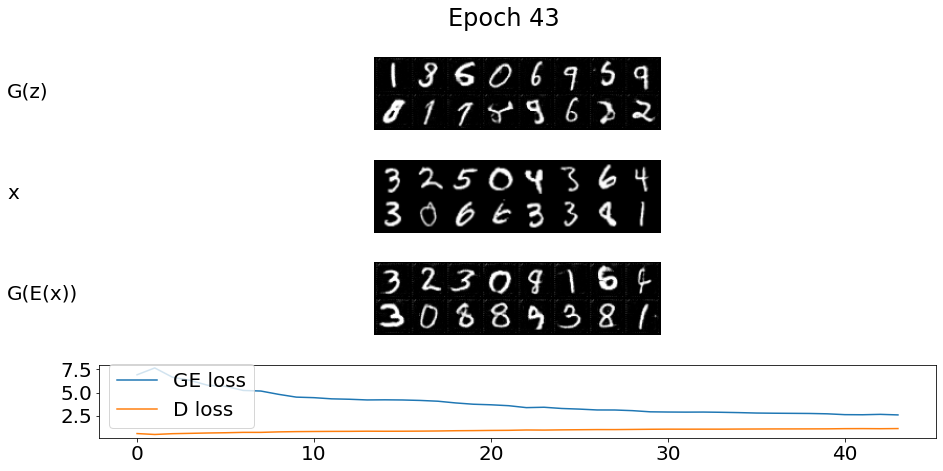

  0%|          | 1/469 [00:00<00:49,  9.48it/s]


Training... Epoch: 43, Discrimiantor Loss: 1.088, Generator Loss: 2.570


100%|██████████| 469/469 [01:00<00:00,  7.78it/s]


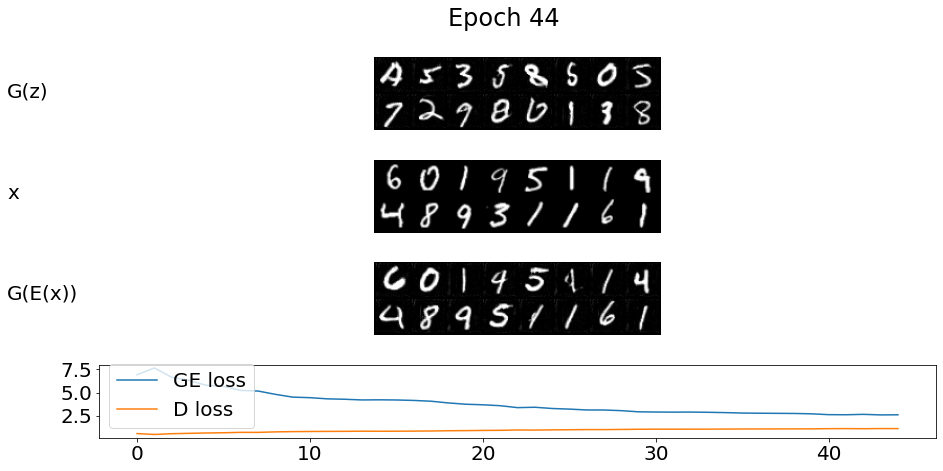

  0%|          | 1/469 [00:00<00:49,  9.47it/s]


Training... Epoch: 44, Discrimiantor Loss: 1.084, Generator Loss: 2.583


100%|██████████| 469/469 [01:00<00:00,  7.80it/s]


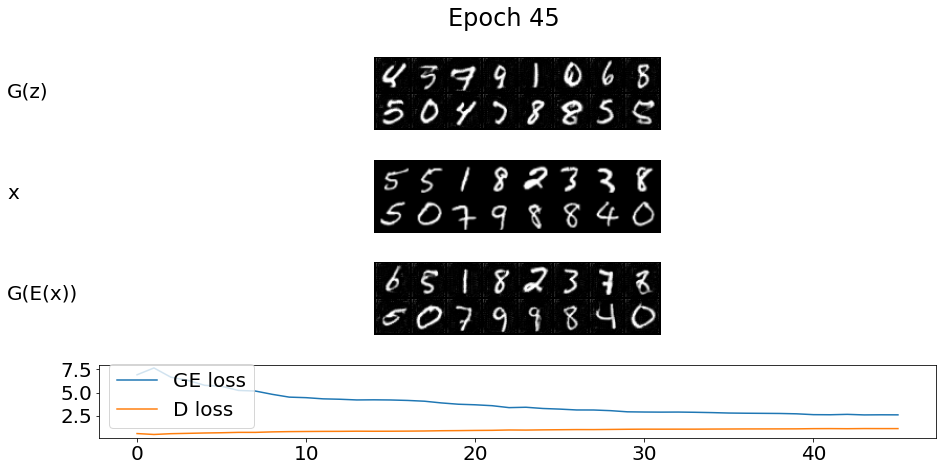

  0%|          | 1/469 [00:00<00:50,  9.24it/s]


Training... Epoch: 45, Discrimiantor Loss: 1.084, Generator Loss: 2.577


100%|██████████| 469/469 [01:00<00:00,  7.78it/s]


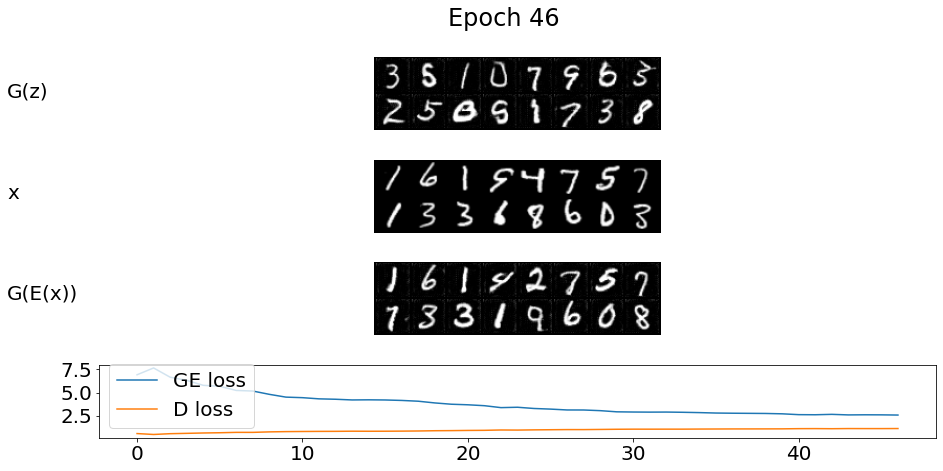

  0%|          | 1/469 [00:00<00:48,  9.58it/s]


Training... Epoch: 46, Discrimiantor Loss: 1.090, Generator Loss: 2.555


100%|██████████| 469/469 [01:00<00:00,  7.81it/s]


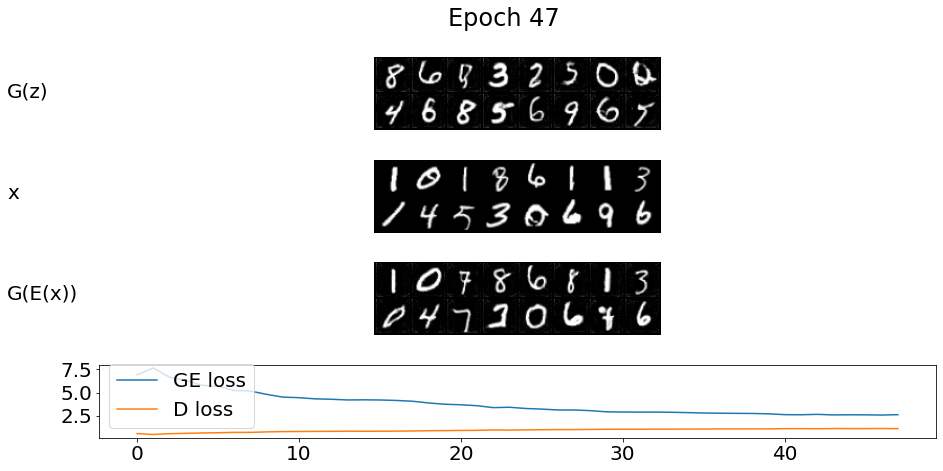

  0%|          | 1/469 [00:00<00:48,  9.57it/s]


Training... Epoch: 47, Discrimiantor Loss: 1.080, Generator Loss: 2.597


100%|██████████| 469/469 [01:00<00:00,  7.80it/s]


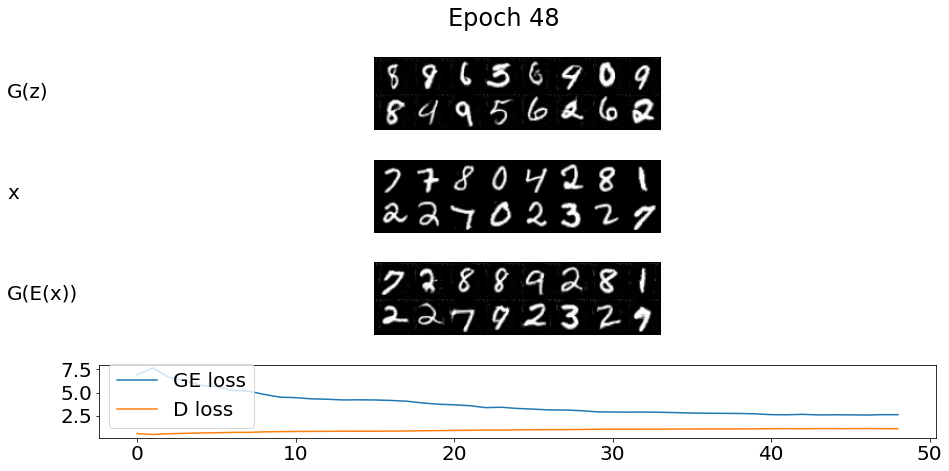

  0%|          | 1/469 [00:00<00:47,  9.84it/s]


Training... Epoch: 48, Discrimiantor Loss: 1.079, Generator Loss: 2.594


100%|██████████| 469/469 [01:00<00:00,  7.79it/s]


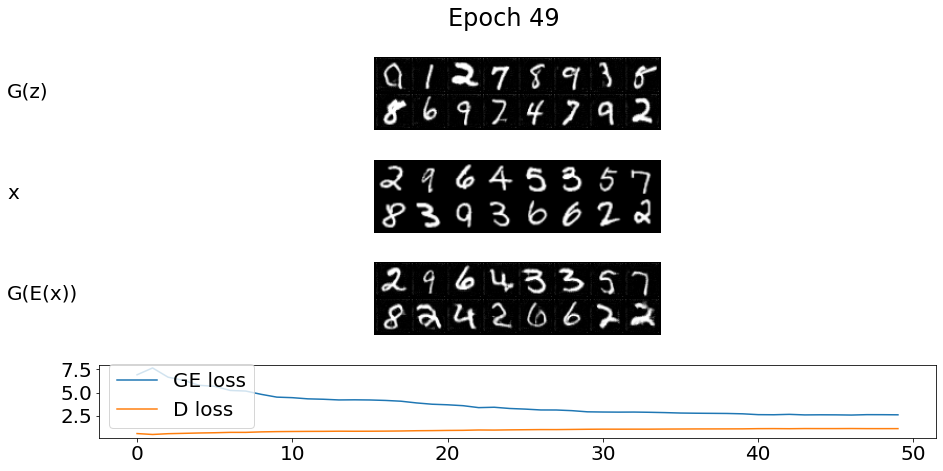

  0%|          | 1/469 [00:00<00:55,  8.43it/s]


Training... Epoch: 49, Discrimiantor Loss: 1.081, Generator Loss: 2.582


100%|██████████| 469/469 [01:00<00:00,  7.79it/s]


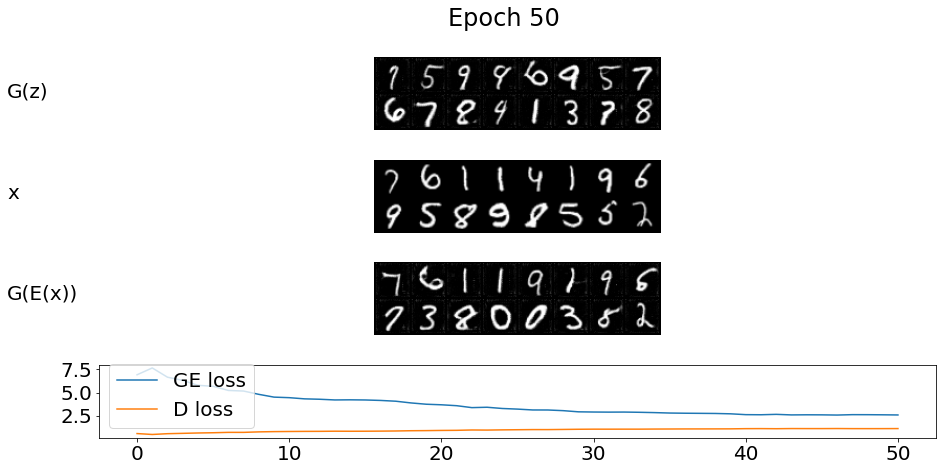

  0%|          | 1/469 [00:00<00:50,  9.25it/s]


Training... Epoch: 50, Discrimiantor Loss: 1.087, Generator Loss: 2.565


100%|██████████| 469/469 [01:00<00:00,  7.80it/s]


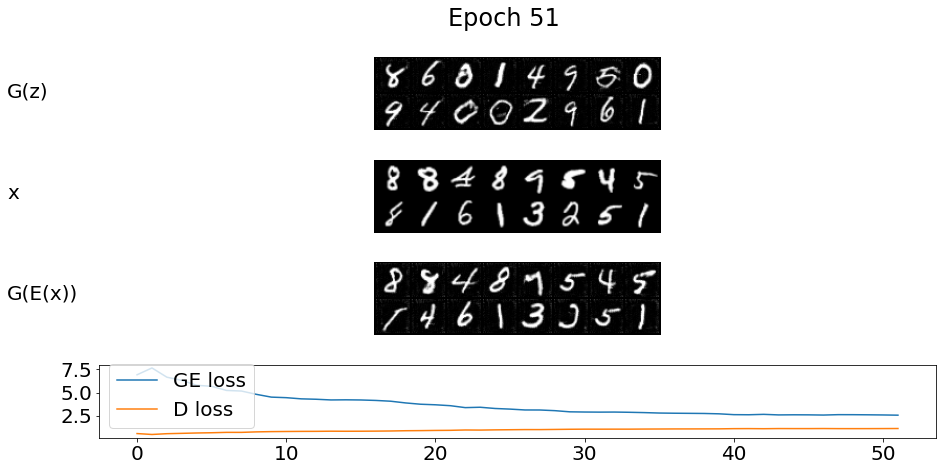

  0%|          | 1/469 [00:00<00:48,  9.72it/s]


Training... Epoch: 51, Discrimiantor Loss: 1.093, Generator Loss: 2.541


100%|██████████| 469/469 [01:00<00:00,  7.79it/s]


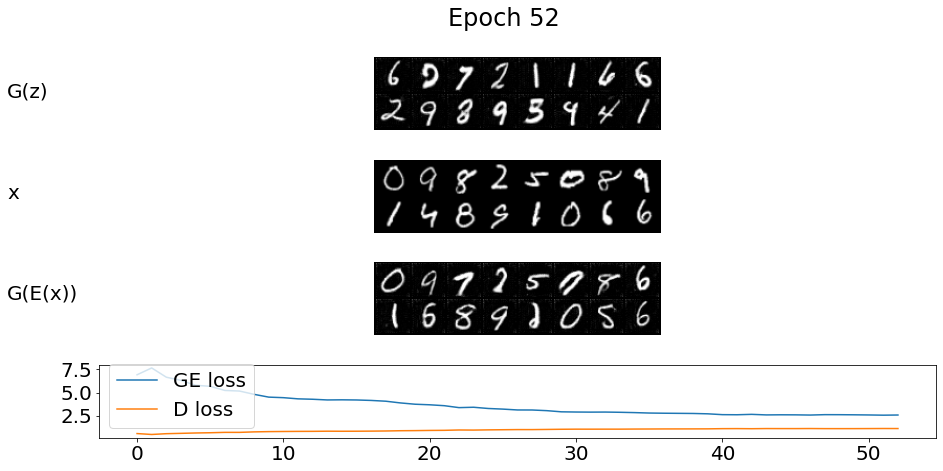

  0%|          | 1/469 [00:00<00:49,  9.43it/s]


Training... Epoch: 52, Discrimiantor Loss: 1.090, Generator Loss: 2.559


100%|██████████| 469/469 [01:00<00:00,  7.78it/s]


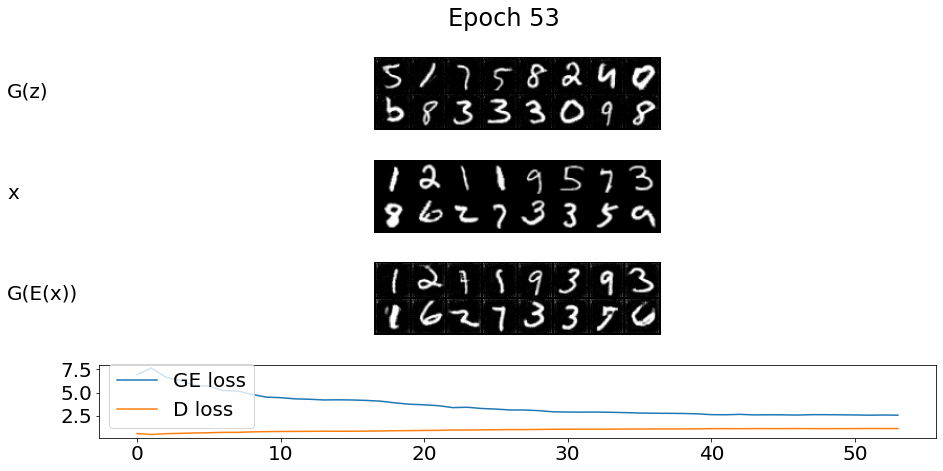

  0%|          | 1/469 [00:00<00:50,  9.35it/s]


Training... Epoch: 53, Discrimiantor Loss: 1.091, Generator Loss: 2.541


100%|██████████| 469/469 [01:00<00:00,  7.79it/s]


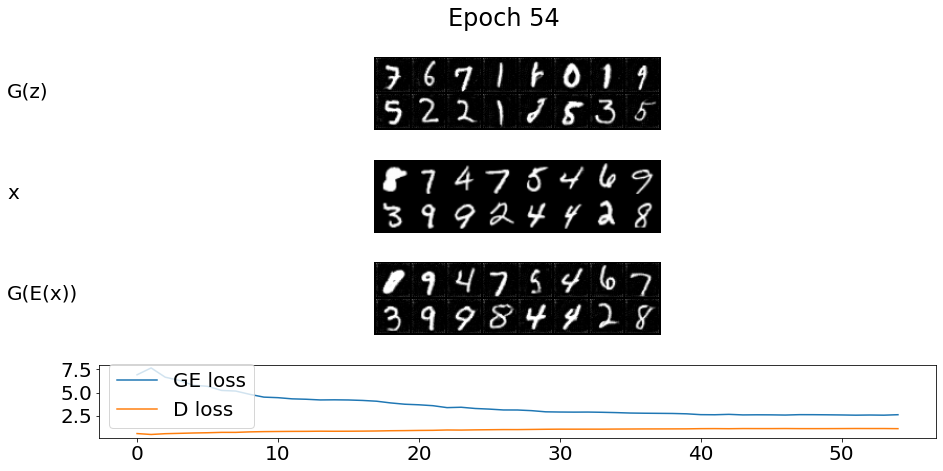

  0%|          | 1/469 [00:00<00:48,  9.69it/s]


Training... Epoch: 54, Discrimiantor Loss: 1.077, Generator Loss: 2.592


100%|██████████| 469/469 [01:00<00:00,  7.77it/s]


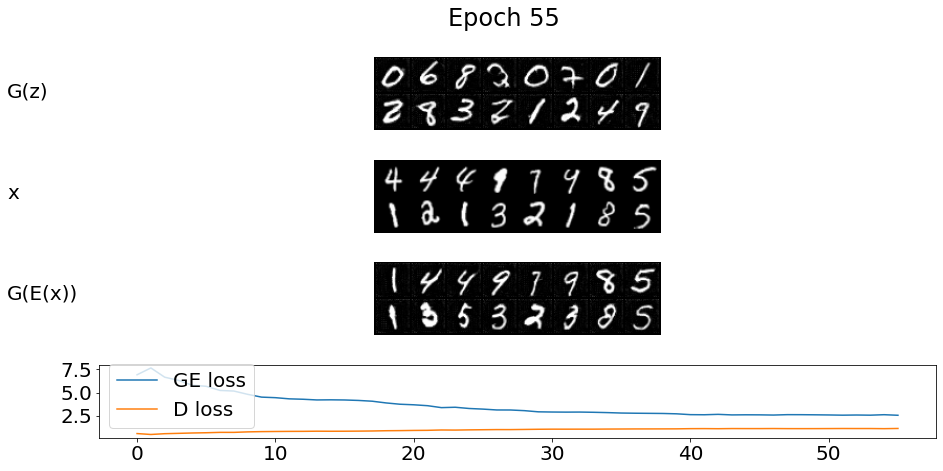

  0%|          | 1/469 [00:00<00:50,  9.29it/s]


Training... Epoch: 55, Discrimiantor Loss: 1.099, Generator Loss: 2.530


100%|██████████| 469/469 [01:00<00:00,  7.78it/s]


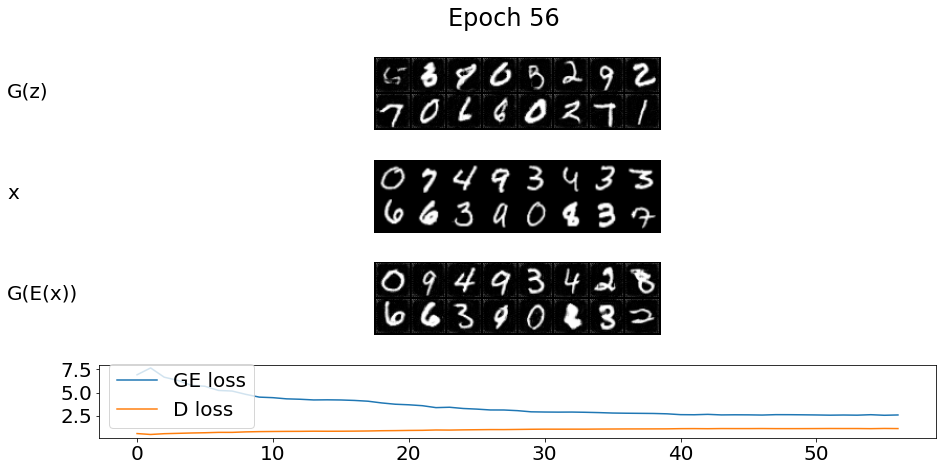

  0%|          | 1/469 [00:00<00:50,  9.19it/s]


Training... Epoch: 56, Discrimiantor Loss: 1.086, Generator Loss: 2.564


100%|██████████| 469/469 [01:00<00:00,  7.78it/s]


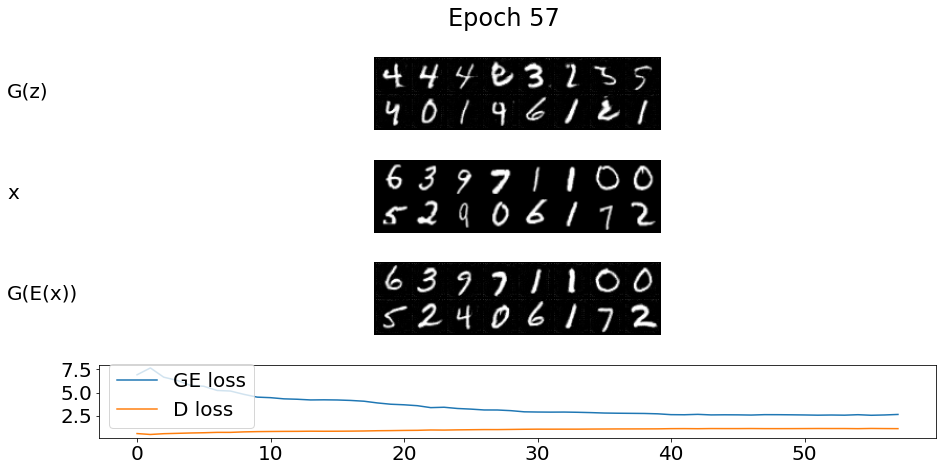

  0%|          | 1/469 [00:00<00:49,  9.40it/s]


Training... Epoch: 57, Discrimiantor Loss: 1.078, Generator Loss: 2.621


100%|██████████| 469/469 [01:00<00:00,  7.77it/s]


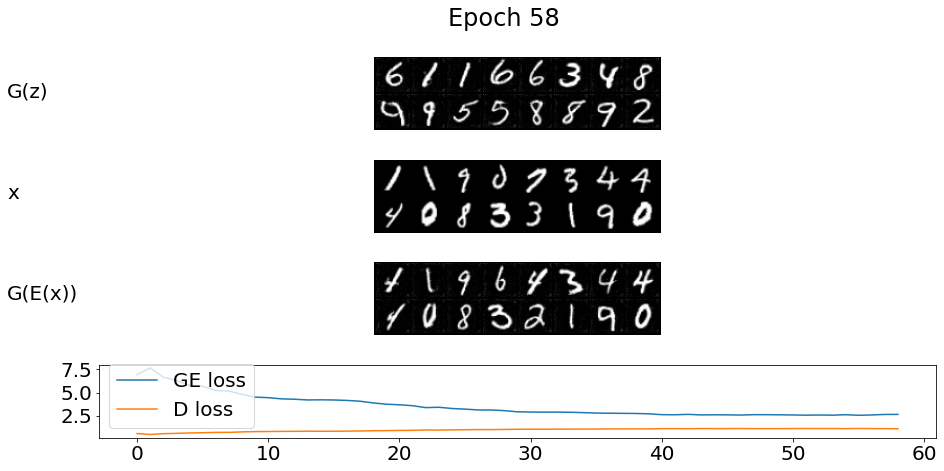

  0%|          | 1/469 [00:00<00:49,  9.46it/s]


Training... Epoch: 58, Discrimiantor Loss: 1.070, Generator Loss: 2.623


100%|██████████| 469/469 [01:00<00:00,  7.77it/s]


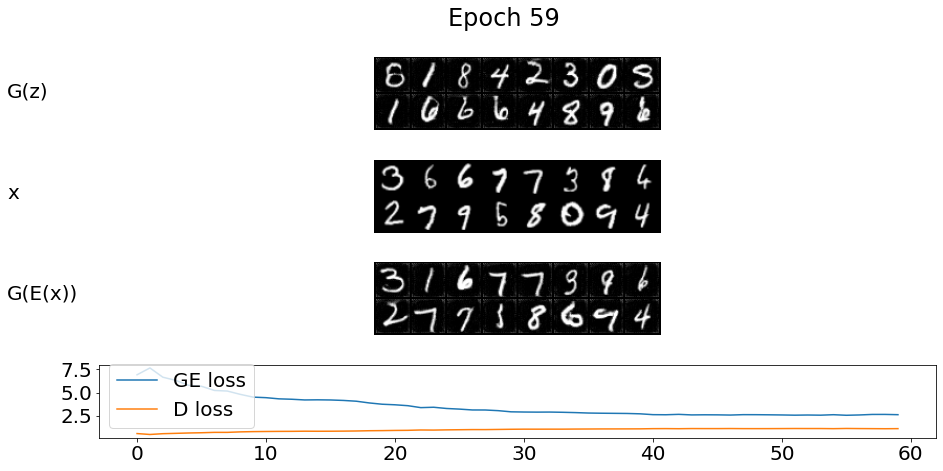

  0%|          | 1/469 [00:00<00:49,  9.51it/s]


Training... Epoch: 59, Discrimiantor Loss: 1.080, Generator Loss: 2.595


100%|██████████| 469/469 [01:00<00:00,  7.77it/s]


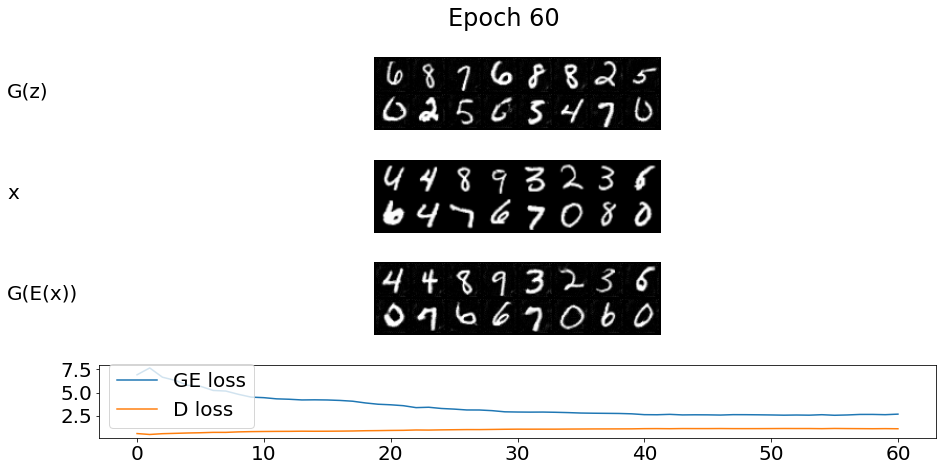

  0%|          | 1/469 [00:00<00:53,  8.79it/s]


Training... Epoch: 60, Discrimiantor Loss: 1.067, Generator Loss: 2.654


100%|██████████| 469/469 [01:00<00:00,  7.75it/s]


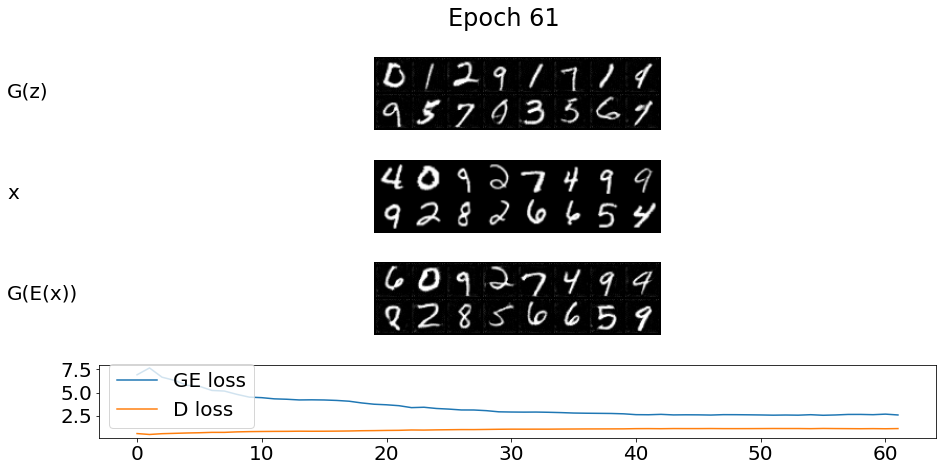

  0%|          | 1/469 [00:00<00:50,  9.33it/s]


Training... Epoch: 61, Discrimiantor Loss: 1.086, Generator Loss: 2.564


100%|██████████| 469/469 [01:00<00:00,  7.75it/s]


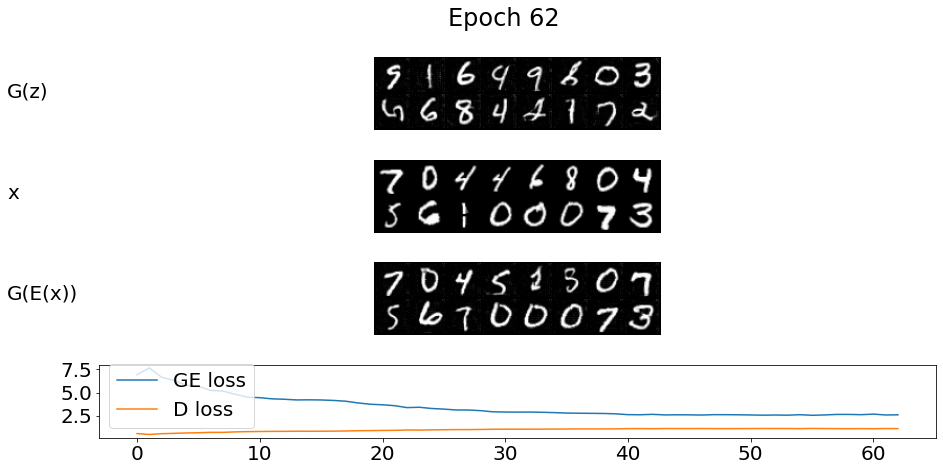

  0%|          | 1/469 [00:00<00:49,  9.45it/s]


Training... Epoch: 62, Discrimiantor Loss: 1.082, Generator Loss: 2.579


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


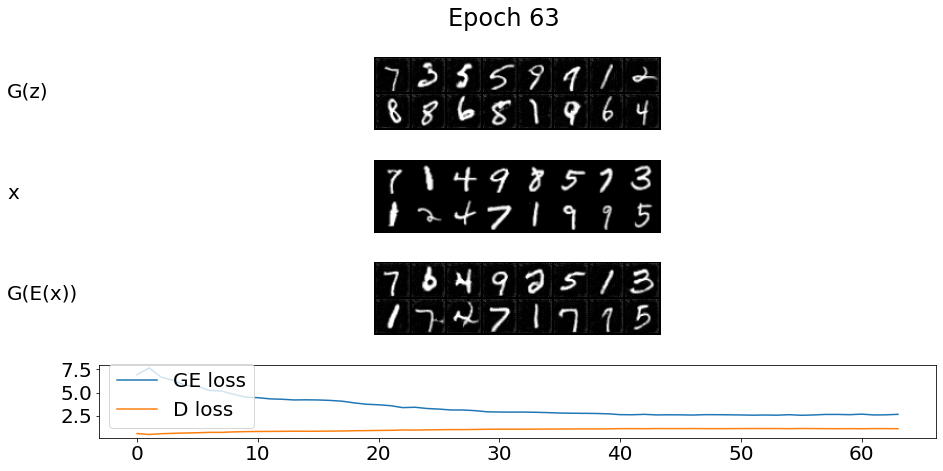

  0%|          | 1/469 [00:00<00:49,  9.48it/s]


Training... Epoch: 63, Discrimiantor Loss: 1.071, Generator Loss: 2.633


100%|██████████| 469/469 [01:00<00:00,  7.74it/s]


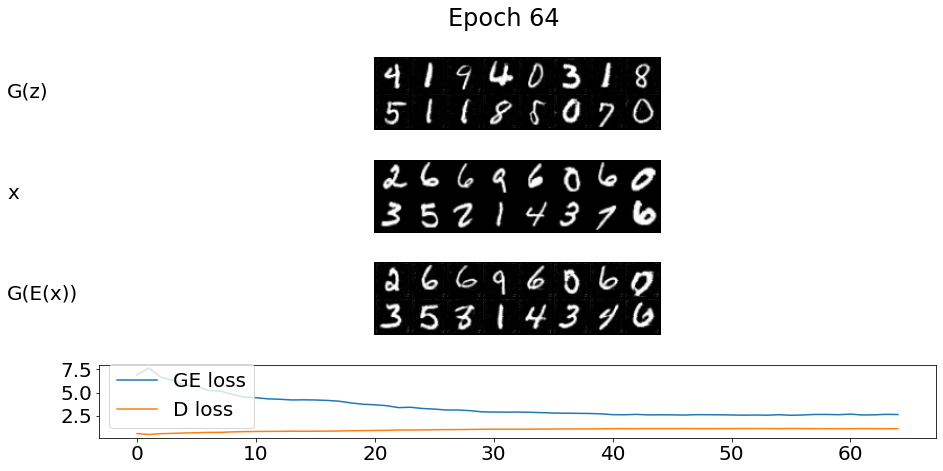

  0%|          | 1/469 [00:00<00:51,  9.17it/s]


Training... Epoch: 64, Discrimiantor Loss: 1.073, Generator Loss: 2.612


100%|██████████| 469/469 [01:00<00:00,  7.74it/s]


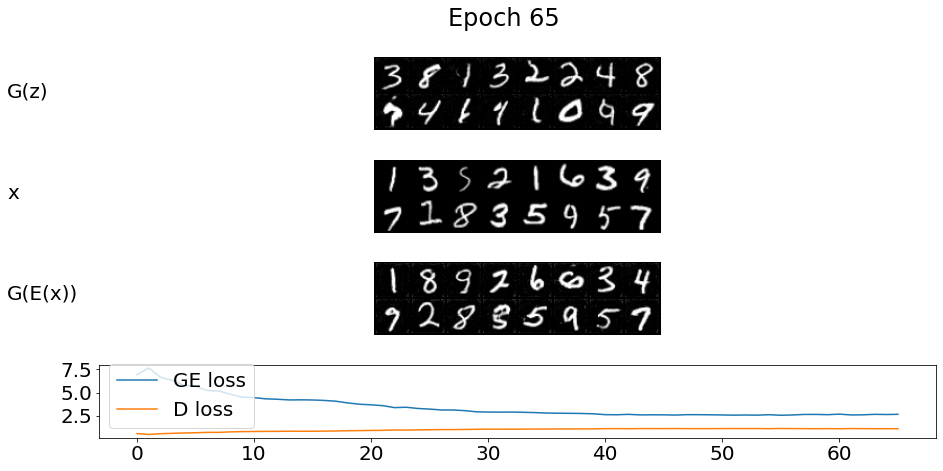

  0%|          | 1/469 [00:00<00:49,  9.48it/s]


Training... Epoch: 65, Discrimiantor Loss: 1.067, Generator Loss: 2.635


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


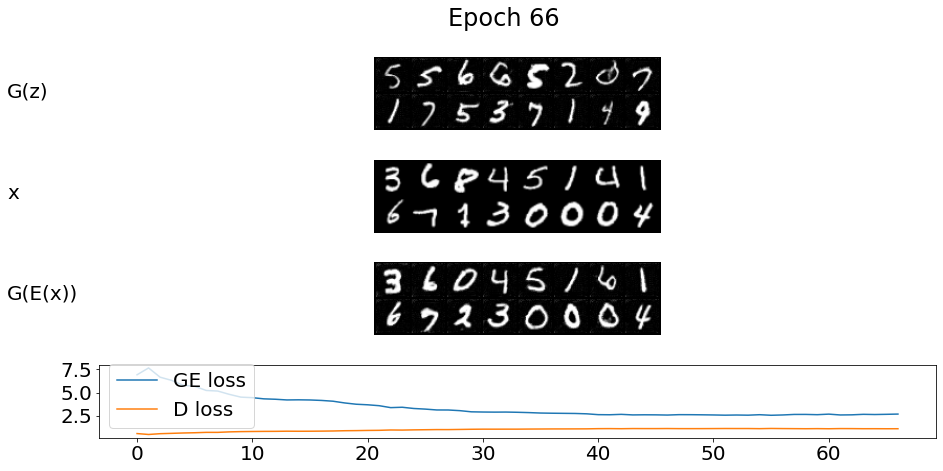

  0%|          | 1/469 [00:00<00:50,  9.19it/s]


Training... Epoch: 66, Discrimiantor Loss: 1.070, Generator Loss: 2.661


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


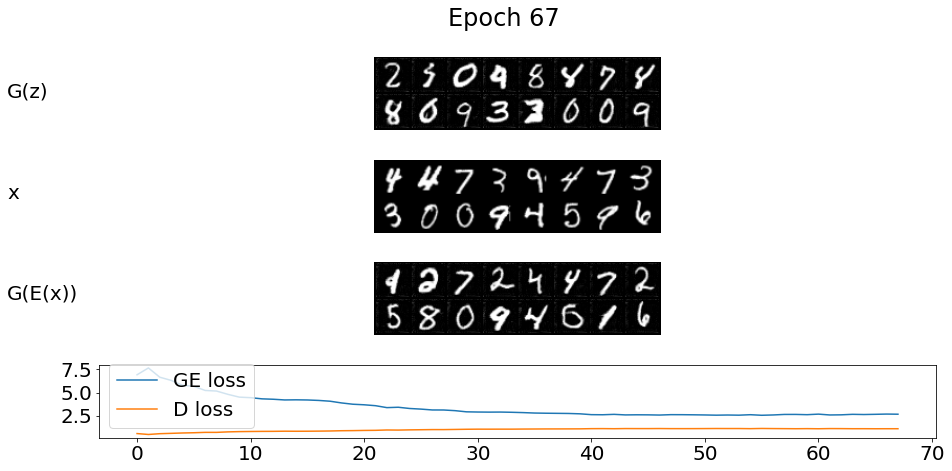

  0%|          | 1/469 [00:00<00:49,  9.49it/s]


Training... Epoch: 67, Discrimiantor Loss: 1.070, Generator Loss: 2.646


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


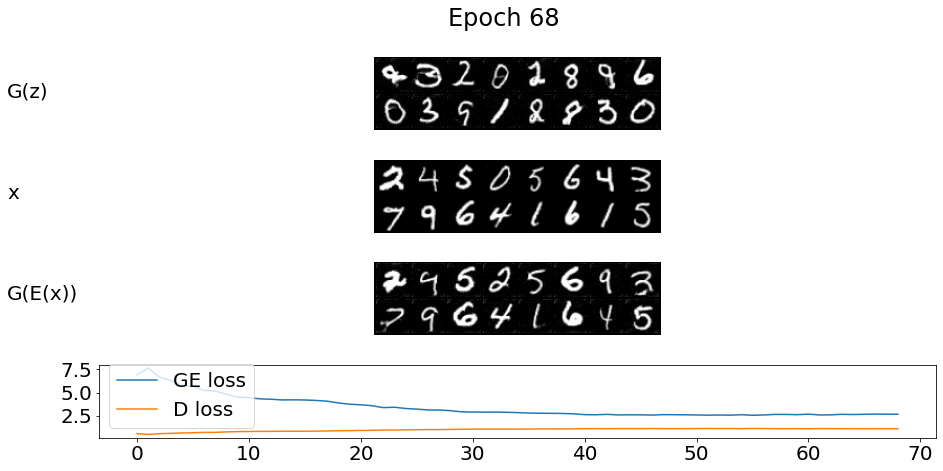

  0%|          | 1/469 [00:00<00:49,  9.39it/s]


Training... Epoch: 68, Discrimiantor Loss: 1.071, Generator Loss: 2.647


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


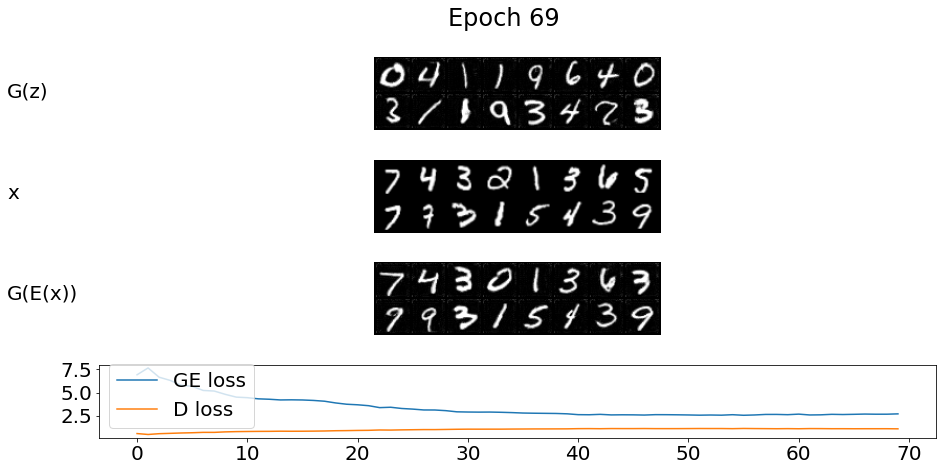

  0%|          | 1/469 [00:00<00:49,  9.46it/s]


Training... Epoch: 69, Discrimiantor Loss: 1.059, Generator Loss: 2.684


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


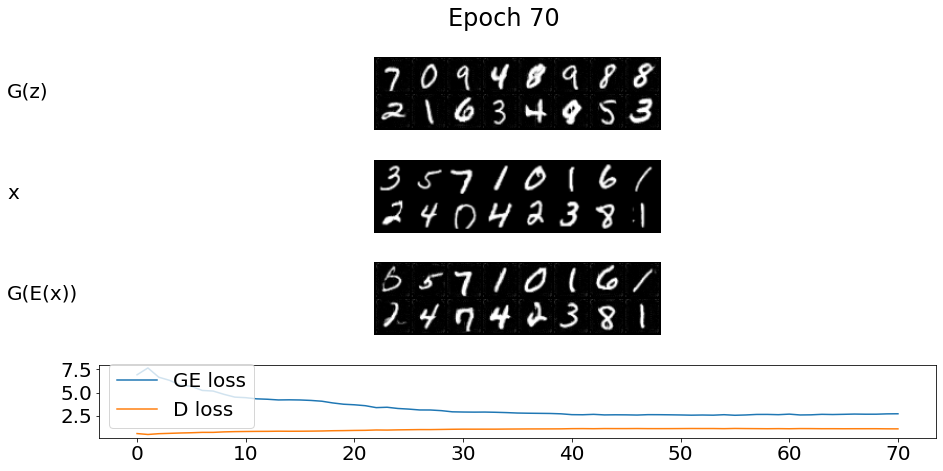

  0%|          | 1/469 [00:00<00:49,  9.36it/s]


Training... Epoch: 70, Discrimiantor Loss: 1.056, Generator Loss: 2.694


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


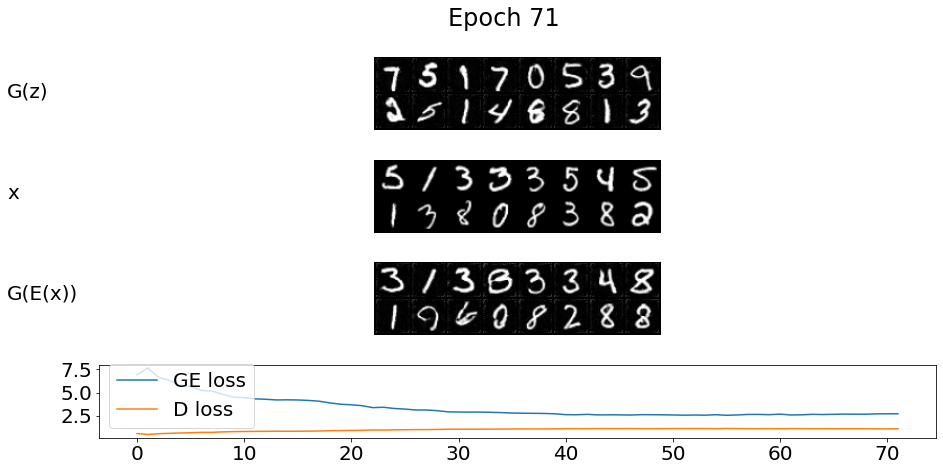

  0%|          | 1/469 [00:00<00:50,  9.23it/s]


Training... Epoch: 71, Discrimiantor Loss: 1.061, Generator Loss: 2.691


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


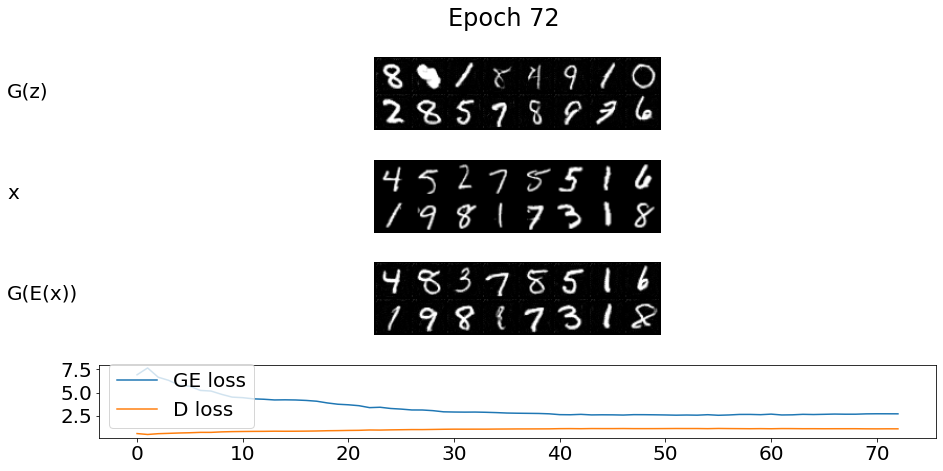

  0%|          | 1/469 [00:00<00:58,  8.02it/s]


Training... Epoch: 72, Discrimiantor Loss: 1.059, Generator Loss: 2.688


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


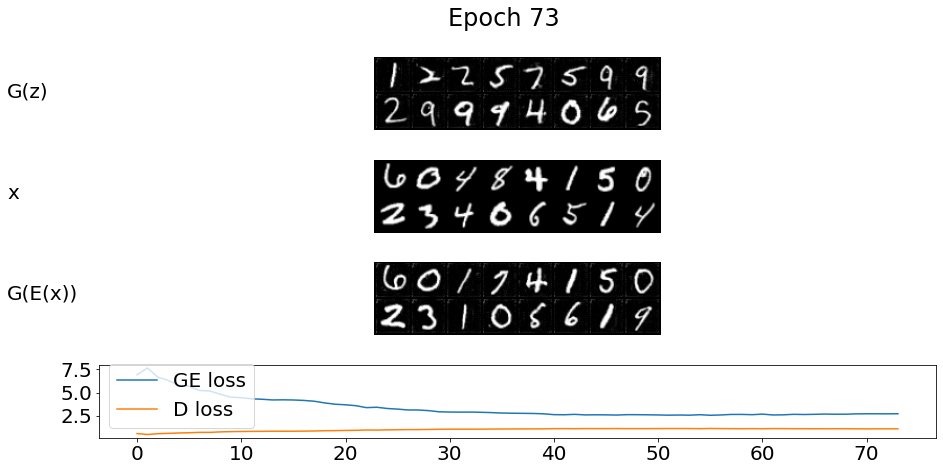

  0%|          | 1/469 [00:00<00:53,  8.73it/s]


Training... Epoch: 73, Discrimiantor Loss: 1.060, Generator Loss: 2.698


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


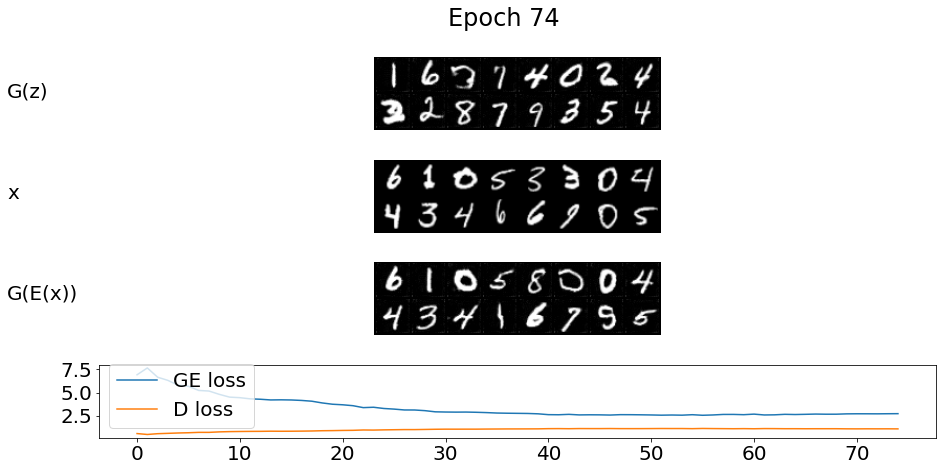

  0%|          | 1/469 [00:00<00:48,  9.70it/s]


Training... Epoch: 74, Discrimiantor Loss: 1.054, Generator Loss: 2.705


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


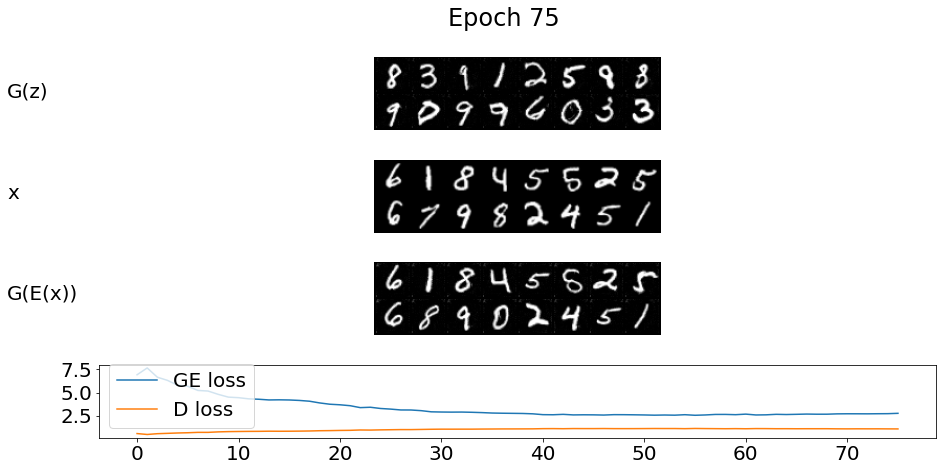

  0%|          | 1/469 [00:00<00:48,  9.59it/s]


Training... Epoch: 75, Discrimiantor Loss: 1.049, Generator Loss: 2.742


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


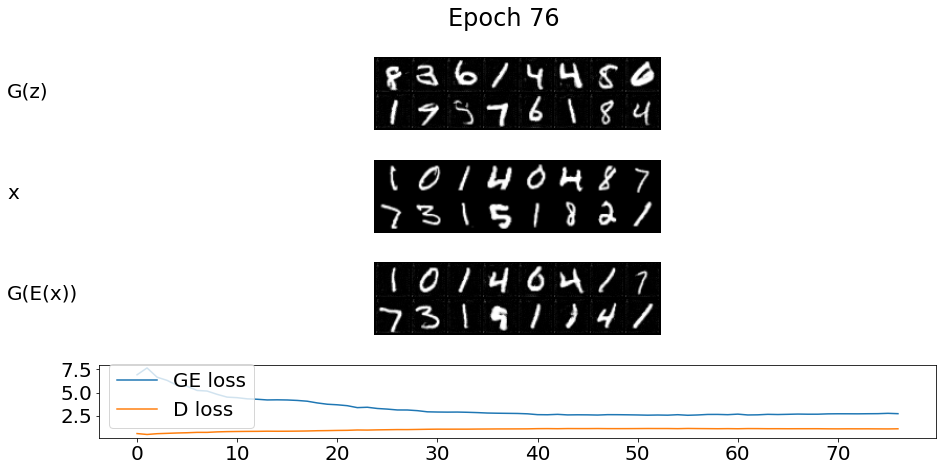

  0%|          | 1/469 [00:00<00:51,  9.14it/s]


Training... Epoch: 76, Discrimiantor Loss: 1.062, Generator Loss: 2.704


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


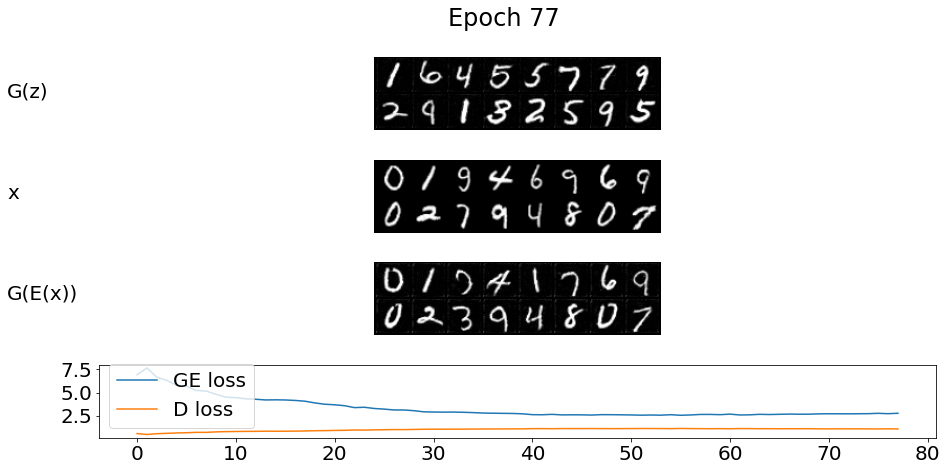

  0%|          | 1/469 [00:00<00:50,  9.29it/s]


Training... Epoch: 77, Discrimiantor Loss: 1.046, Generator Loss: 2.748


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


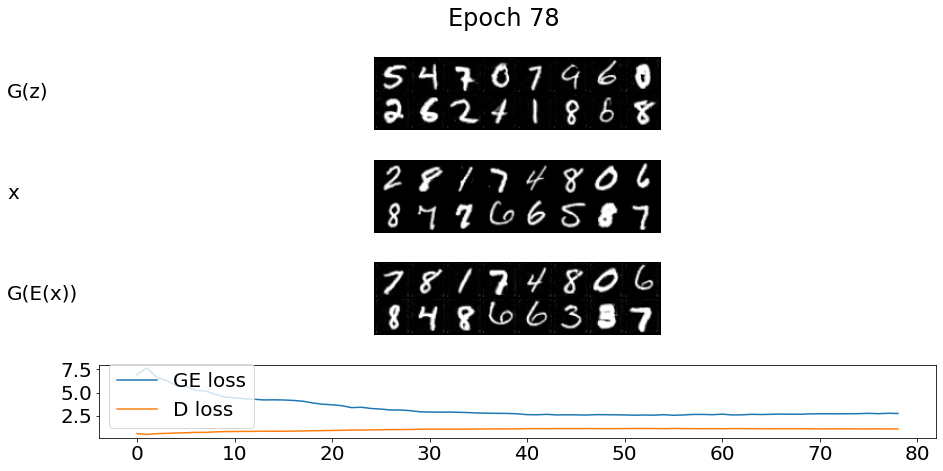

  0%|          | 1/469 [00:00<00:49,  9.40it/s]


Training... Epoch: 78, Discrimiantor Loss: 1.053, Generator Loss: 2.727


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


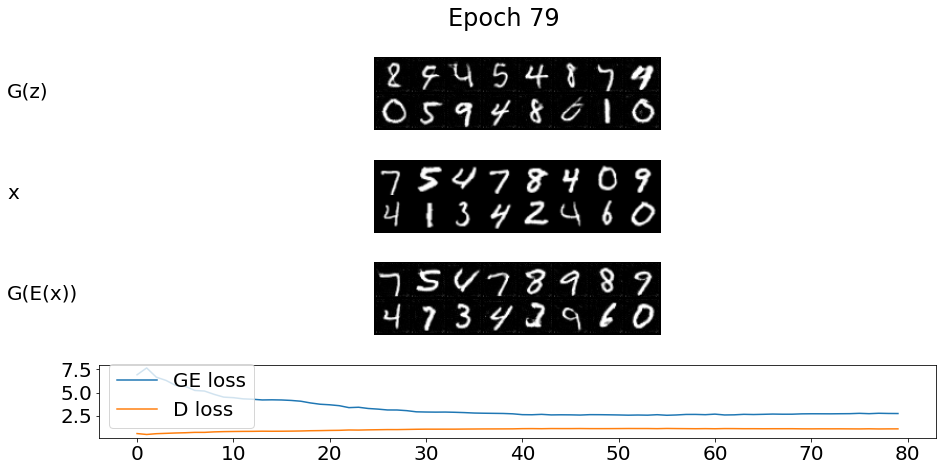

  0%|          | 1/469 [00:00<00:48,  9.69it/s]


Training... Epoch: 79, Discrimiantor Loss: 1.056, Generator Loss: 2.721


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


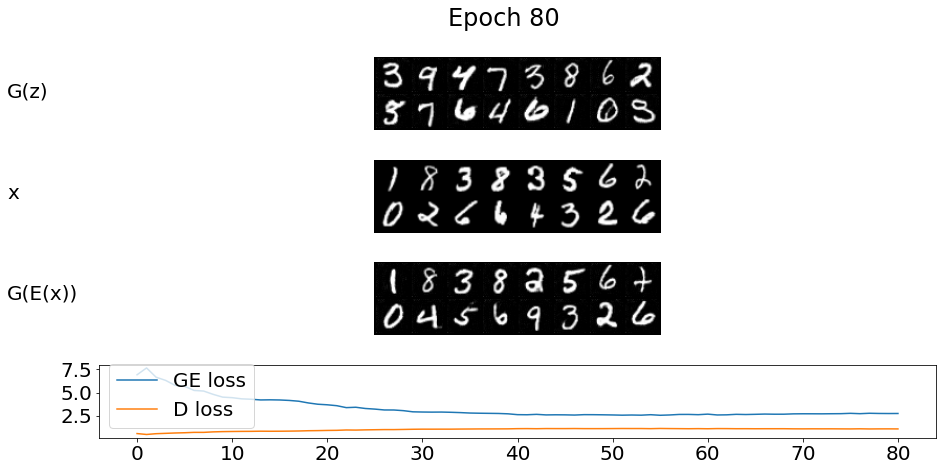

  0%|          | 1/469 [00:00<00:49,  9.49it/s]


Training... Epoch: 80, Discrimiantor Loss: 1.049, Generator Loss: 2.724


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


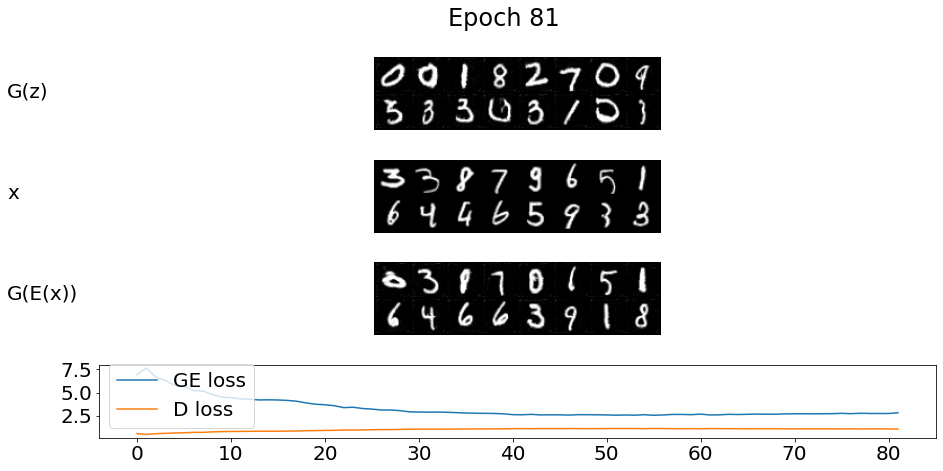

  0%|          | 1/469 [00:00<00:48,  9.64it/s]


Training... Epoch: 81, Discrimiantor Loss: 1.034, Generator Loss: 2.800


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


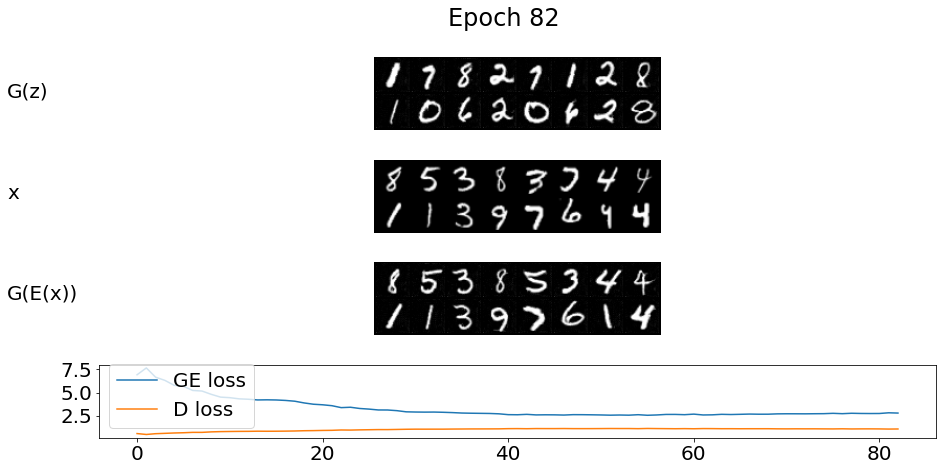

  0%|          | 1/469 [00:00<00:50,  9.21it/s]


Training... Epoch: 82, Discrimiantor Loss: 1.042, Generator Loss: 2.770


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


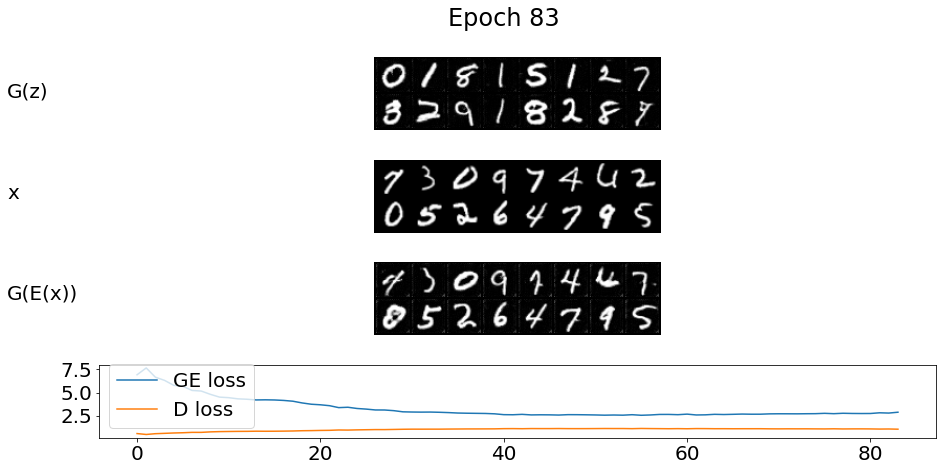

  0%|          | 1/469 [00:00<00:50,  9.36it/s]


Training... Epoch: 83, Discrimiantor Loss: 1.019, Generator Loss: 2.862


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


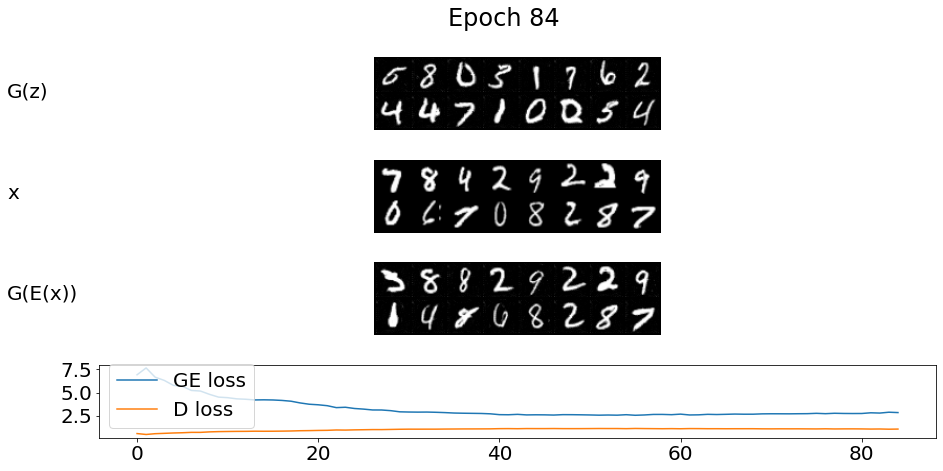

  0%|          | 1/469 [00:00<00:52,  8.92it/s]


Training... Epoch: 84, Discrimiantor Loss: 1.032, Generator Loss: 2.824


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


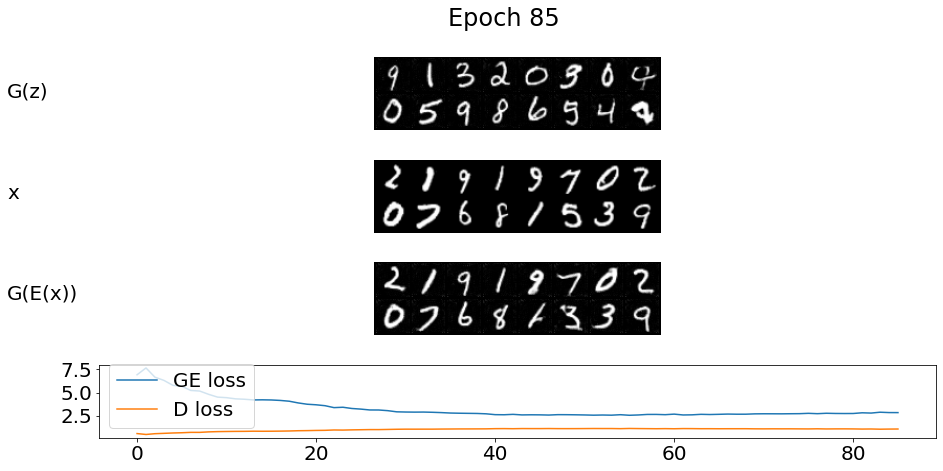

  0%|          | 1/469 [00:00<00:49,  9.41it/s]


Training... Epoch: 85, Discrimiantor Loss: 1.039, Generator Loss: 2.820


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


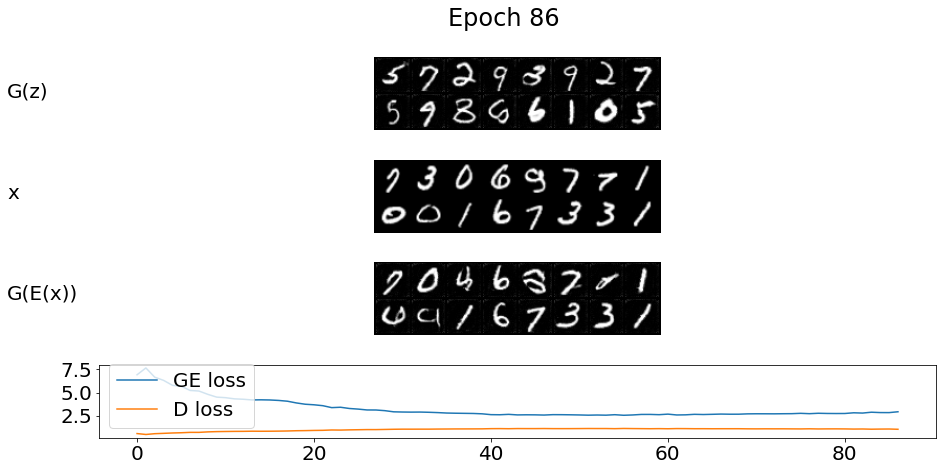

  0%|          | 1/469 [00:00<00:48,  9.66it/s]


Training... Epoch: 86, Discrimiantor Loss: 1.010, Generator Loss: 2.911


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


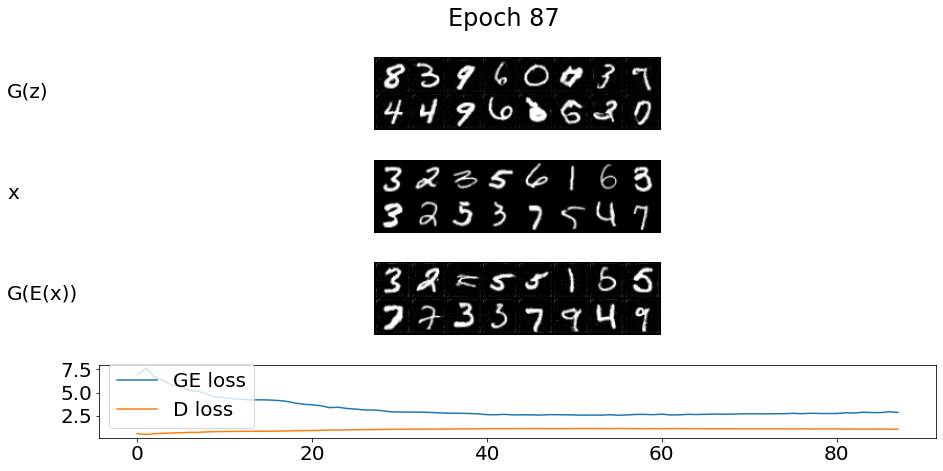

  0%|          | 1/469 [00:00<00:47,  9.79it/s]


Training... Epoch: 87, Discrimiantor Loss: 1.029, Generator Loss: 2.838


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


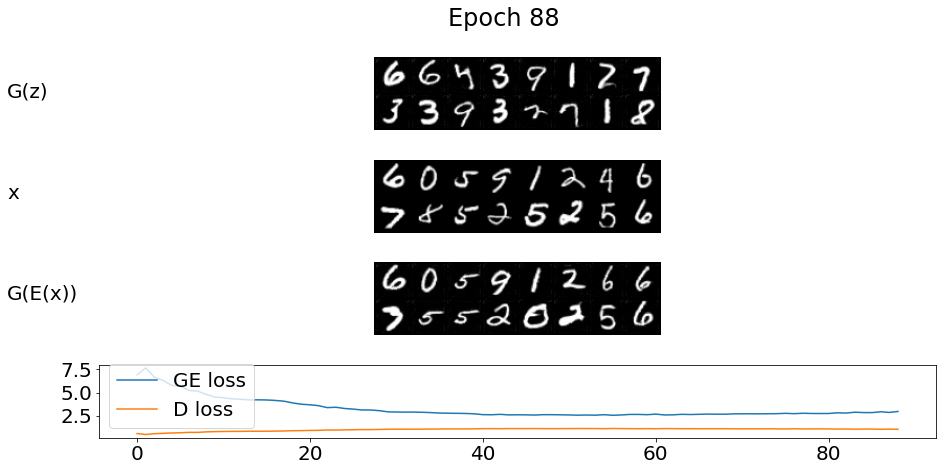

  0%|          | 1/469 [00:00<00:54,  8.56it/s]


Training... Epoch: 88, Discrimiantor Loss: 1.007, Generator Loss: 2.942


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


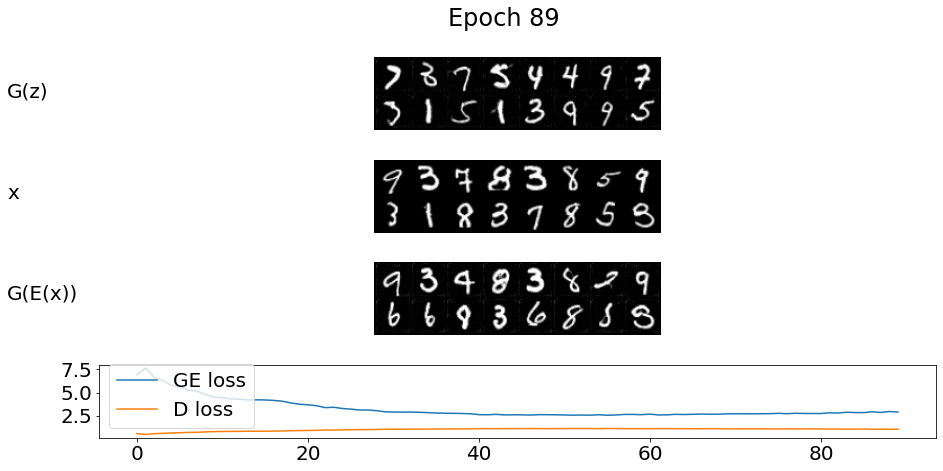

  0%|          | 1/469 [00:00<00:48,  9.60it/s]


Training... Epoch: 89, Discrimiantor Loss: 1.026, Generator Loss: 2.875


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


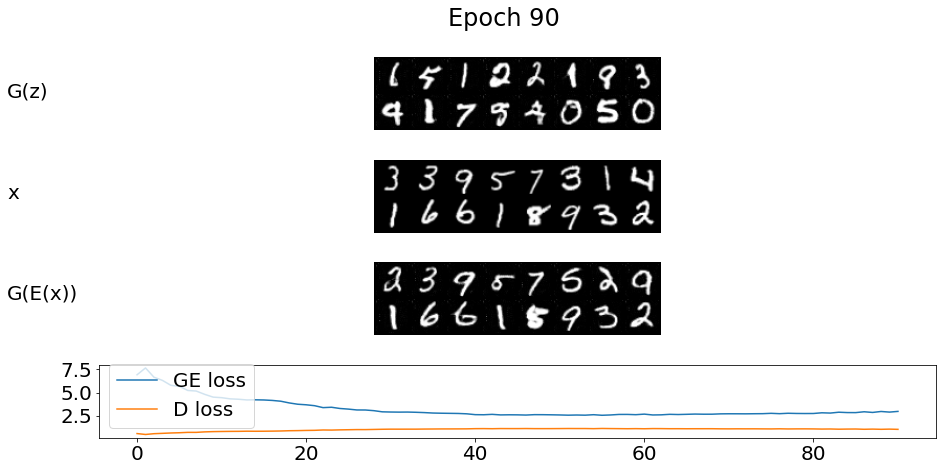

  0%|          | 1/469 [00:00<00:48,  9.62it/s]


Training... Epoch: 90, Discrimiantor Loss: 1.003, Generator Loss: 2.951


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


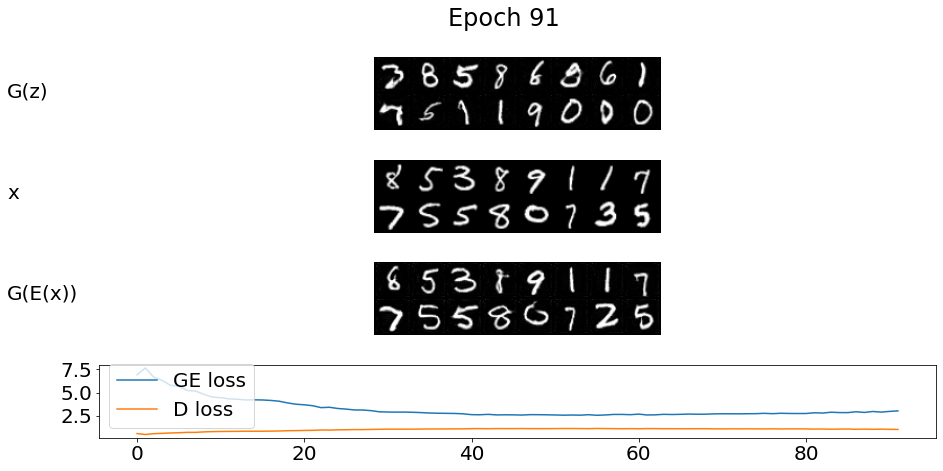

  0%|          | 1/469 [00:00<00:48,  9.62it/s]


Training... Epoch: 91, Discrimiantor Loss: 0.996, Generator Loss: 3.009


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


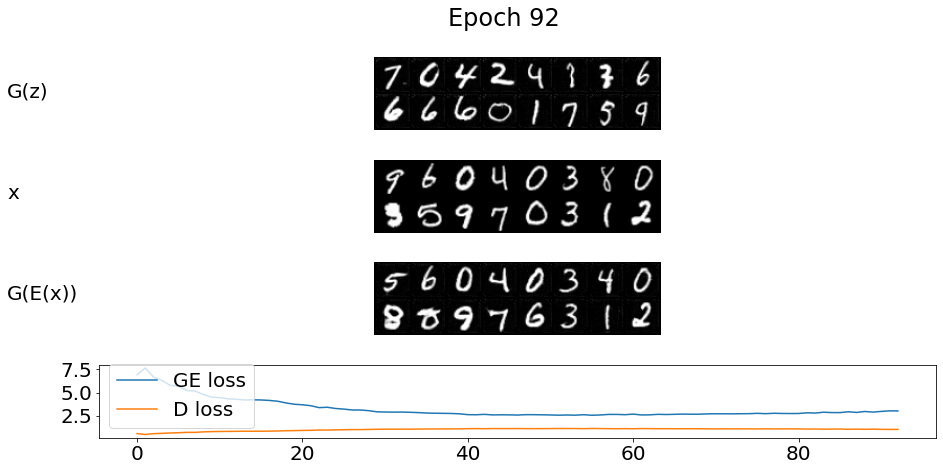

  0%|          | 1/469 [00:00<00:47,  9.76it/s]


Training... Epoch: 92, Discrimiantor Loss: 0.999, Generator Loss: 3.001


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


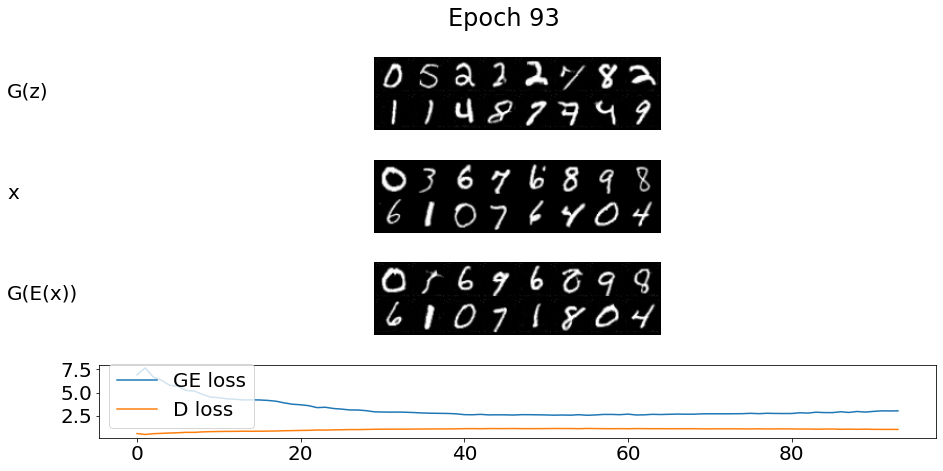

  0%|          | 1/469 [00:00<00:49,  9.49it/s]


Training... Epoch: 93, Discrimiantor Loss: 0.995, Generator Loss: 3.013


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


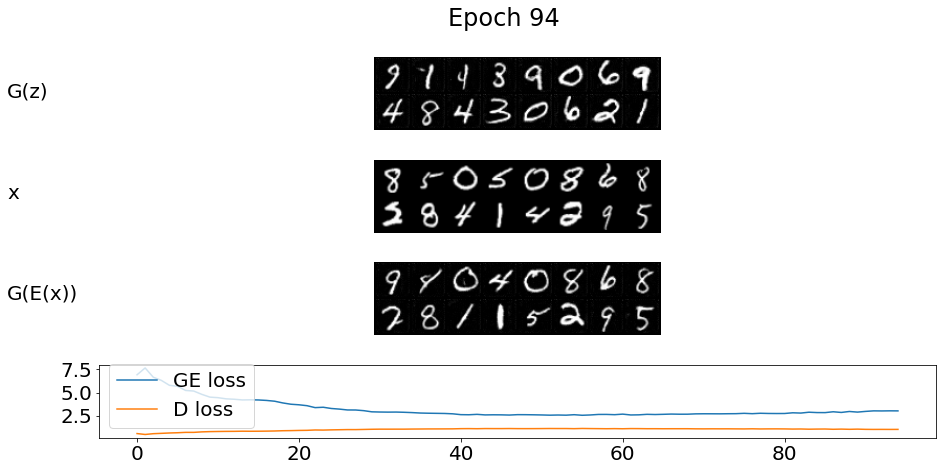

  0%|          | 1/469 [00:00<00:49,  9.49it/s]


Training... Epoch: 94, Discrimiantor Loss: 0.998, Generator Loss: 3.007


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


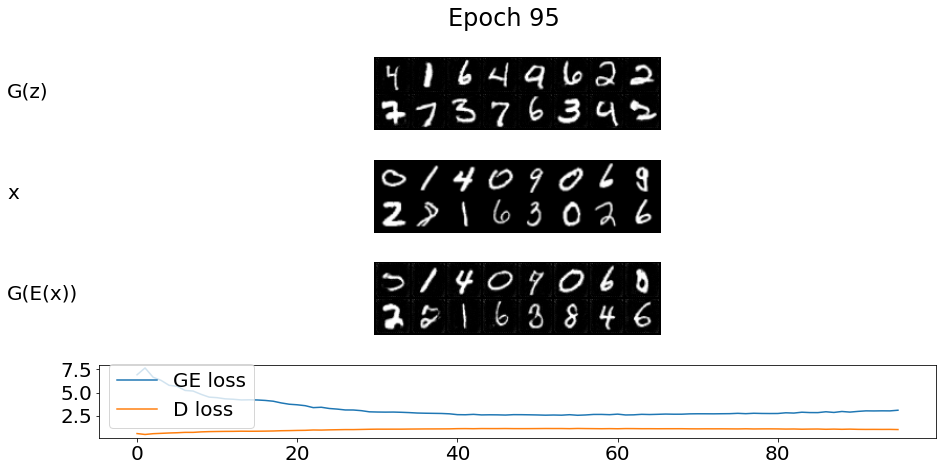

  0%|          | 1/469 [00:00<00:53,  8.79it/s]


Training... Epoch: 95, Discrimiantor Loss: 0.981, Generator Loss: 3.079


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


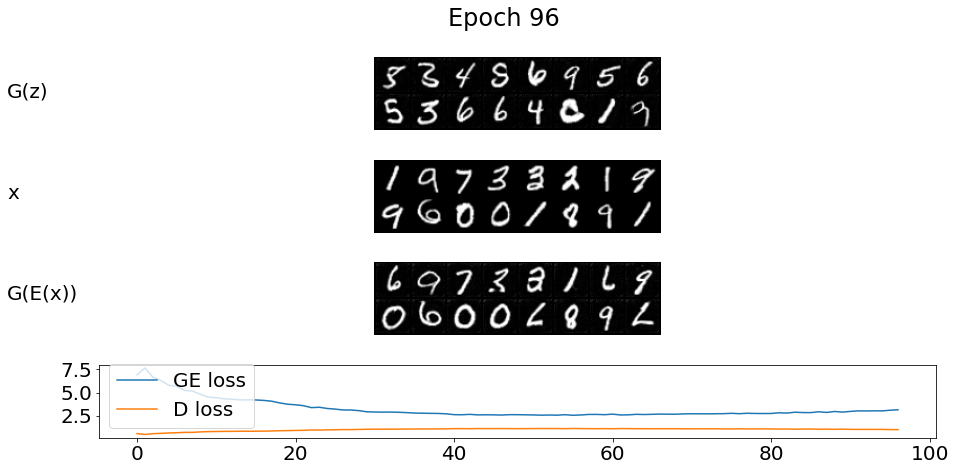

  0%|          | 1/469 [00:00<00:51,  9.02it/s]


Training... Epoch: 96, Discrimiantor Loss: 0.972, Generator Loss: 3.125


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


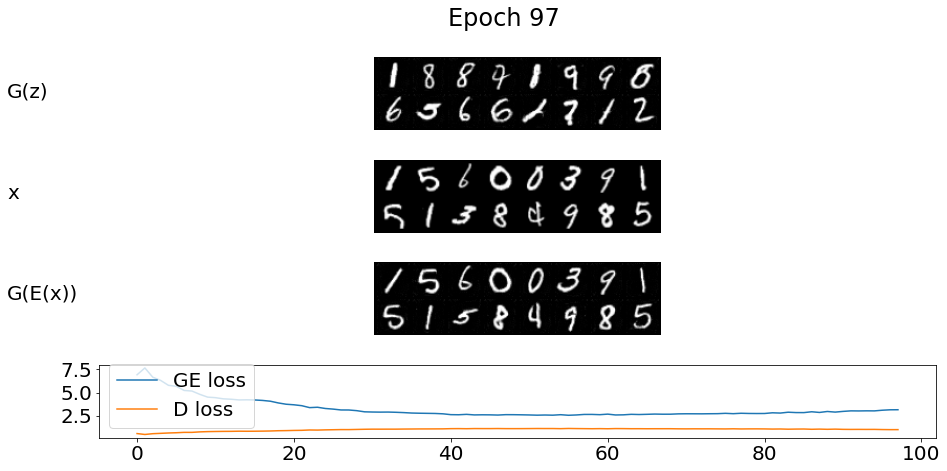

  0%|          | 1/469 [00:00<00:49,  9.42it/s]


Training... Epoch: 97, Discrimiantor Loss: 0.973, Generator Loss: 3.132


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


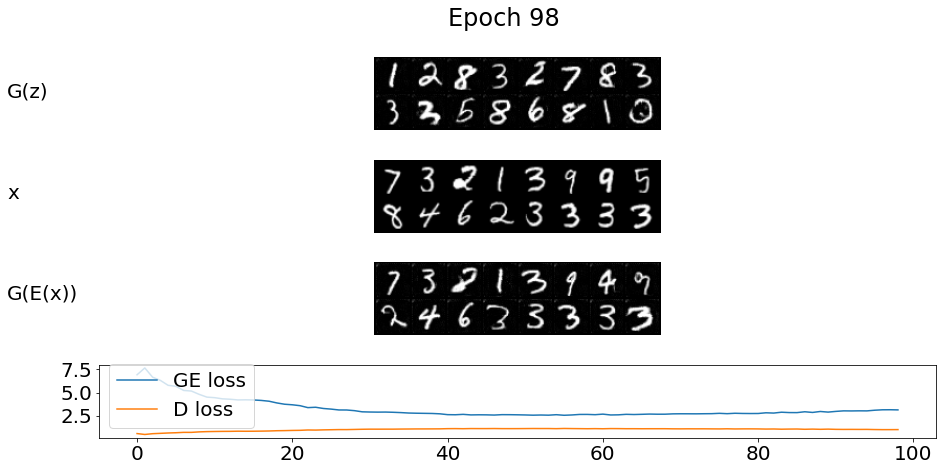

  0%|          | 1/469 [00:00<00:54,  8.51it/s]


Training... Epoch: 98, Discrimiantor Loss: 0.976, Generator Loss: 3.114


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


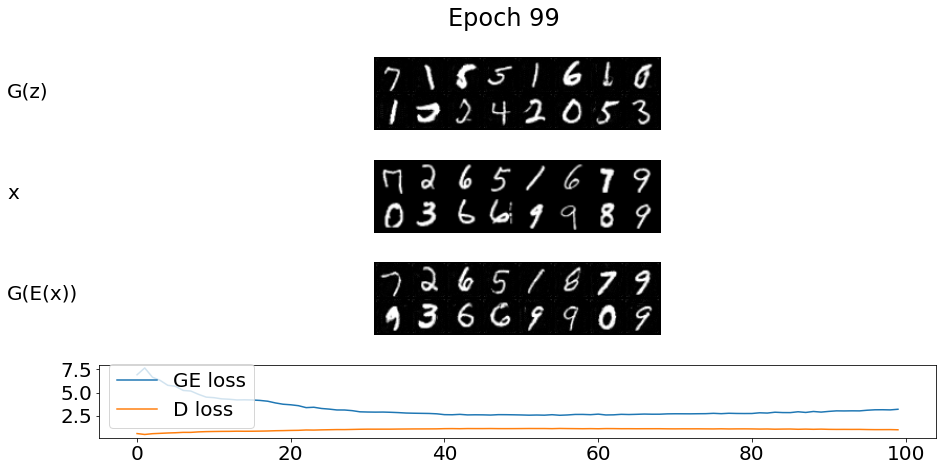

  0%|          | 1/469 [00:00<00:50,  9.35it/s]


Training... Epoch: 99, Discrimiantor Loss: 0.957, Generator Loss: 3.183


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


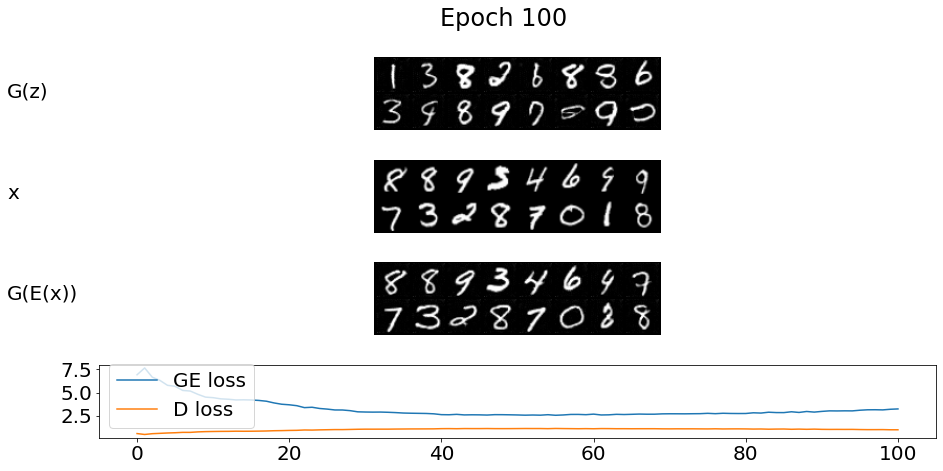

  0%|          | 1/469 [00:00<00:50,  9.30it/s]


Training... Epoch: 100, Discrimiantor Loss: 0.956, Generator Loss: 3.220


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


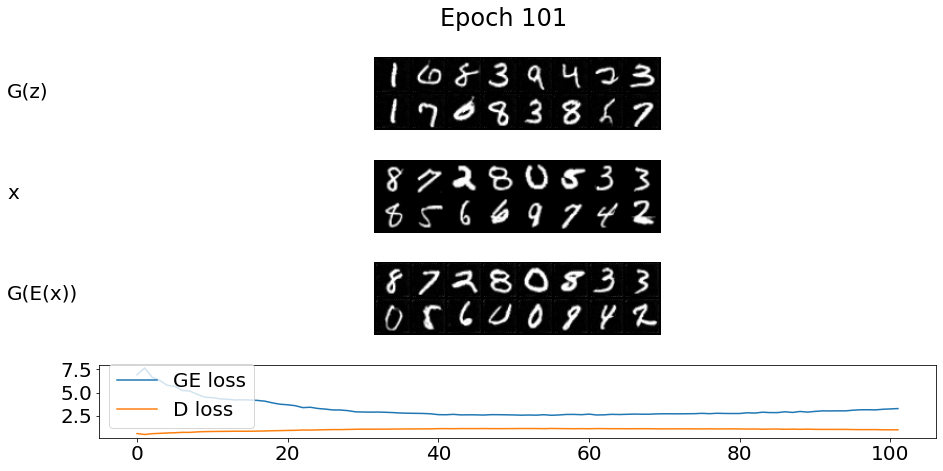

  0%|          | 1/469 [00:00<00:52,  8.99it/s]


Training... Epoch: 101, Discrimiantor Loss: 0.953, Generator Loss: 3.259


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


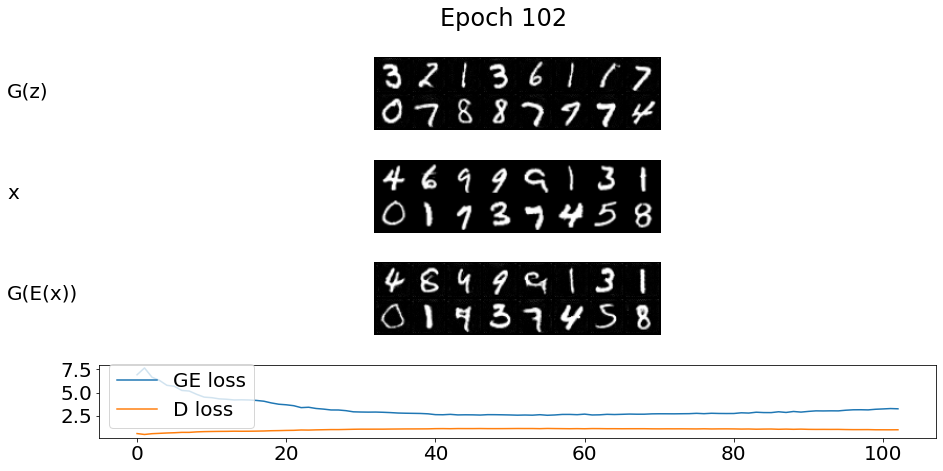

  0%|          | 1/469 [00:00<00:49,  9.43it/s]


Training... Epoch: 102, Discrimiantor Loss: 0.958, Generator Loss: 3.233


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


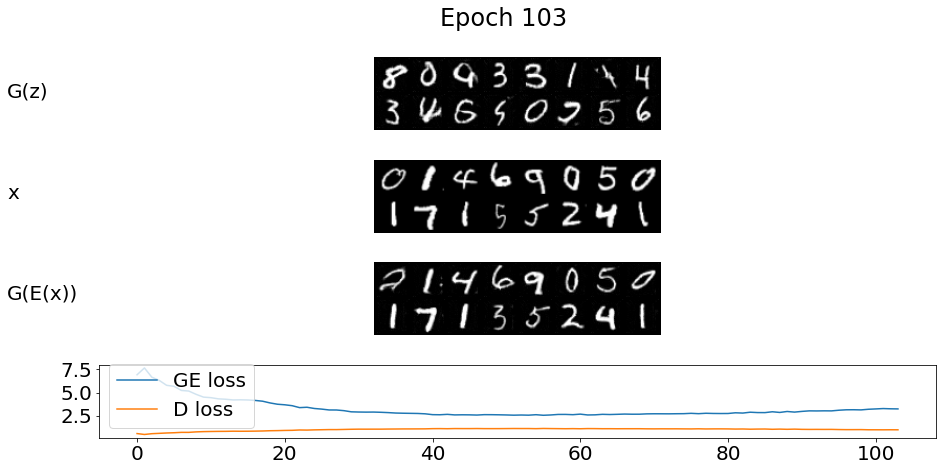

  0%|          | 1/469 [00:00<00:48,  9.64it/s]


Training... Epoch: 103, Discrimiantor Loss: 0.954, Generator Loss: 3.222


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


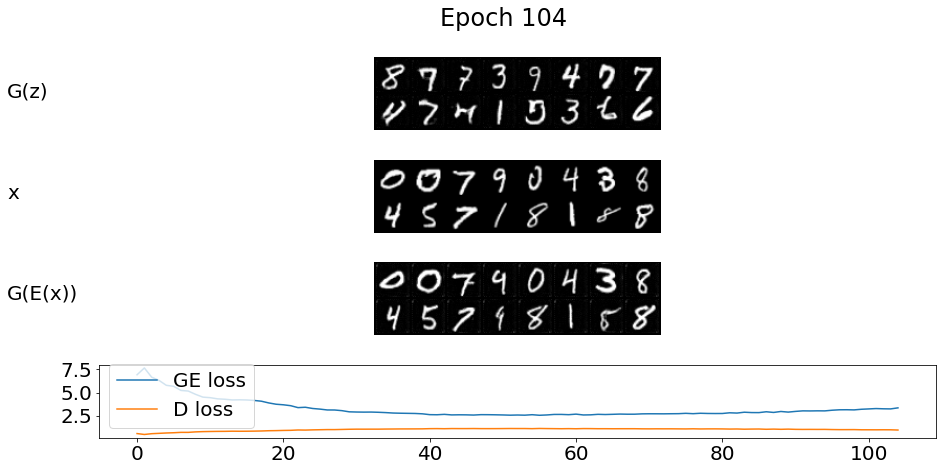

  0%|          | 1/469 [00:00<00:49,  9.51it/s]


Training... Epoch: 104, Discrimiantor Loss: 0.929, Generator Loss: 3.336


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


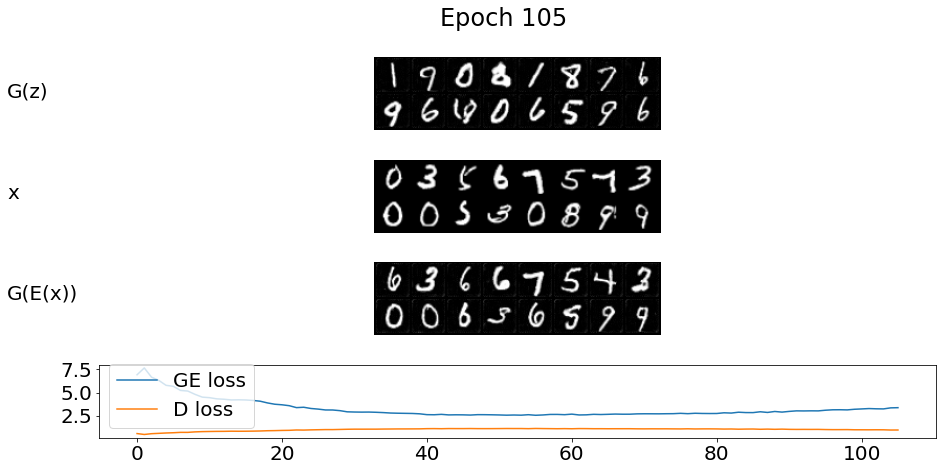

  0%|          | 1/469 [00:00<00:49,  9.55it/s]


Training... Epoch: 105, Discrimiantor Loss: 0.932, Generator Loss: 3.355


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


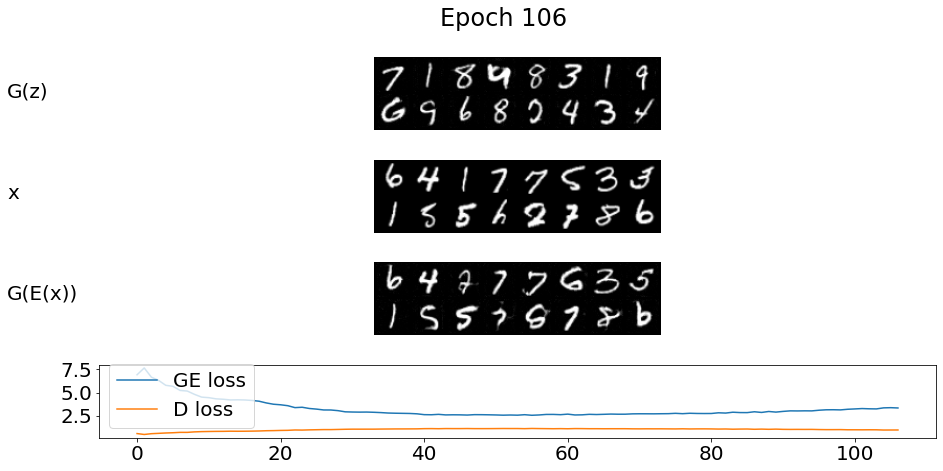

  0%|          | 1/469 [00:00<00:53,  8.76it/s]


Training... Epoch: 106, Discrimiantor Loss: 0.935, Generator Loss: 3.323


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


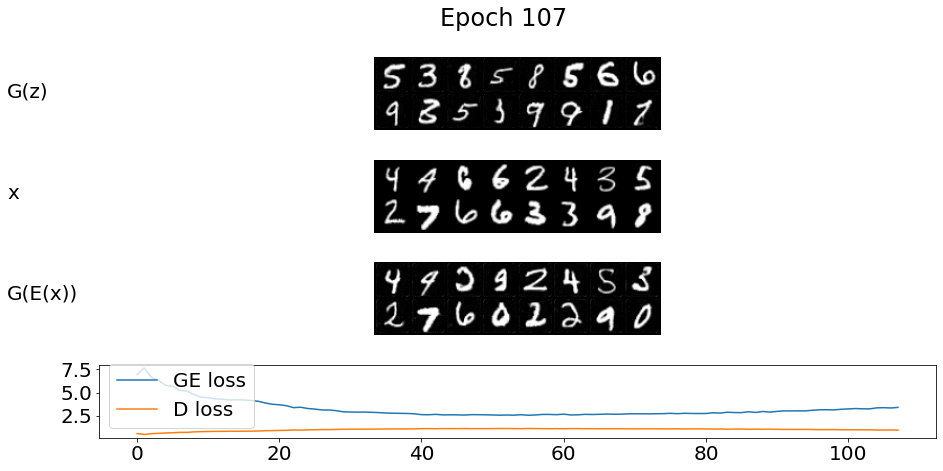

  0%|          | 1/469 [00:00<00:51,  9.11it/s]


Training... Epoch: 107, Discrimiantor Loss: 0.918, Generator Loss: 3.386


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


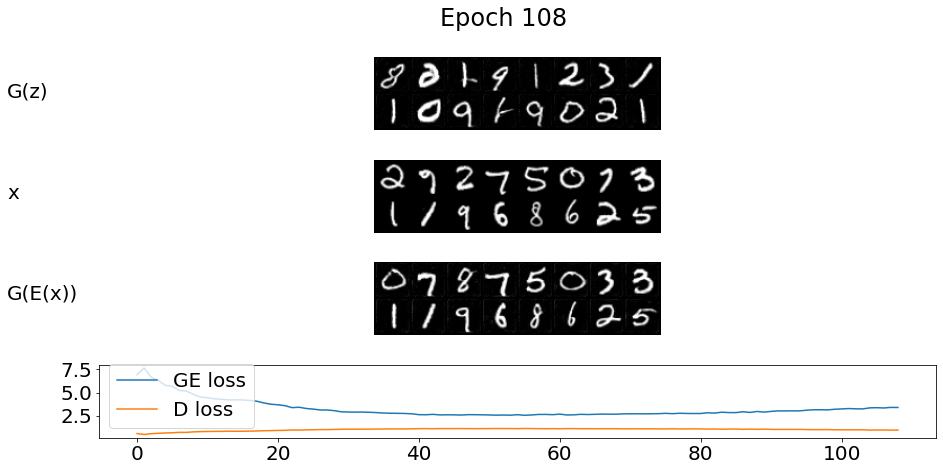

  0%|          | 1/469 [00:00<00:49,  9.48it/s]


Training... Epoch: 108, Discrimiantor Loss: 0.930, Generator Loss: 3.375


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


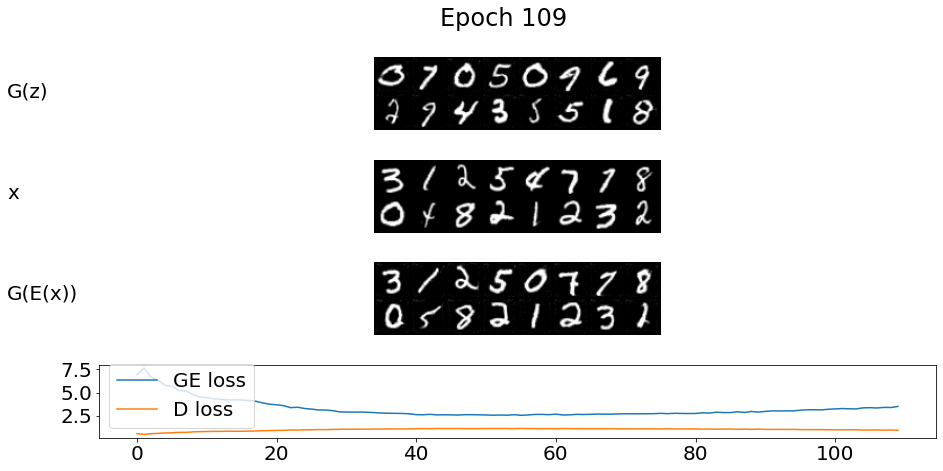

  0%|          | 1/469 [00:00<00:48,  9.64it/s]


Training... Epoch: 109, Discrimiantor Loss: 0.902, Generator Loss: 3.493


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


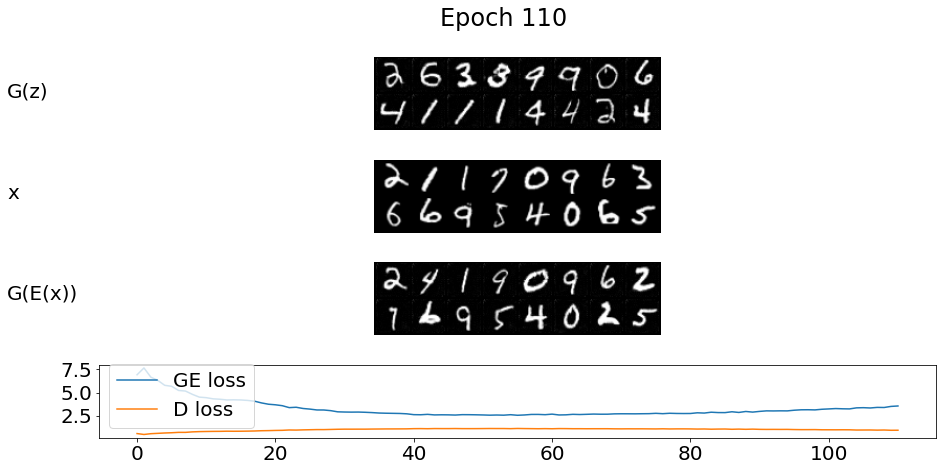

  0%|          | 1/469 [00:00<00:50,  9.31it/s]


Training... Epoch: 110, Discrimiantor Loss: 0.907, Generator Loss: 3.540


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


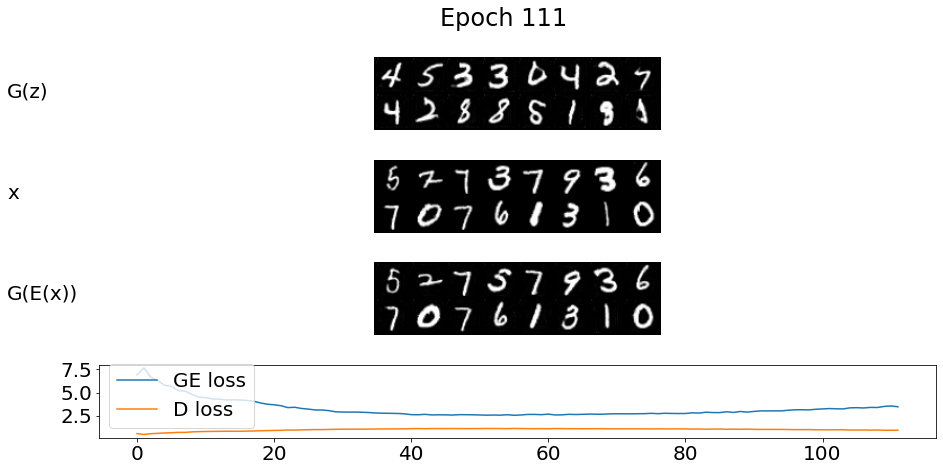

  0%|          | 1/469 [00:00<00:50,  9.36it/s]


Training... Epoch: 111, Discrimiantor Loss: 0.908, Generator Loss: 3.455


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


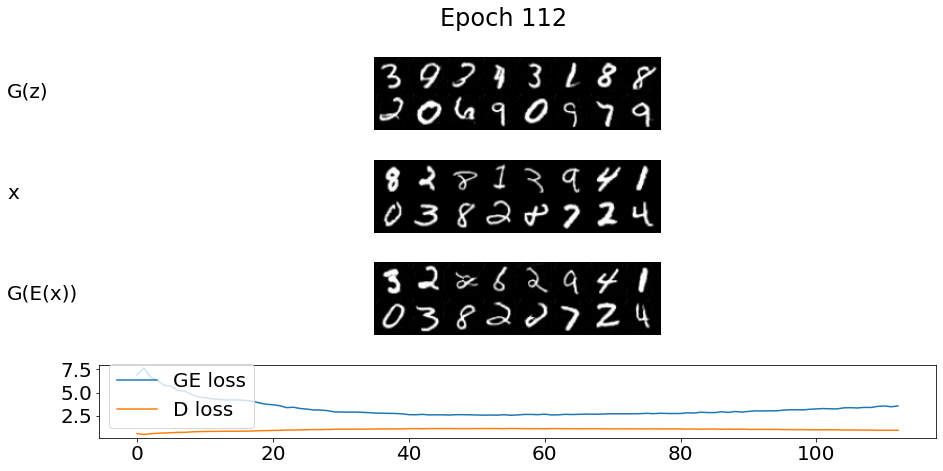

  0%|          | 1/469 [00:00<00:52,  8.89it/s]


Training... Epoch: 112, Discrimiantor Loss: 0.899, Generator Loss: 3.543


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


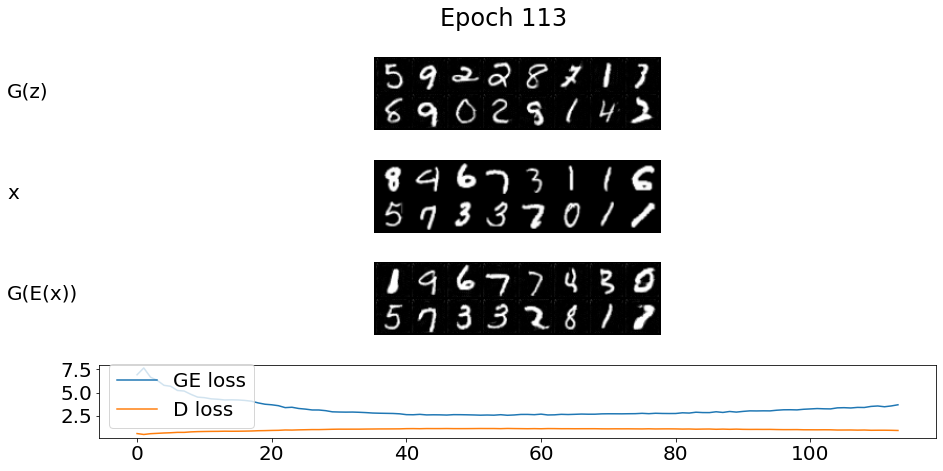

  0%|          | 1/469 [00:00<00:48,  9.57it/s]


Training... Epoch: 113, Discrimiantor Loss: 0.880, Generator Loss: 3.670


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


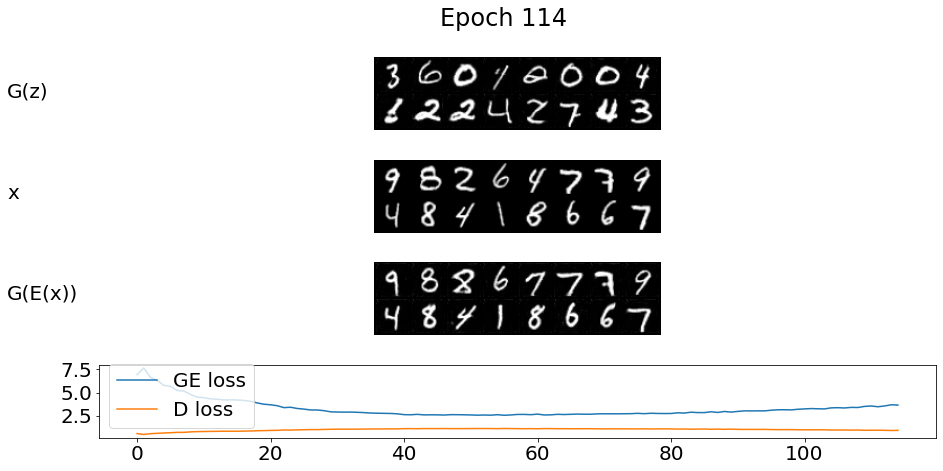

  0%|          | 1/469 [00:00<00:50,  9.28it/s]


Training... Epoch: 114, Discrimiantor Loss: 0.889, Generator Loss: 3.638


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


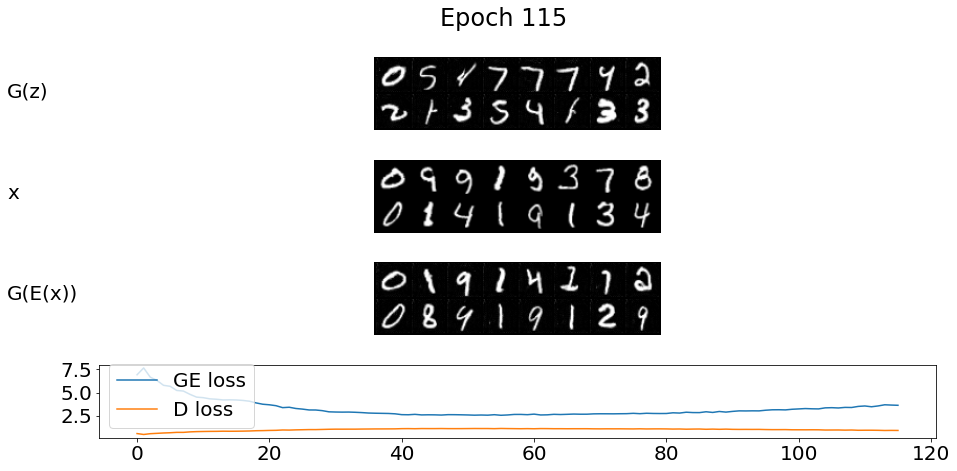

  0%|          | 1/469 [00:00<00:51,  9.00it/s]


Training... Epoch: 115, Discrimiantor Loss: 0.884, Generator Loss: 3.614


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


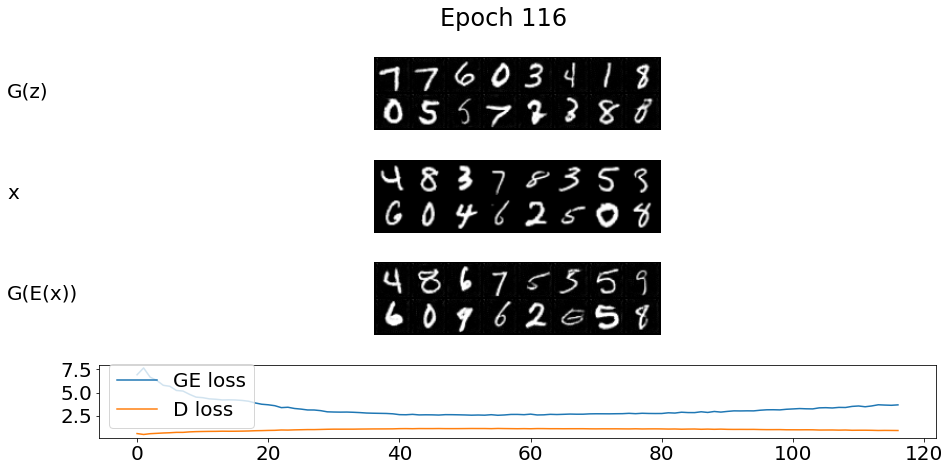

  0%|          | 1/469 [00:00<00:49,  9.52it/s]


Training... Epoch: 116, Discrimiantor Loss: 0.877, Generator Loss: 3.660


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


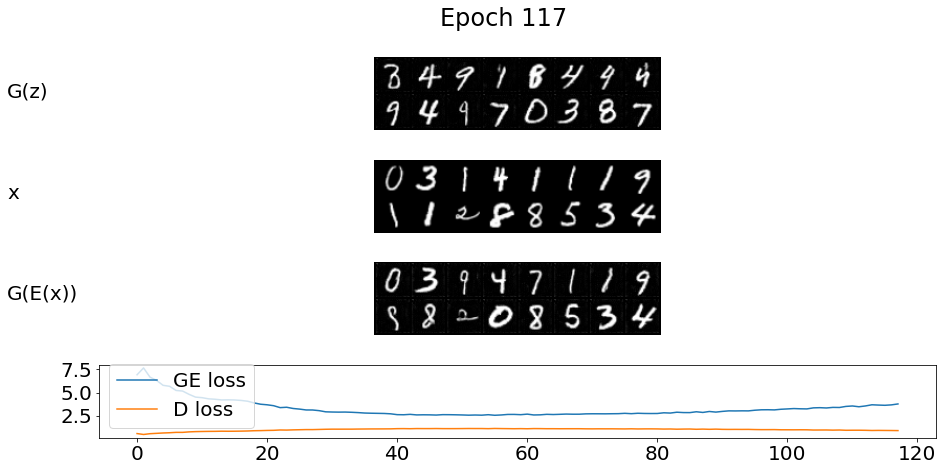

  0%|          | 1/469 [00:00<00:48,  9.65it/s]


Training... Epoch: 117, Discrimiantor Loss: 0.868, Generator Loss: 3.760


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


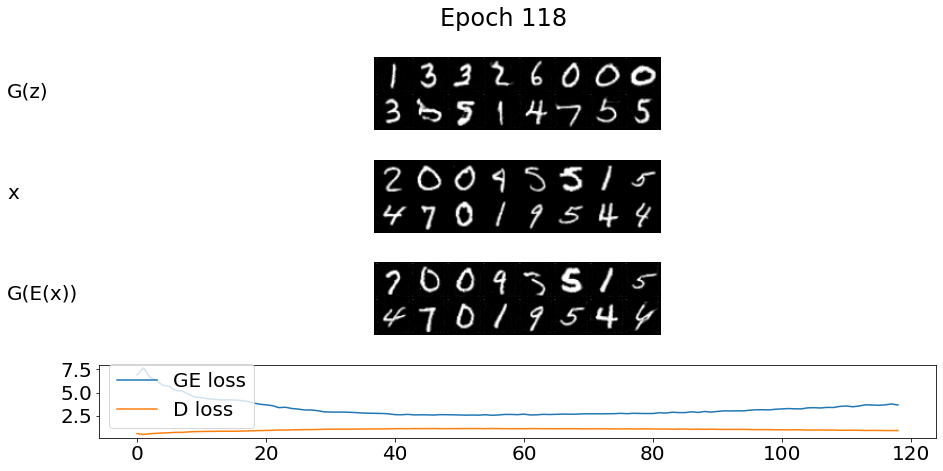

  0%|          | 1/469 [00:00<00:48,  9.60it/s]


Training... Epoch: 118, Discrimiantor Loss: 0.878, Generator Loss: 3.640


100%|██████████| 469/469 [01:00<00:00,  7.75it/s]


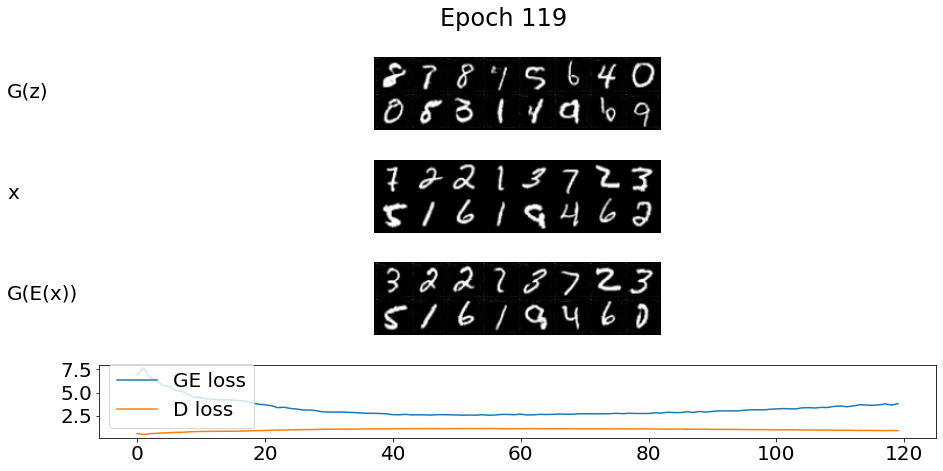

  0%|          | 1/469 [00:00<00:47,  9.87it/s]


Training... Epoch: 119, Discrimiantor Loss: 0.863, Generator Loss: 3.787


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


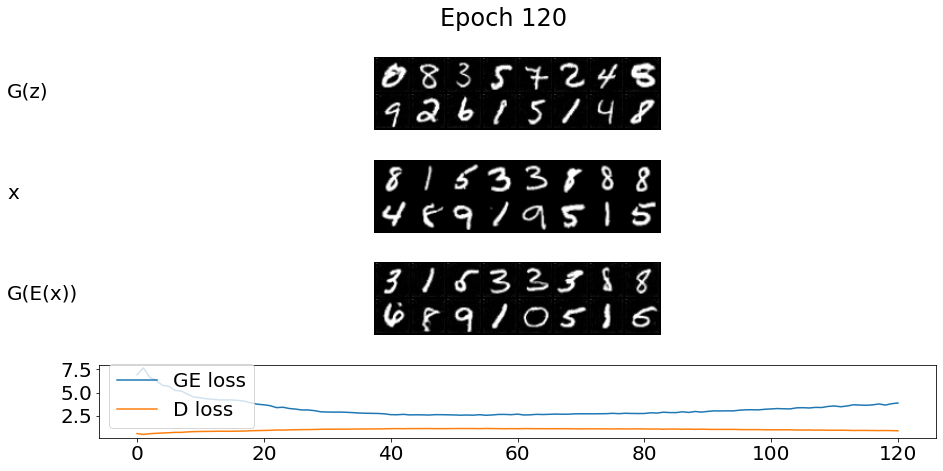

  0%|          | 1/469 [00:00<00:53,  8.70it/s]


Training... Epoch: 120, Discrimiantor Loss: 0.848, Generator Loss: 3.863


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


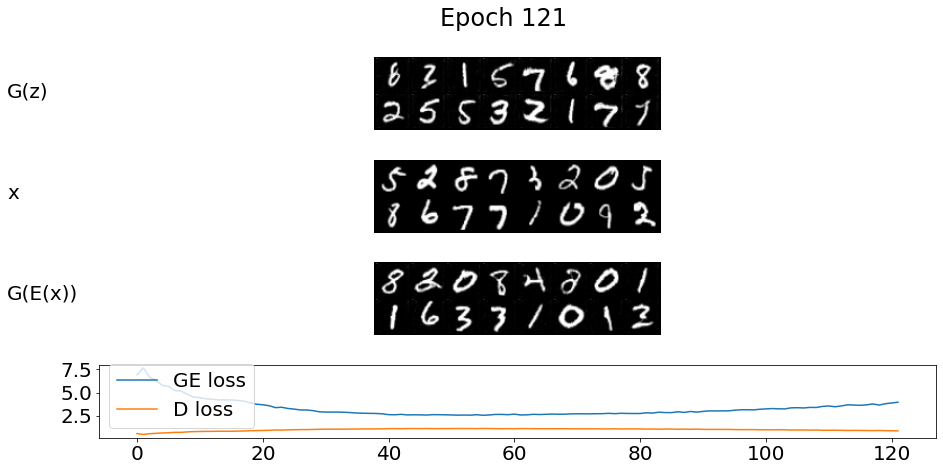

  0%|          | 1/469 [00:00<00:49,  9.55it/s]


Training... Epoch: 121, Discrimiantor Loss: 0.838, Generator Loss: 3.946


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


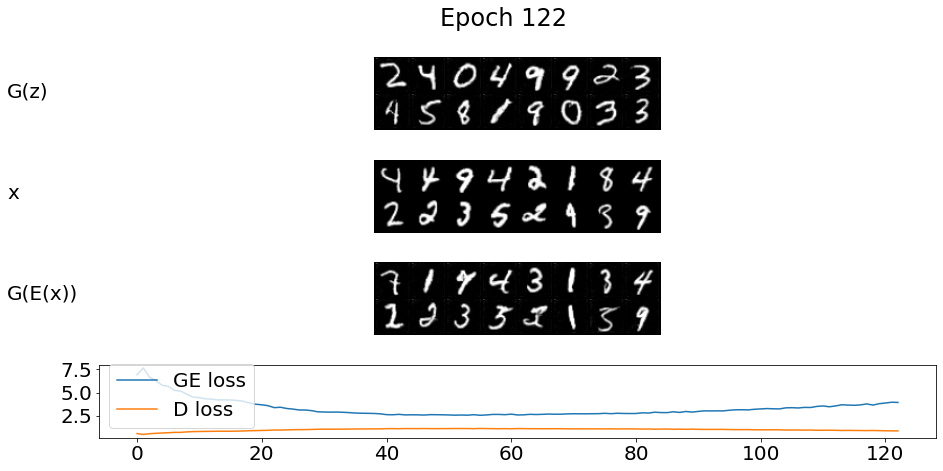

  0%|          | 1/469 [00:00<00:48,  9.61it/s]


Training... Epoch: 122, Discrimiantor Loss: 0.833, Generator Loss: 3.923


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


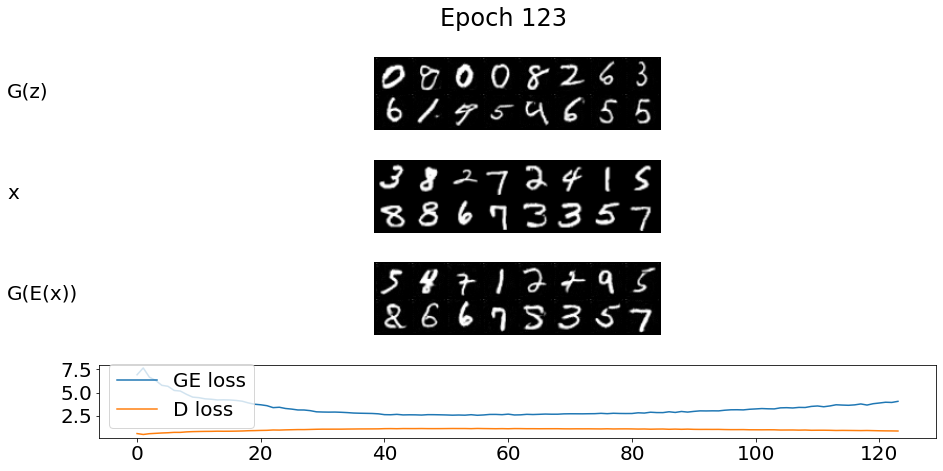

  0%|          | 1/469 [00:00<00:47,  9.80it/s]


Training... Epoch: 123, Discrimiantor Loss: 0.822, Generator Loss: 4.043


100%|██████████| 469/469 [01:00<00:00,  7.74it/s]


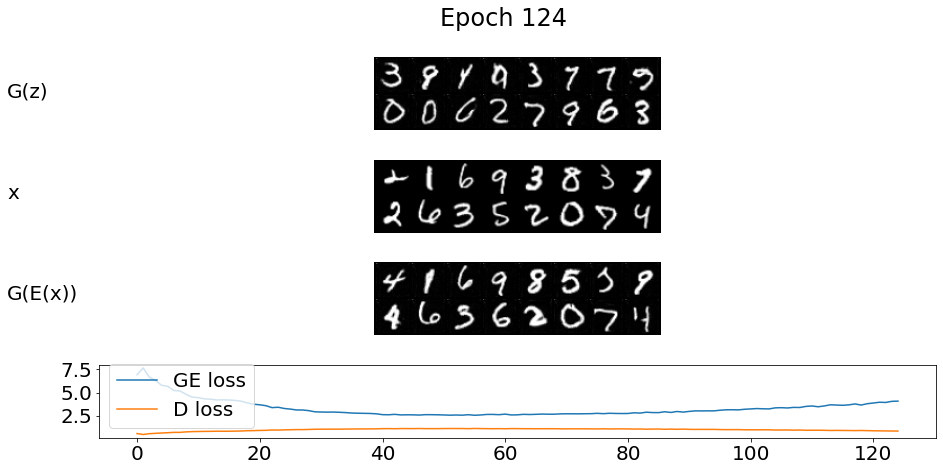

  0%|          | 1/469 [00:00<00:51,  9.09it/s]


Training... Epoch: 124, Discrimiantor Loss: 0.816, Generator Loss: 4.067


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


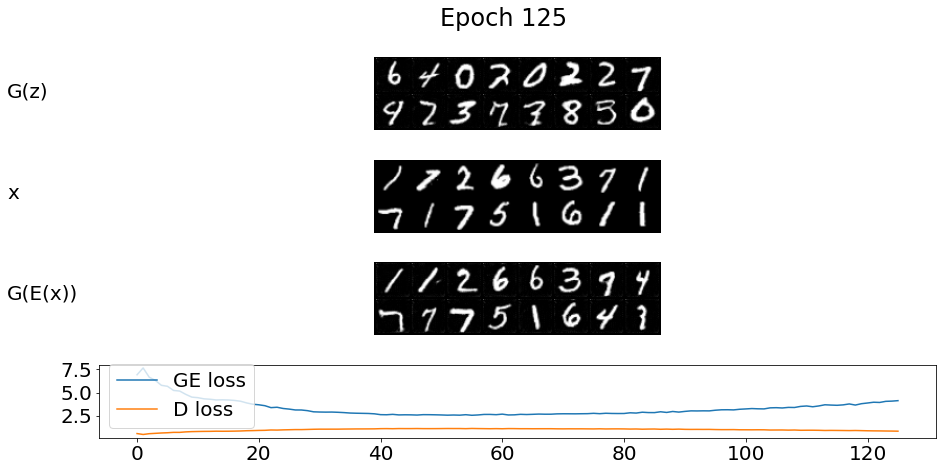

  0%|          | 1/469 [00:00<00:52,  8.91it/s]


Training... Epoch: 125, Discrimiantor Loss: 0.803, Generator Loss: 4.117


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


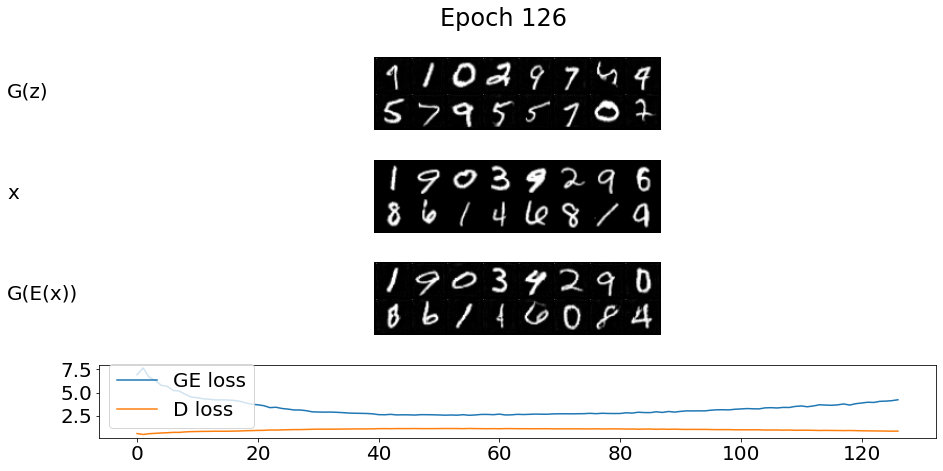

  0%|          | 1/469 [00:00<00:49,  9.51it/s]


Training... Epoch: 126, Discrimiantor Loss: 0.810, Generator Loss: 4.215


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


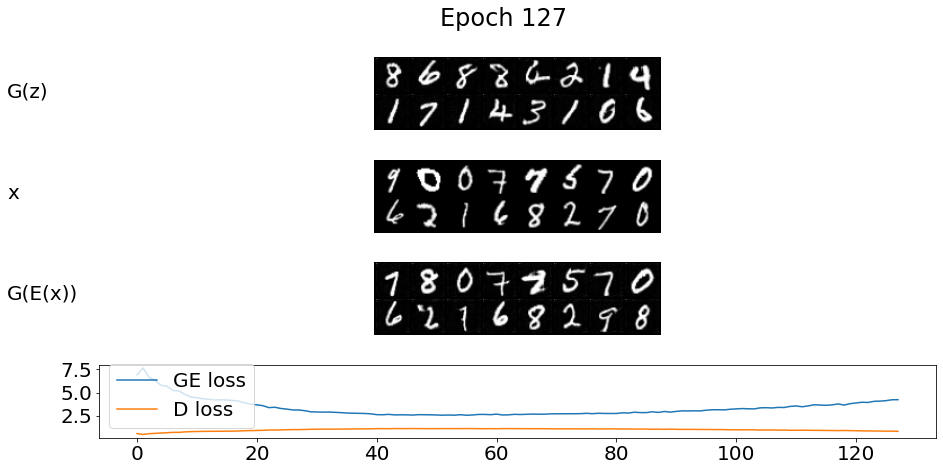

  0%|          | 1/469 [00:00<00:48,  9.66it/s]


Training... Epoch: 127, Discrimiantor Loss: 0.786, Generator Loss: 4.222


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


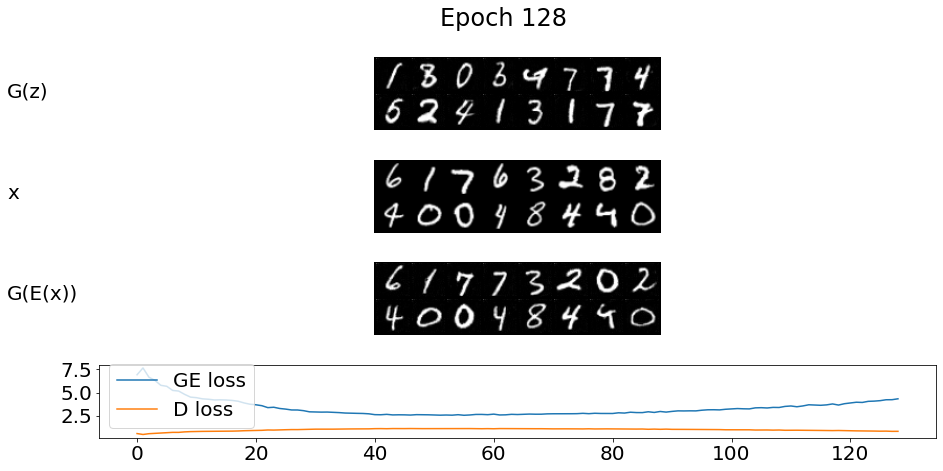

  0%|          | 1/469 [00:00<00:52,  8.97it/s]


Training... Epoch: 128, Discrimiantor Loss: 0.788, Generator Loss: 4.319


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


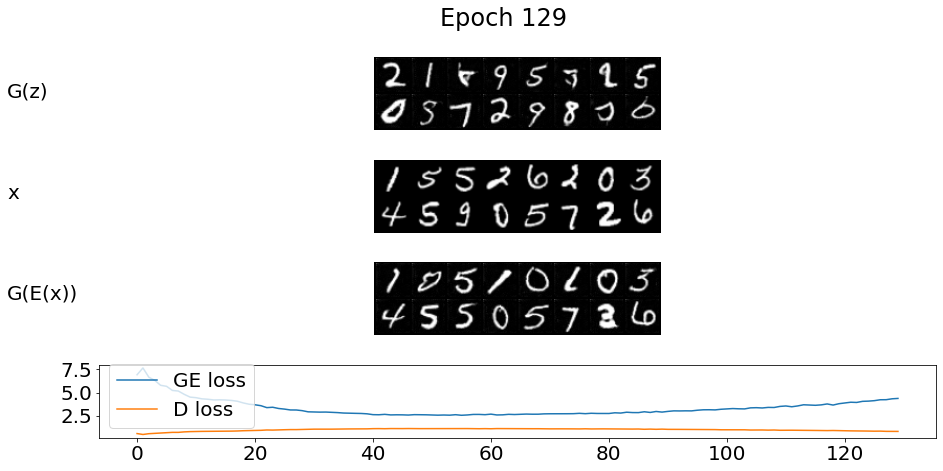

  0%|          | 1/469 [00:00<00:48,  9.59it/s]


Training... Epoch: 129, Discrimiantor Loss: 0.779, Generator Loss: 4.360


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


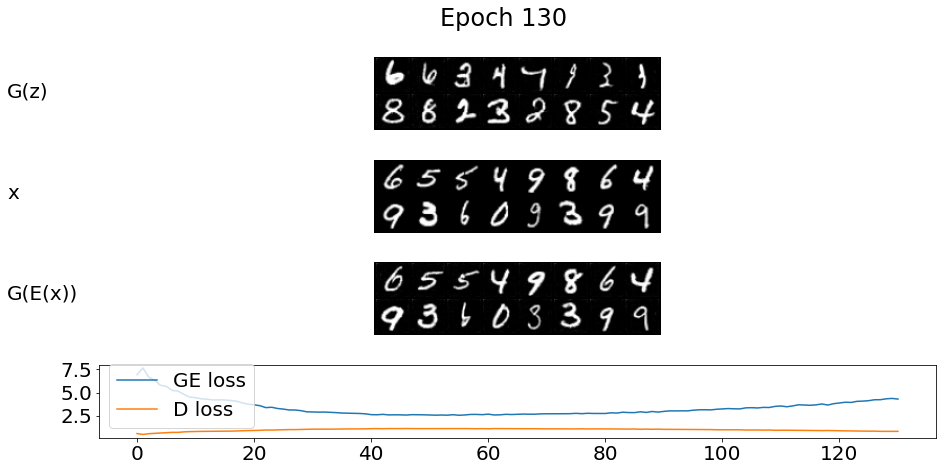

  0%|          | 1/469 [00:00<00:48,  9.72it/s]


Training... Epoch: 130, Discrimiantor Loss: 0.784, Generator Loss: 4.291


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


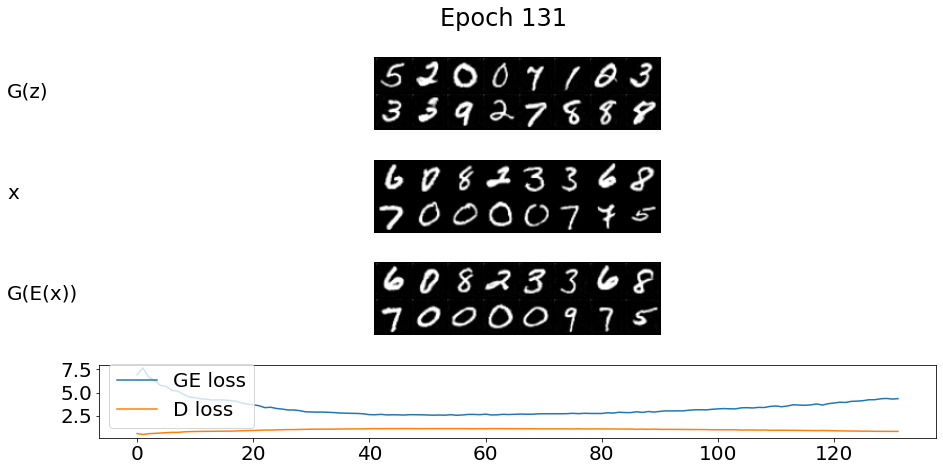

  0%|          | 1/469 [00:00<00:54,  8.62it/s]


Training... Epoch: 131, Discrimiantor Loss: 0.777, Generator Loss: 4.338


100%|██████████| 469/469 [01:00<00:00,  7.70it/s]


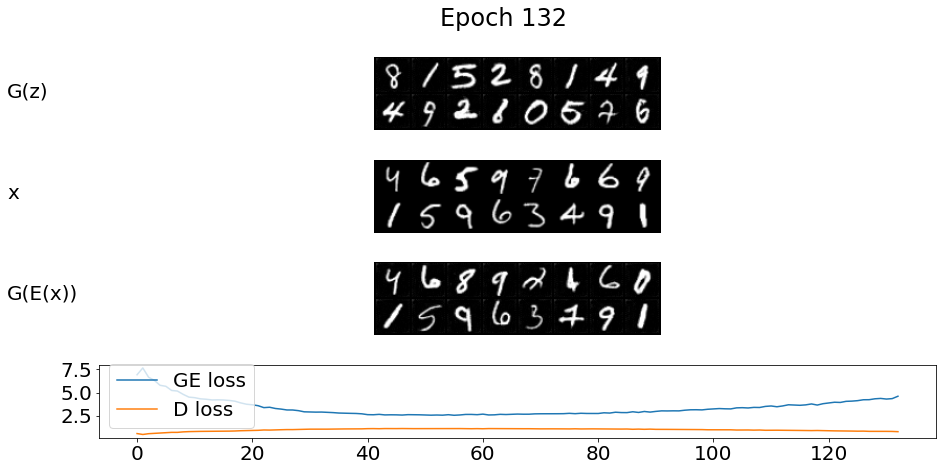

  0%|          | 1/469 [00:00<00:49,  9.44it/s]


Training... Epoch: 132, Discrimiantor Loss: 0.750, Generator Loss: 4.597


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


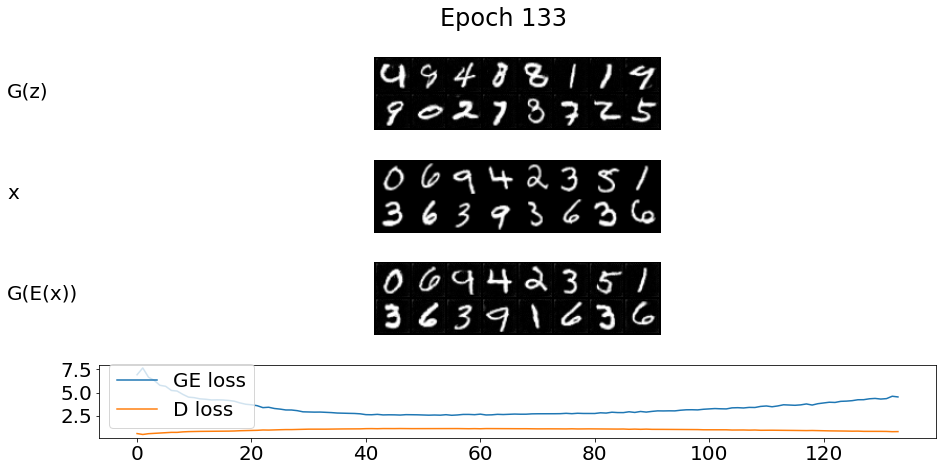

  0%|          | 1/469 [00:00<00:49,  9.50it/s]


Training... Epoch: 133, Discrimiantor Loss: 0.758, Generator Loss: 4.521


100%|██████████| 469/469 [01:00<00:00,  7.74it/s]


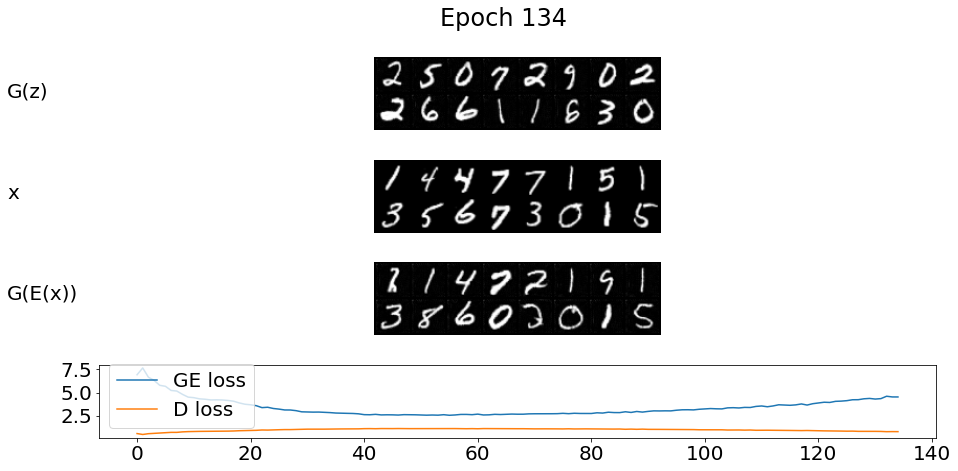

  0%|          | 1/469 [00:00<00:48,  9.60it/s]


Training... Epoch: 134, Discrimiantor Loss: 0.753, Generator Loss: 4.519


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


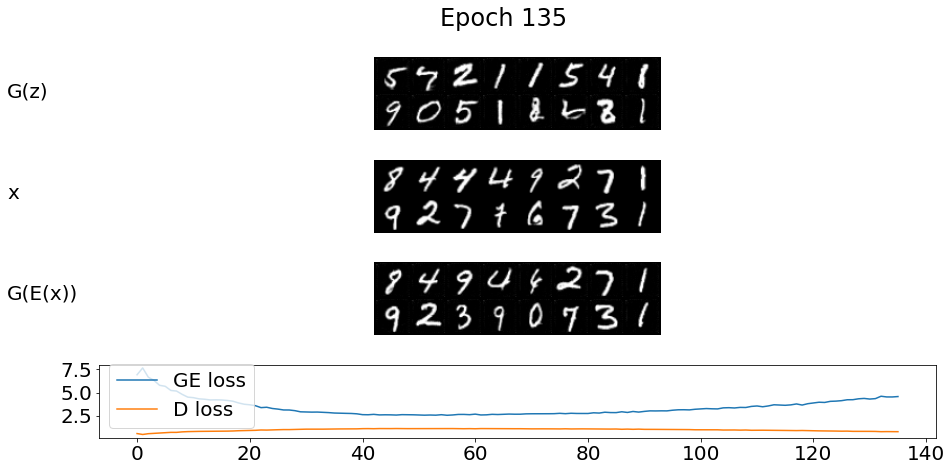

  0%|          | 1/469 [00:00<00:50,  9.35it/s]


Training... Epoch: 135, Discrimiantor Loss: 0.748, Generator Loss: 4.563


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


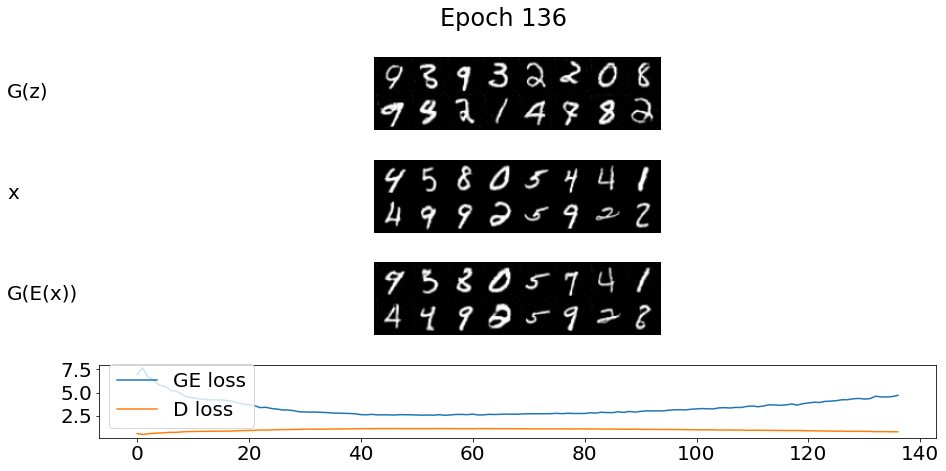

  0%|          | 1/469 [00:00<00:48,  9.56it/s]


Training... Epoch: 136, Discrimiantor Loss: 0.734, Generator Loss: 4.695


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


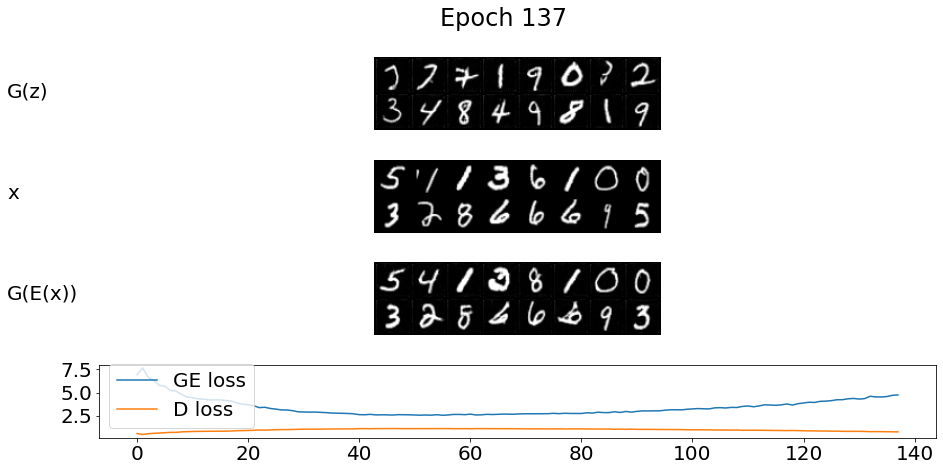

  0%|          | 1/469 [00:00<00:47,  9.75it/s]


Training... Epoch: 137, Discrimiantor Loss: 0.728, Generator Loss: 4.737


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


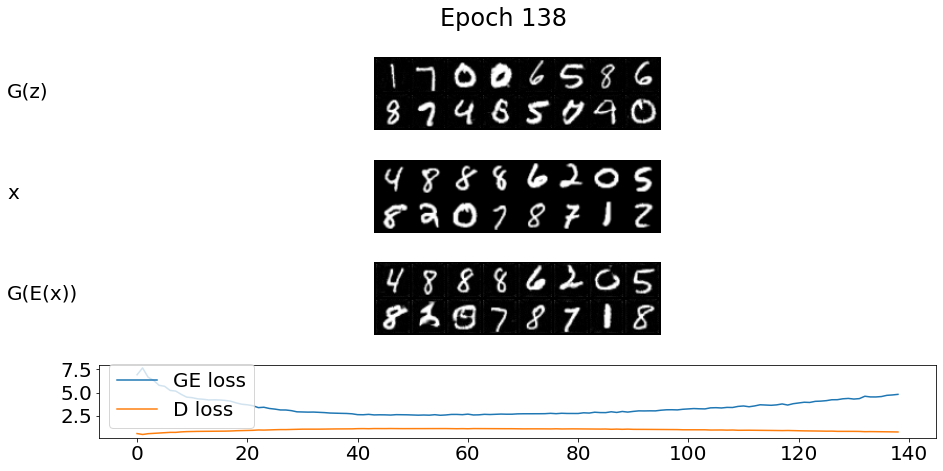

  0%|          | 1/469 [00:00<00:50,  9.34it/s]


Training... Epoch: 138, Discrimiantor Loss: 0.717, Generator Loss: 4.800


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


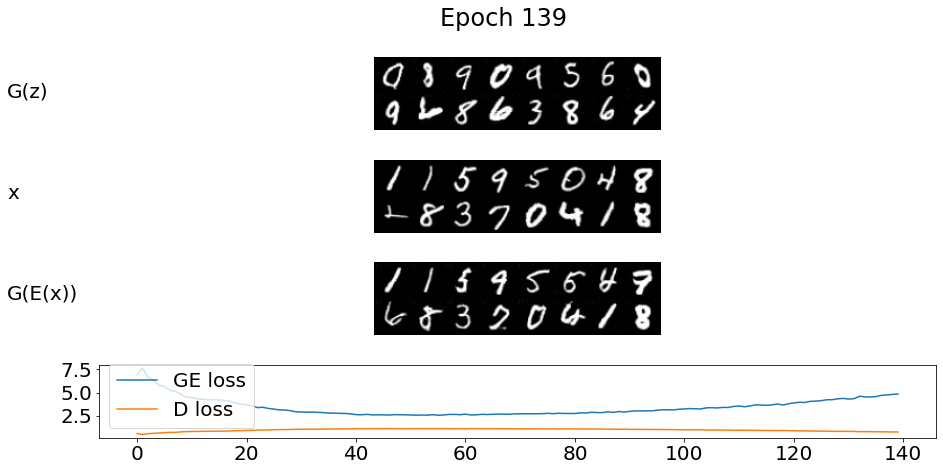

  0%|          | 1/469 [00:00<00:49,  9.46it/s]


Training... Epoch: 139, Discrimiantor Loss: 0.715, Generator Loss: 4.832


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


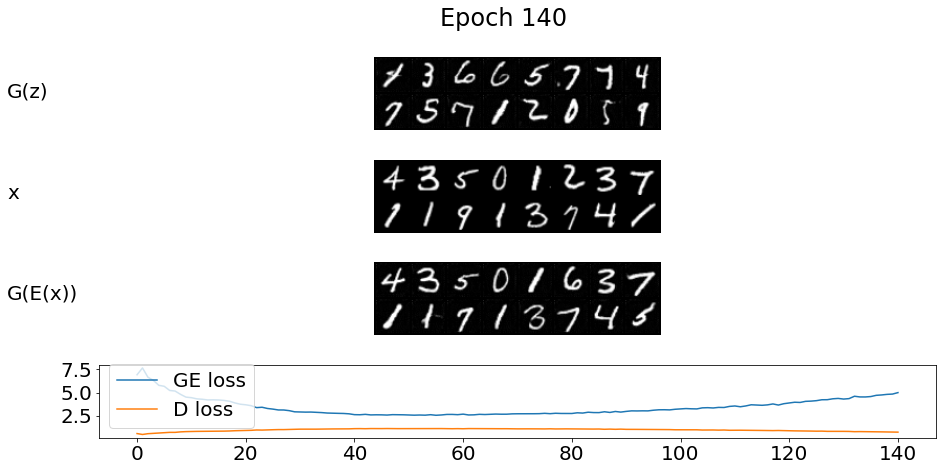

  0%|          | 1/469 [00:00<00:51,  9.14it/s]


Training... Epoch: 140, Discrimiantor Loss: 0.699, Generator Loss: 4.990


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


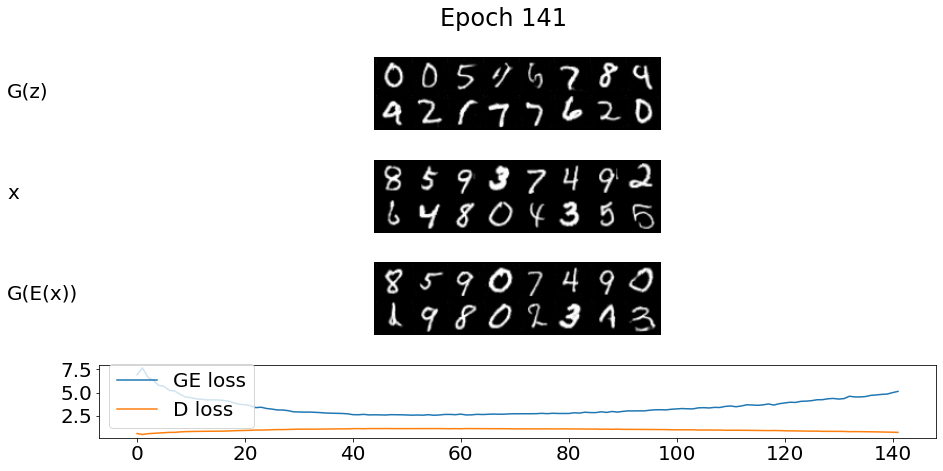

  0%|          | 1/469 [00:00<00:51,  9.10it/s]


Training... Epoch: 141, Discrimiantor Loss: 0.679, Generator Loss: 5.124


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


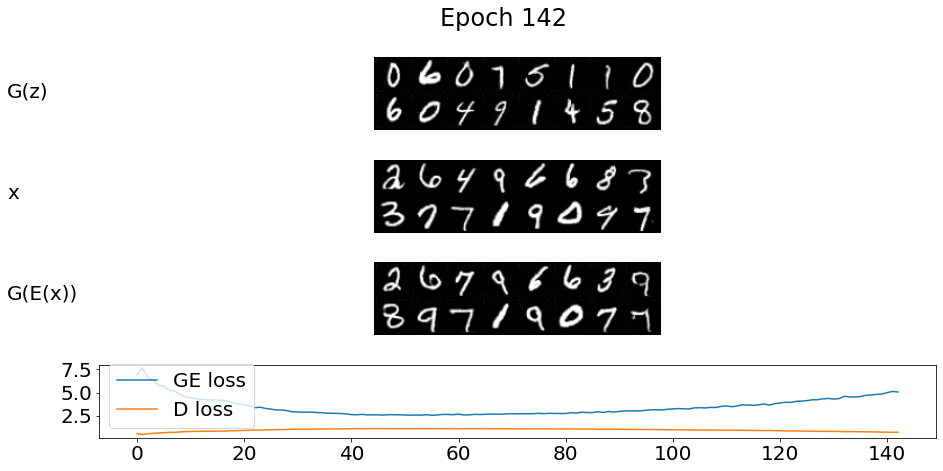

  0%|          | 1/469 [00:00<00:48,  9.59it/s]


Training... Epoch: 142, Discrimiantor Loss: 0.695, Generator Loss: 5.051


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


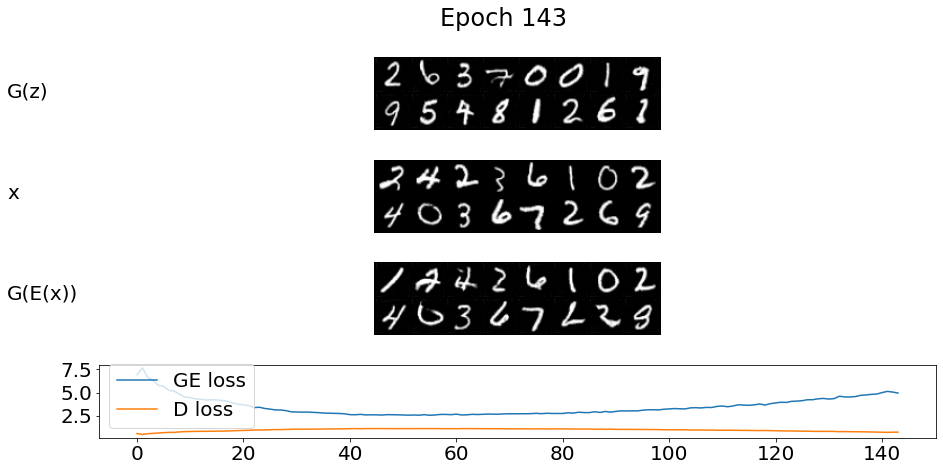

  0%|          | 1/469 [00:00<00:48,  9.66it/s]


Training... Epoch: 143, Discrimiantor Loss: 0.702, Generator Loss: 4.944


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


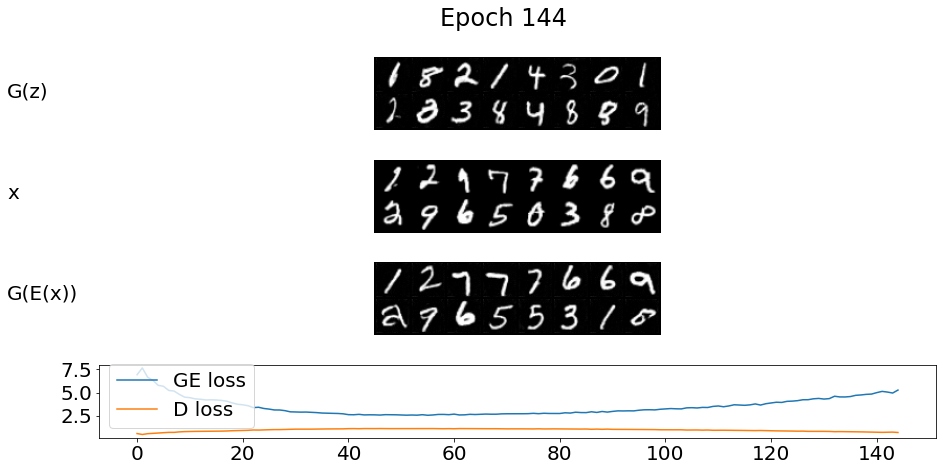

  0%|          | 1/469 [00:00<00:48,  9.56it/s]


Training... Epoch: 144, Discrimiantor Loss: 0.663, Generator Loss: 5.266


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


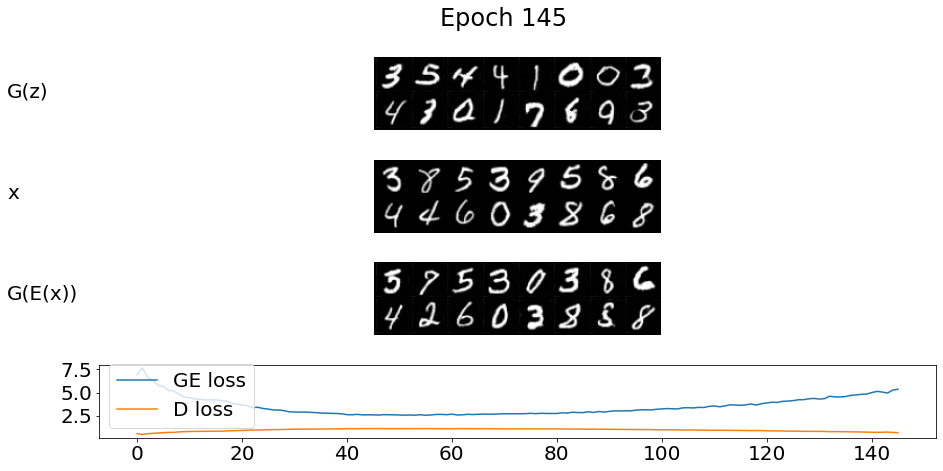

  0%|          | 1/469 [00:00<00:51,  9.14it/s]


Training... Epoch: 145, Discrimiantor Loss: 0.651, Generator Loss: 5.360


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


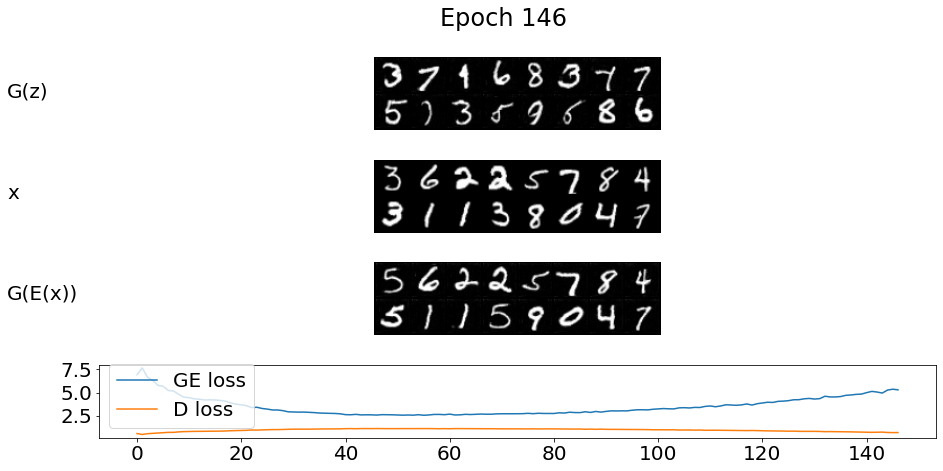

  0%|          | 1/469 [00:00<00:57,  8.15it/s]


Training... Epoch: 146, Discrimiantor Loss: 0.657, Generator Loss: 5.293


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


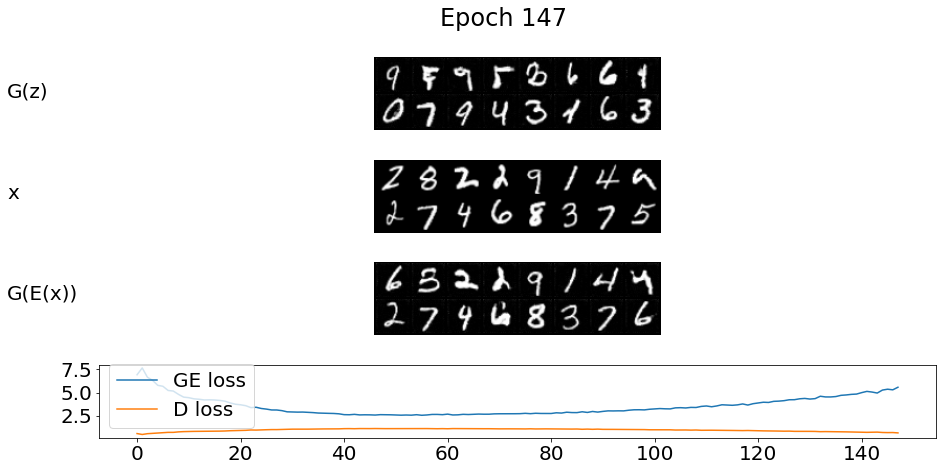

  0%|          | 1/469 [00:00<00:51,  9.15it/s]


Training... Epoch: 147, Discrimiantor Loss: 0.618, Generator Loss: 5.573


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


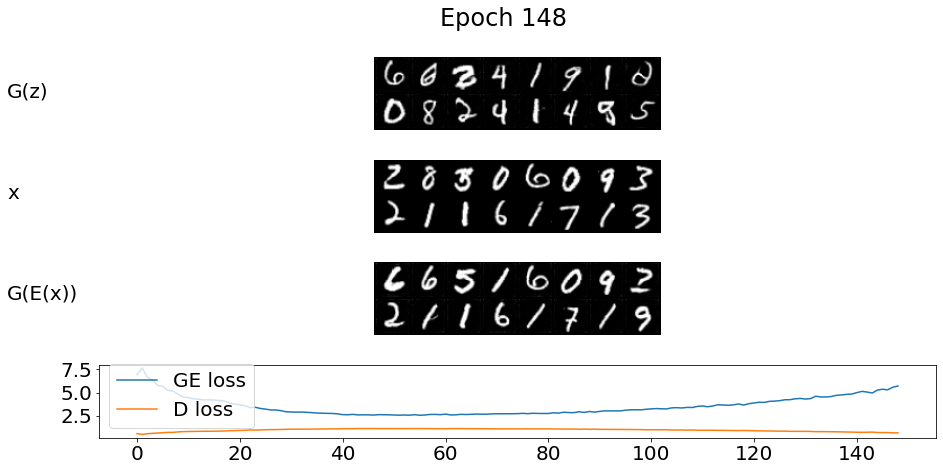

  0%|          | 1/469 [00:00<00:50,  9.31it/s]


Training... Epoch: 148, Discrimiantor Loss: 0.625, Generator Loss: 5.711


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


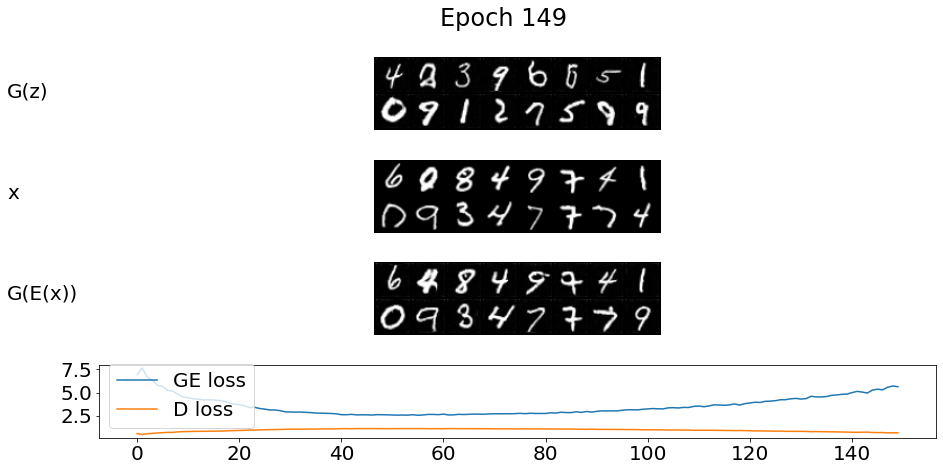

  0%|          | 1/469 [00:00<00:52,  8.91it/s]


Training... Epoch: 149, Discrimiantor Loss: 0.627, Generator Loss: 5.629


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


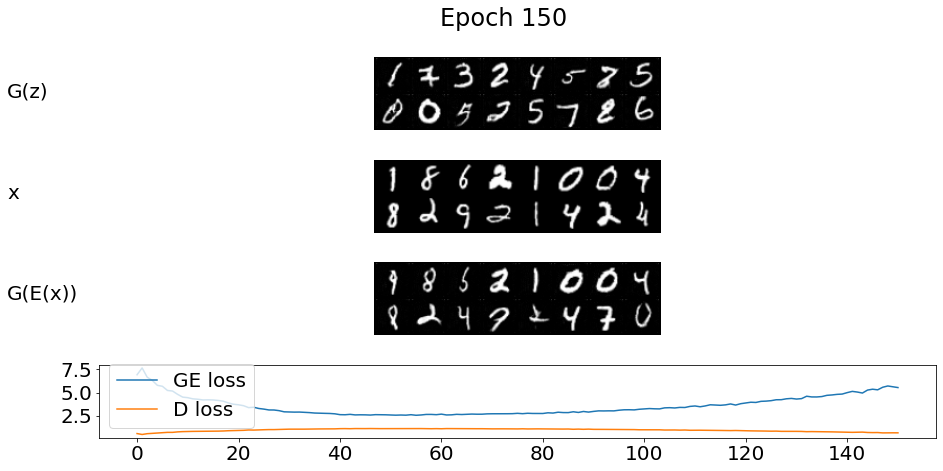

  0%|          | 1/469 [00:00<00:48,  9.56it/s]


Training... Epoch: 150, Discrimiantor Loss: 0.624, Generator Loss: 5.538


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


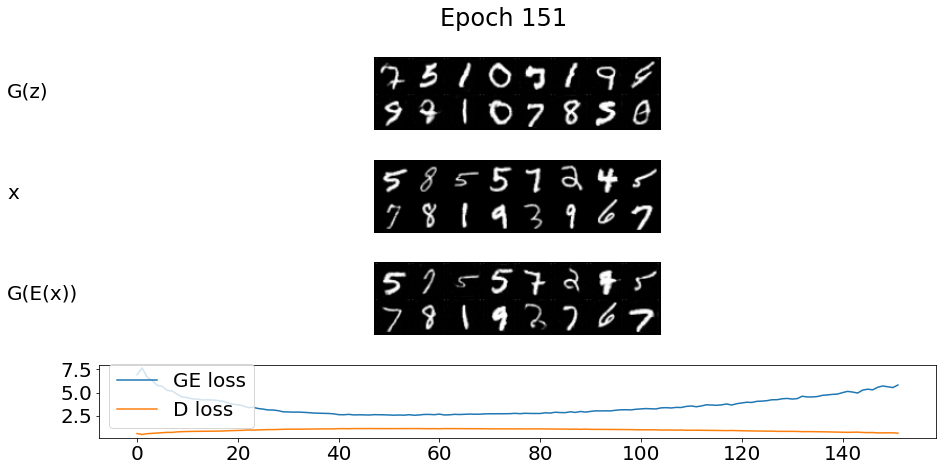

  0%|          | 1/469 [00:00<00:51,  9.12it/s]


Training... Epoch: 151, Discrimiantor Loss: 0.588, Generator Loss: 5.817


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


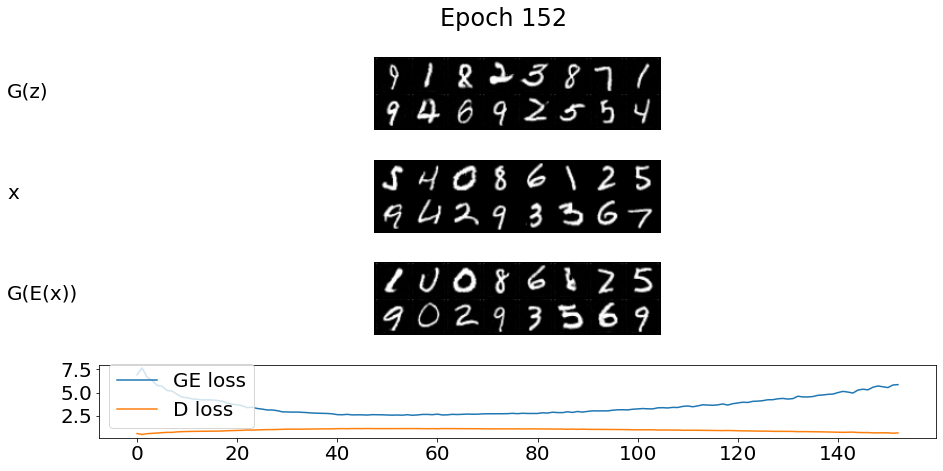

  0%|          | 1/469 [00:00<00:49,  9.40it/s]


Training... Epoch: 152, Discrimiantor Loss: 0.609, Generator Loss: 5.856


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


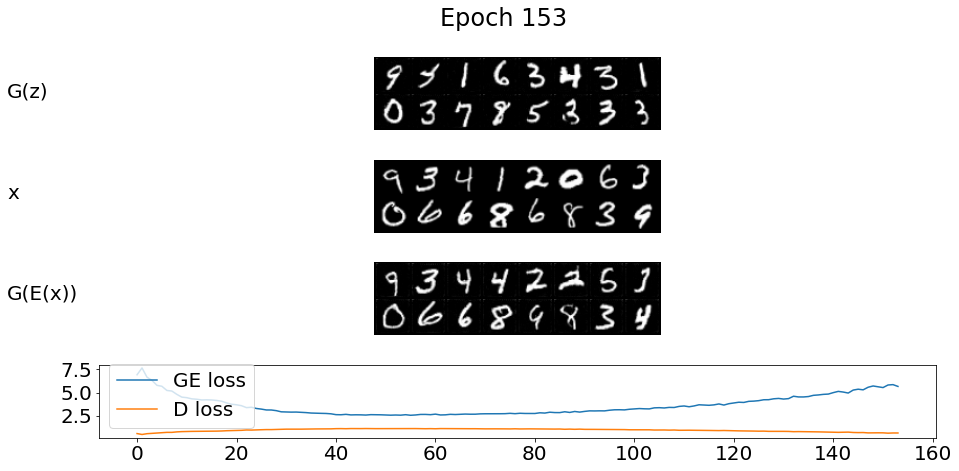

  0%|          | 1/469 [00:00<00:49,  9.45it/s]


Training... Epoch: 153, Discrimiantor Loss: 0.608, Generator Loss: 5.662


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


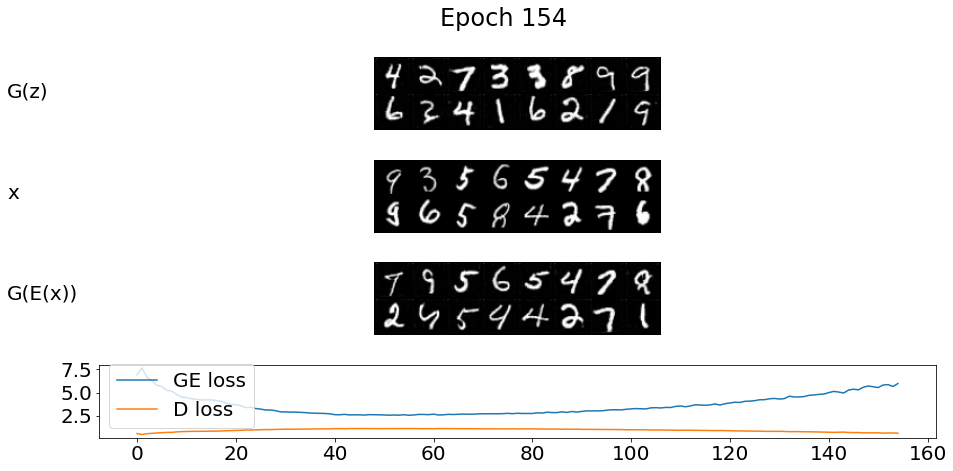

  0%|          | 1/469 [00:00<00:48,  9.60it/s]


Training... Epoch: 154, Discrimiantor Loss: 0.582, Generator Loss: 5.976


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


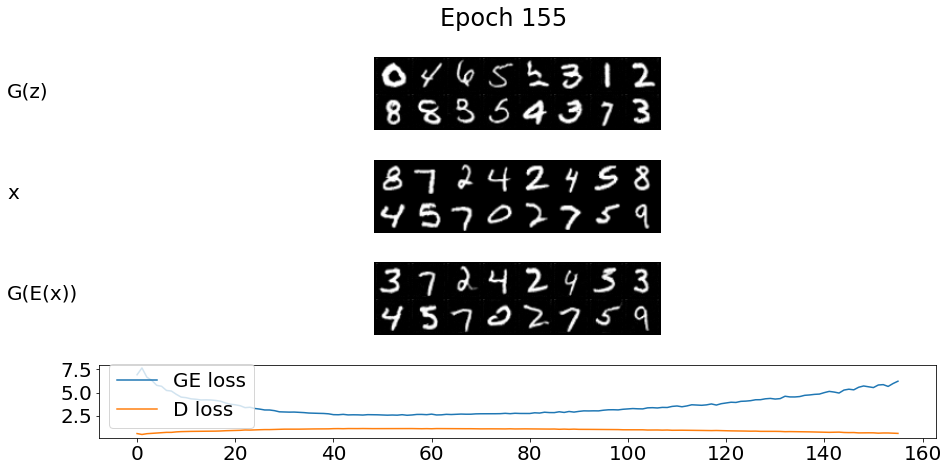

  0%|          | 1/469 [00:00<00:47,  9.76it/s]


Training... Epoch: 155, Discrimiantor Loss: 0.564, Generator Loss: 6.229


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


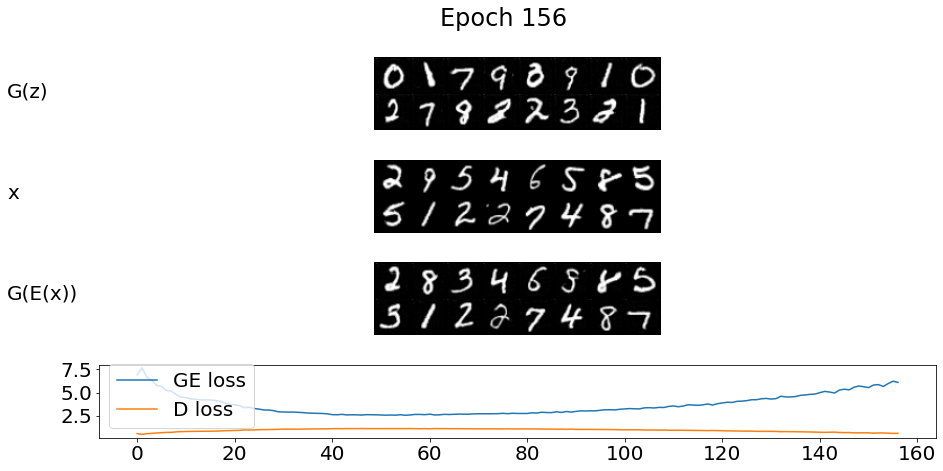

  0%|          | 1/469 [00:00<00:48,  9.58it/s]


Training... Epoch: 156, Discrimiantor Loss: 0.570, Generator Loss: 6.096


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


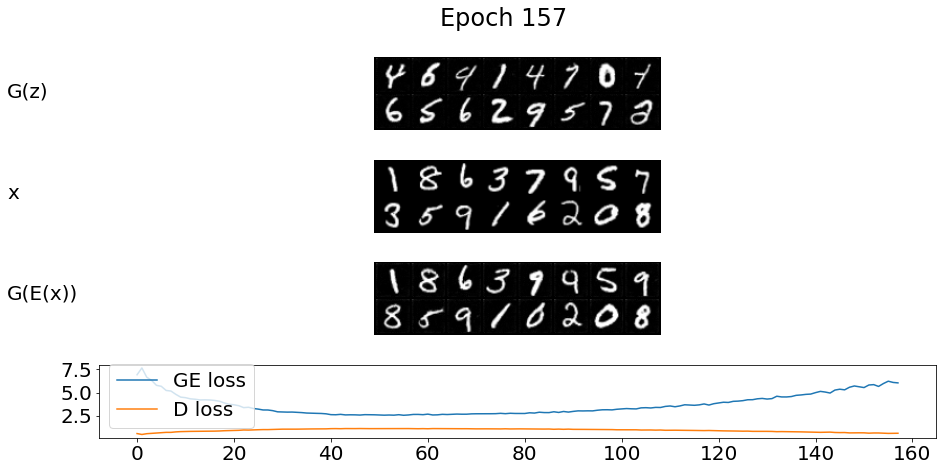

  0%|          | 1/469 [00:00<00:50,  9.23it/s]


Training... Epoch: 157, Discrimiantor Loss: 0.579, Generator Loss: 6.046


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


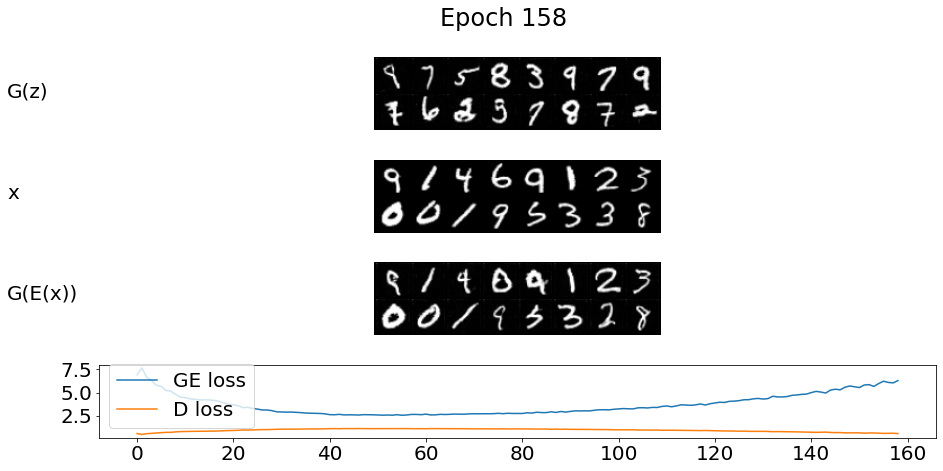

  0%|          | 1/469 [00:00<00:51,  9.03it/s]


Training... Epoch: 158, Discrimiantor Loss: 0.540, Generator Loss: 6.297


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


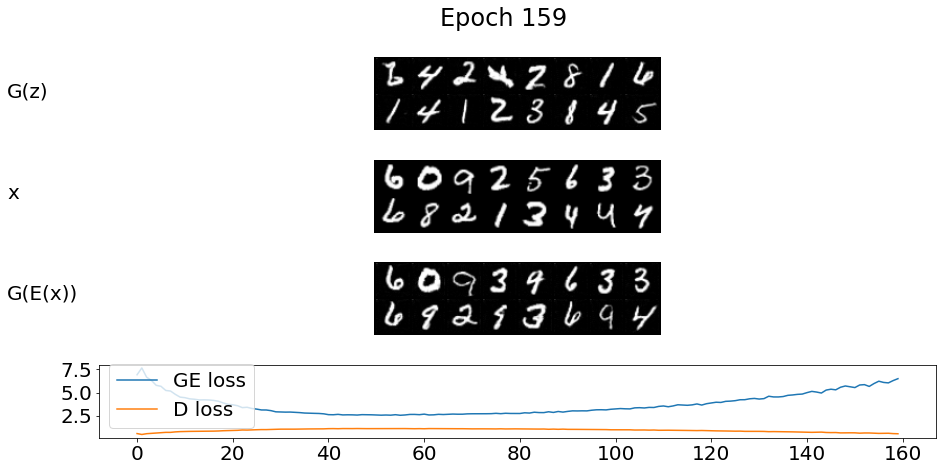

  0%|          | 1/469 [00:00<00:49,  9.45it/s]


Training... Epoch: 159, Discrimiantor Loss: 0.525, Generator Loss: 6.504


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


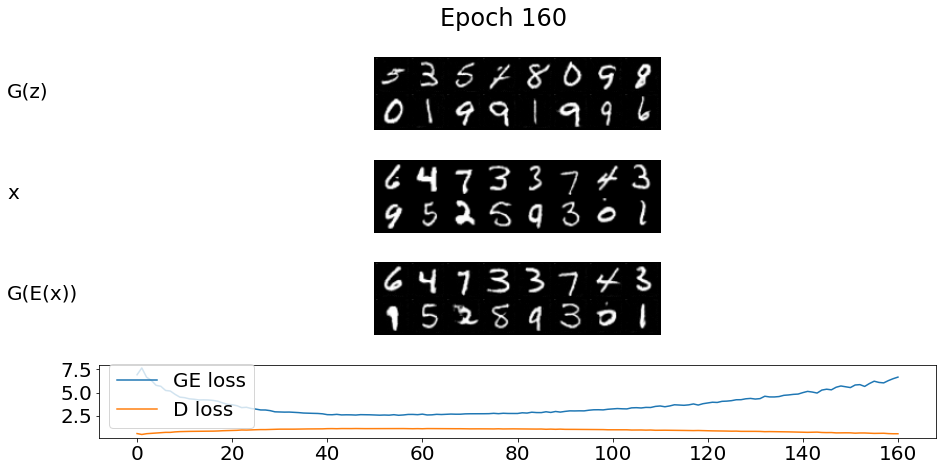

  0%|          | 1/469 [00:00<00:49,  9.44it/s]


Training... Epoch: 160, Discrimiantor Loss: 0.525, Generator Loss: 6.673


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


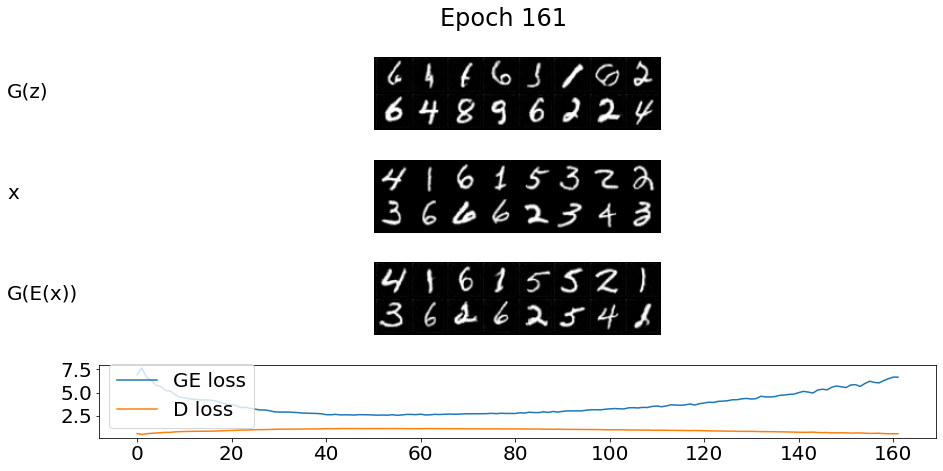

  0%|          | 1/469 [00:00<00:48,  9.57it/s]


Training... Epoch: 161, Discrimiantor Loss: 0.524, Generator Loss: 6.671


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


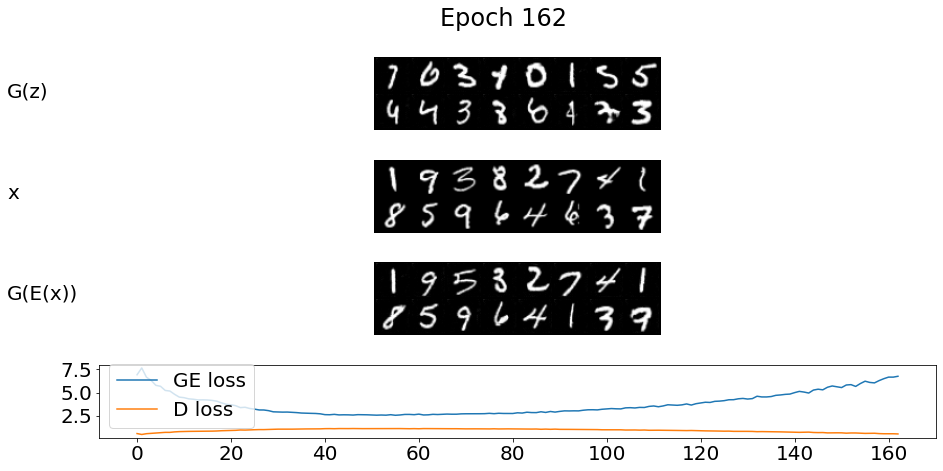

  0%|          | 1/469 [00:00<00:49,  9.53it/s]


Training... Epoch: 162, Discrimiantor Loss: 0.504, Generator Loss: 6.764


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


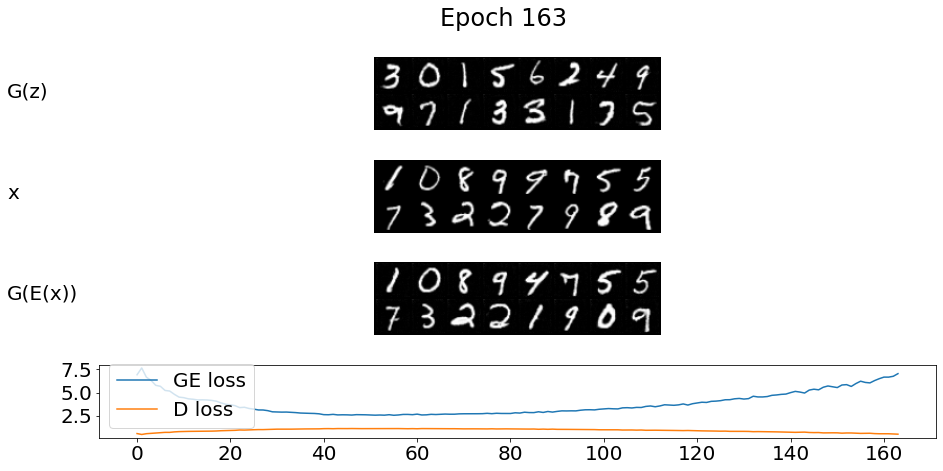

  0%|          | 1/469 [00:00<00:48,  9.59it/s]


Training... Epoch: 163, Discrimiantor Loss: 0.478, Generator Loss: 7.049


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


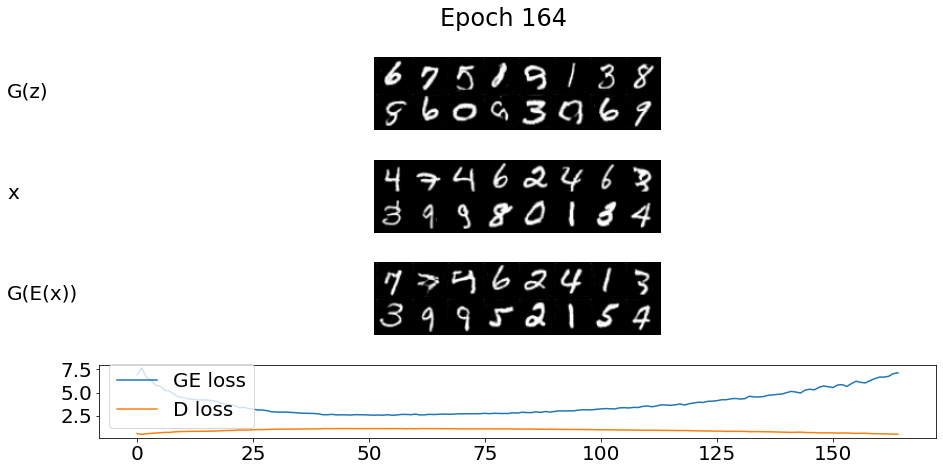

  0%|          | 1/469 [00:00<00:51,  9.15it/s]


Training... Epoch: 164, Discrimiantor Loss: 0.478, Generator Loss: 7.143


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


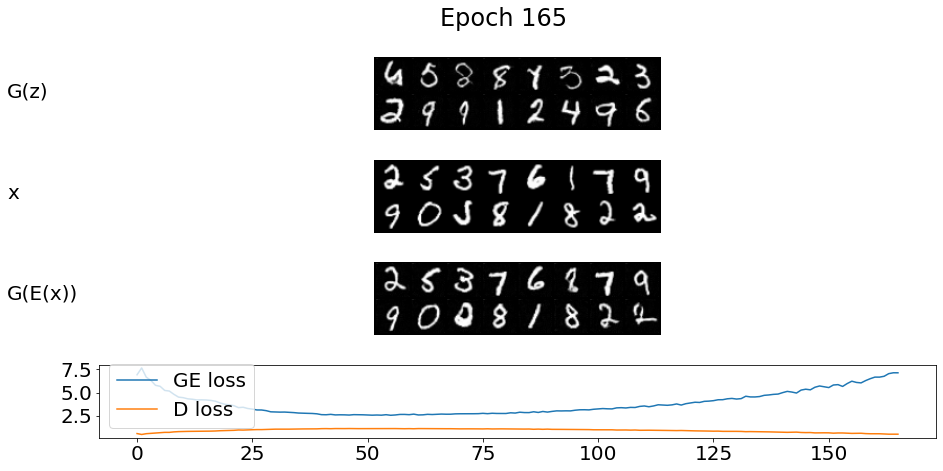

  0%|          | 1/469 [00:00<00:48,  9.57it/s]


Training... Epoch: 165, Discrimiantor Loss: 0.477, Generator Loss: 7.141


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


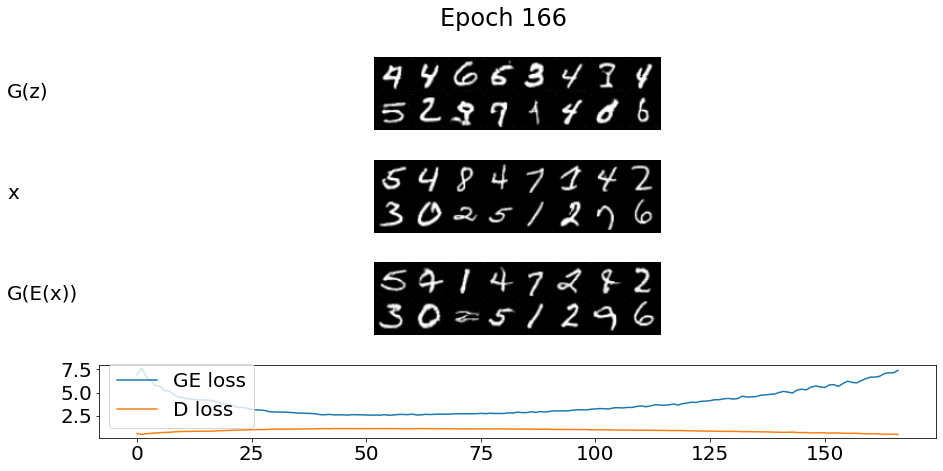

  0%|          | 1/469 [00:00<00:48,  9.69it/s]


Training... Epoch: 166, Discrimiantor Loss: 0.457, Generator Loss: 7.397


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


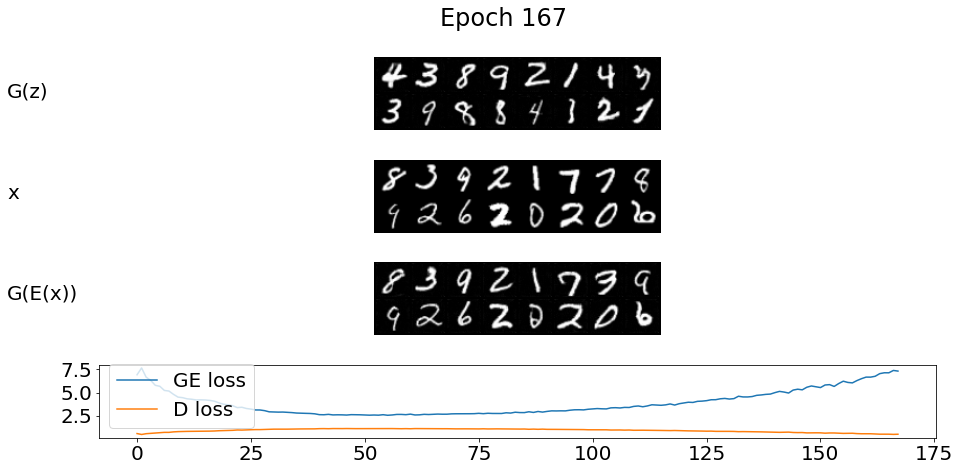

  0%|          | 1/469 [00:00<00:53,  8.73it/s]


Training... Epoch: 167, Discrimiantor Loss: 0.473, Generator Loss: 7.327


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


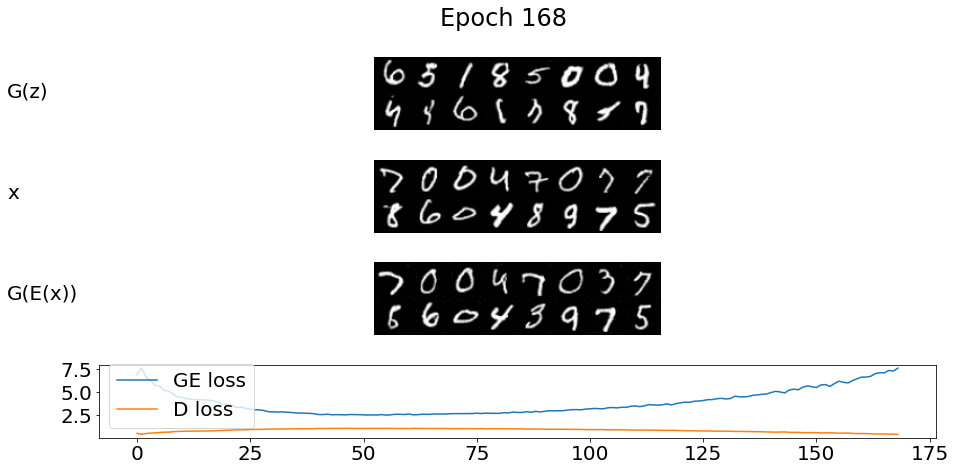

  0%|          | 1/469 [00:00<00:49,  9.44it/s]


Training... Epoch: 168, Discrimiantor Loss: 0.425, Generator Loss: 7.654


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


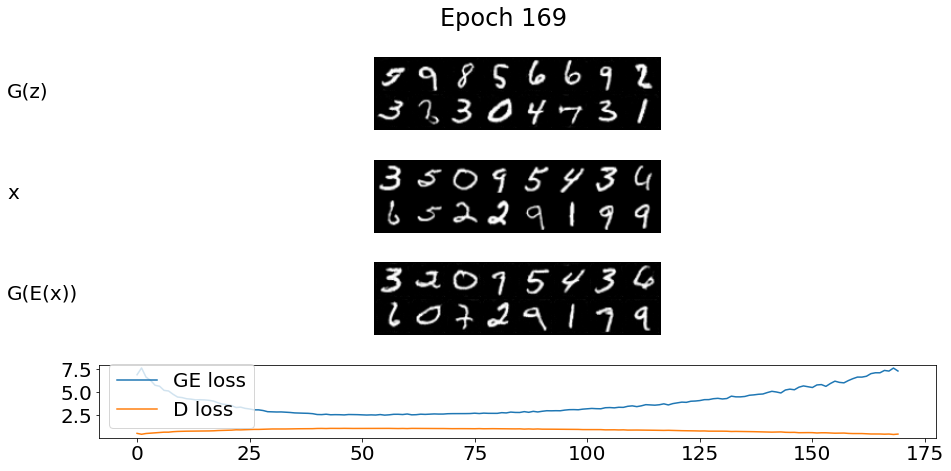

  0%|          | 1/469 [00:00<00:53,  8.81it/s]


Training... Epoch: 169, Discrimiantor Loss: 0.468, Generator Loss: 7.334


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


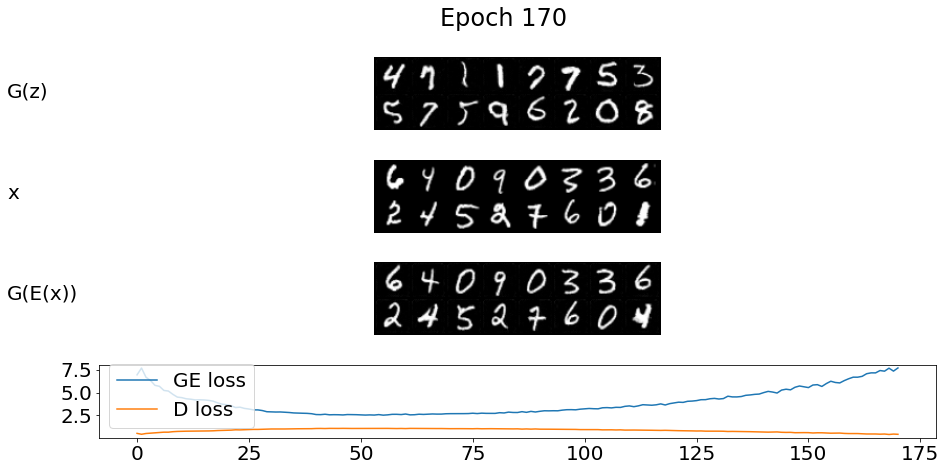

  0%|          | 1/469 [00:00<00:55,  8.42it/s]


Training... Epoch: 170, Discrimiantor Loss: 0.443, Generator Loss: 7.679


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


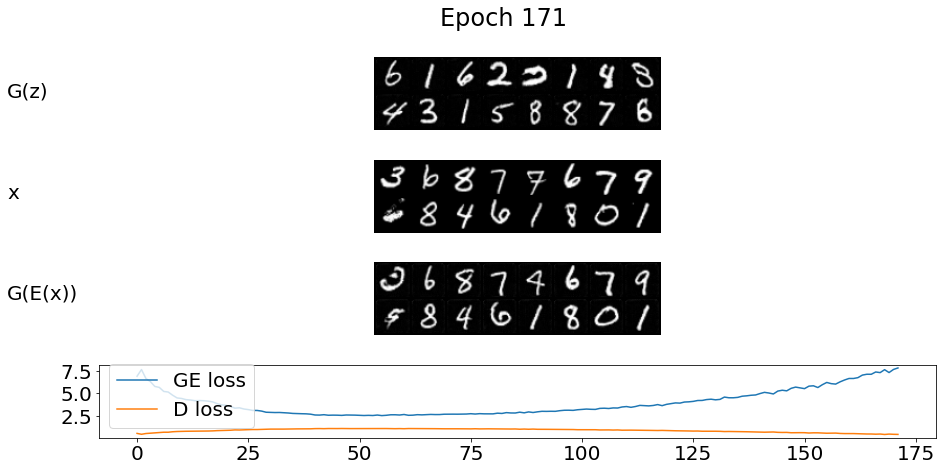

  0%|          | 1/469 [00:00<00:48,  9.64it/s]


Training... Epoch: 171, Discrimiantor Loss: 0.433, Generator Loss: 7.847


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


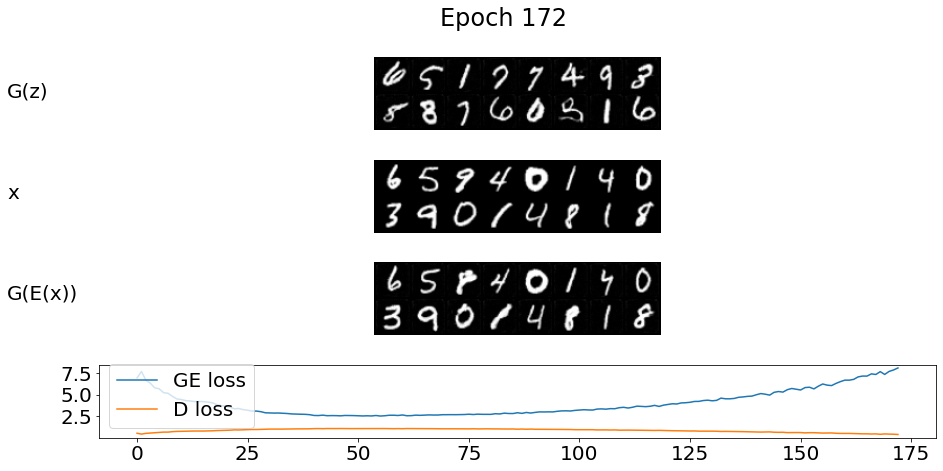

  0%|          | 1/469 [00:00<00:48,  9.57it/s]


Training... Epoch: 172, Discrimiantor Loss: 0.403, Generator Loss: 8.080


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


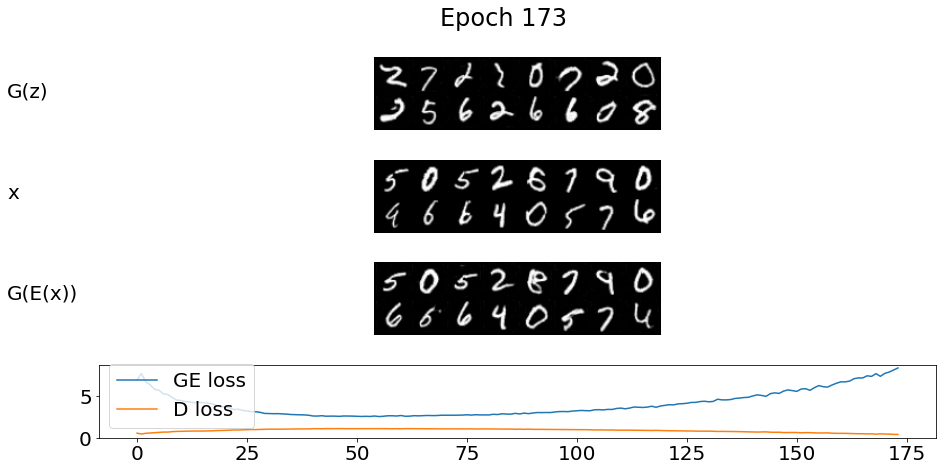

  0%|          | 1/469 [00:00<00:50,  9.22it/s]


Training... Epoch: 173, Discrimiantor Loss: 0.390, Generator Loss: 8.334


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


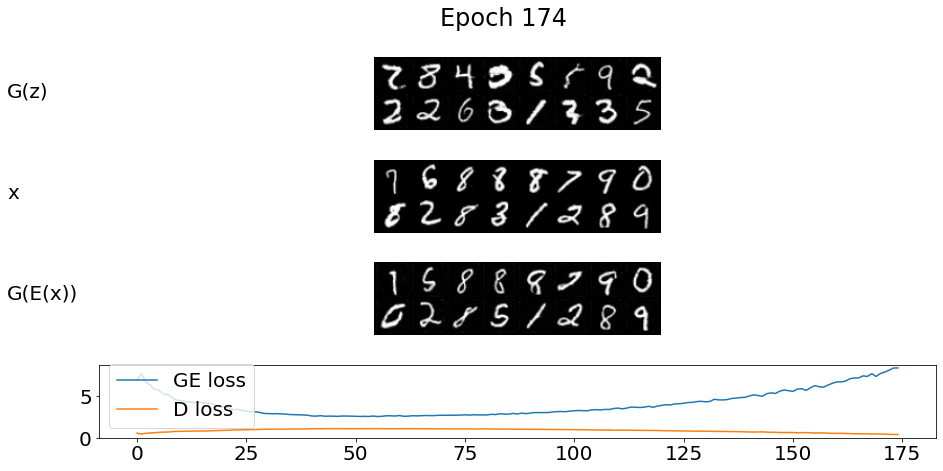

  0%|          | 1/469 [00:00<00:47,  9.77it/s]


Training... Epoch: 174, Discrimiantor Loss: 0.392, Generator Loss: 8.341


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


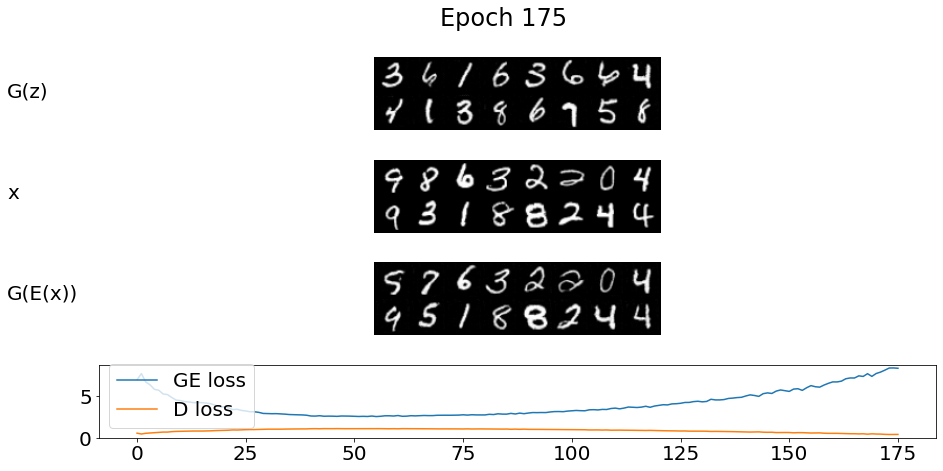

  0%|          | 1/469 [00:00<00:49,  9.49it/s]


Training... Epoch: 175, Discrimiantor Loss: 0.396, Generator Loss: 8.304


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


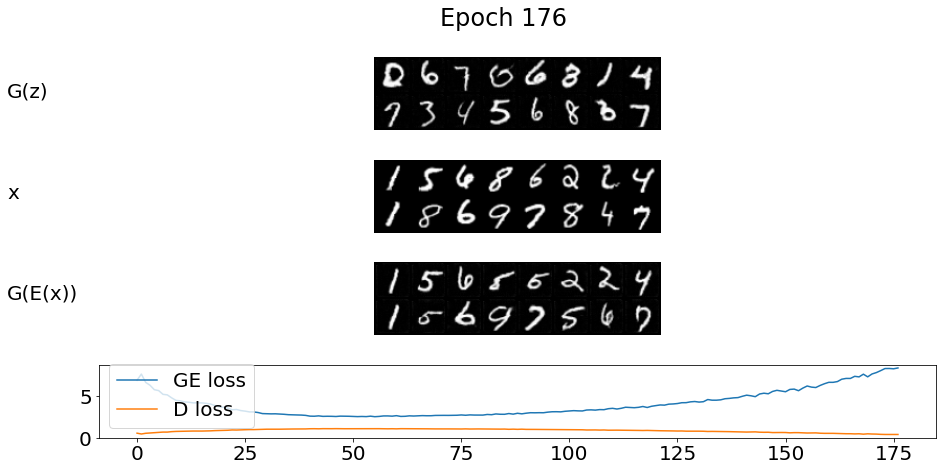

  0%|          | 1/469 [00:00<00:49,  9.49it/s]


Training... Epoch: 176, Discrimiantor Loss: 0.388, Generator Loss: 8.405


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


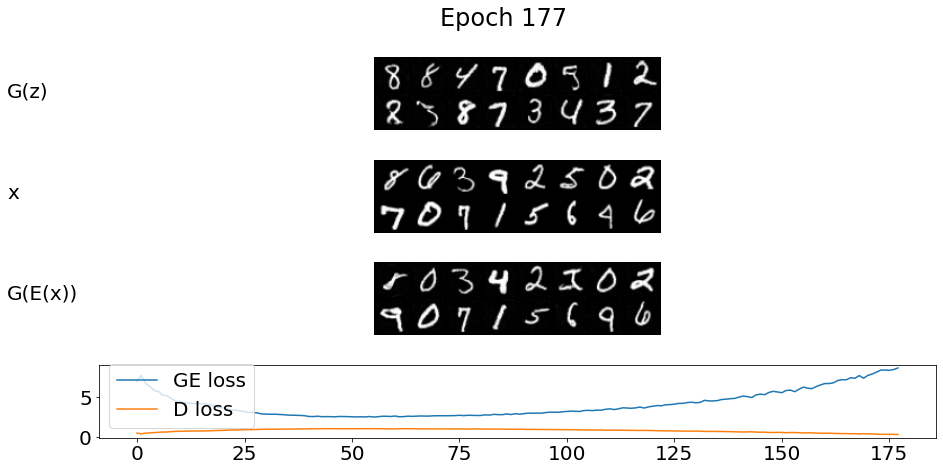

  0%|          | 1/469 [00:00<00:52,  8.98it/s]


Training... Epoch: 177, Discrimiantor Loss: 0.371, Generator Loss: 8.600


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


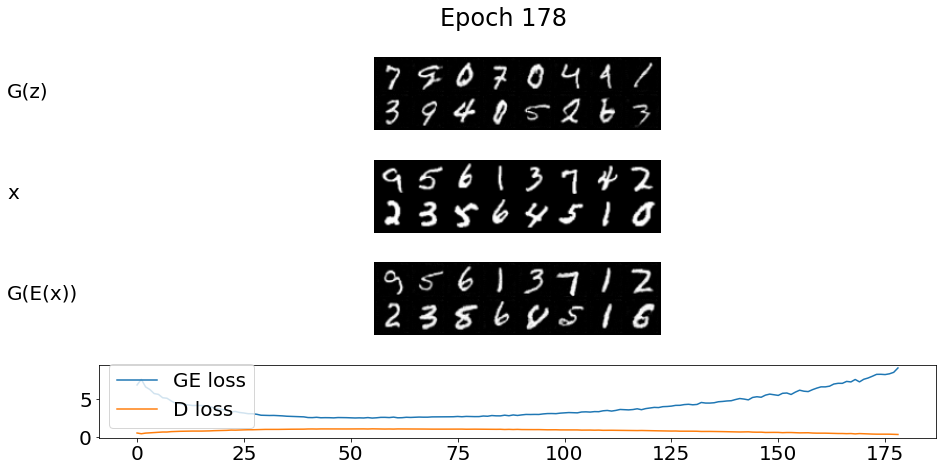

  0%|          | 1/469 [00:00<00:48,  9.57it/s]


Training... Epoch: 178, Discrimiantor Loss: 0.350, Generator Loss: 9.184


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


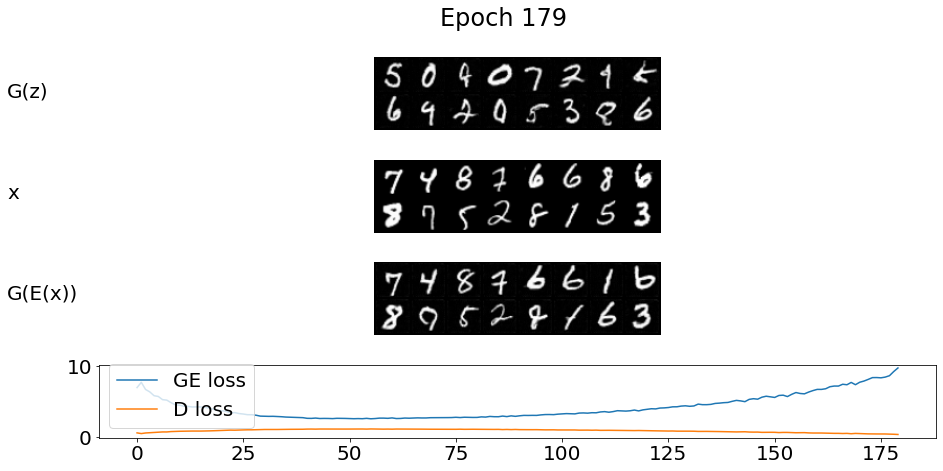

  0%|          | 1/469 [00:00<00:51,  9.11it/s]


Training... Epoch: 179, Discrimiantor Loss: 0.320, Generator Loss: 9.695


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


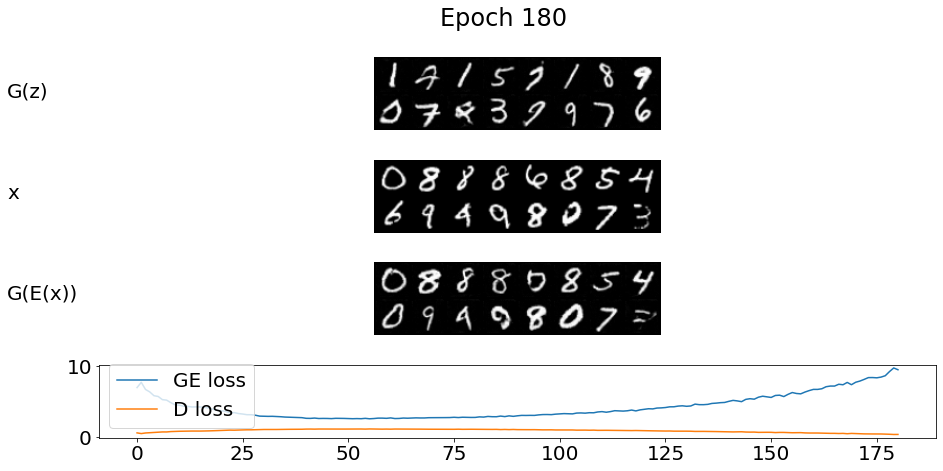

  0%|          | 1/469 [00:00<01:04,  7.22it/s]


Training... Epoch: 180, Discrimiantor Loss: 0.326, Generator Loss: 9.444


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


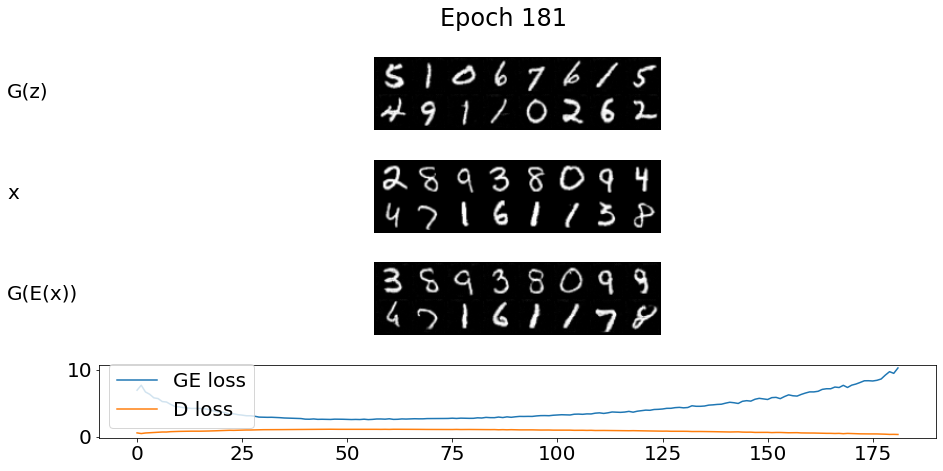

  0%|          | 1/469 [00:00<00:48,  9.64it/s]


Training... Epoch: 181, Discrimiantor Loss: 0.308, Generator Loss: 10.252


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


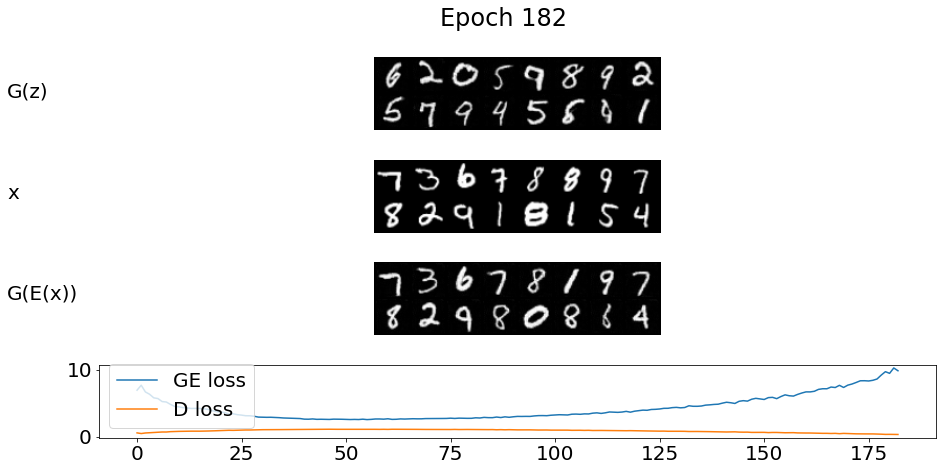

  0%|          | 1/469 [00:00<00:49,  9.52it/s]


Training... Epoch: 182, Discrimiantor Loss: 0.307, Generator Loss: 9.833


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


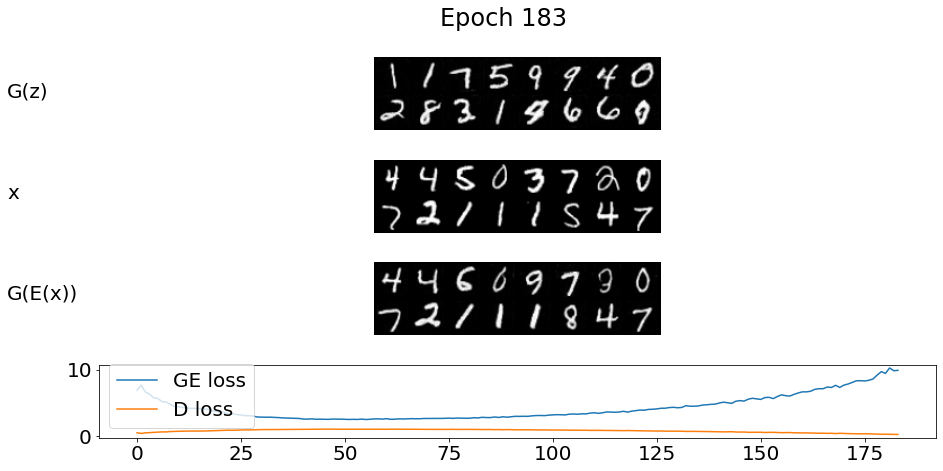

  0%|          | 1/469 [00:00<00:50,  9.27it/s]


Training... Epoch: 183, Discrimiantor Loss: 0.291, Generator Loss: 9.897


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


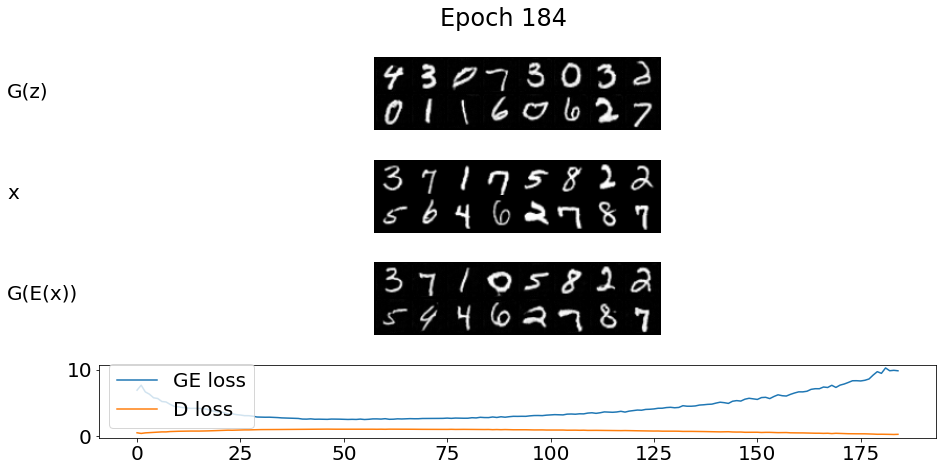

  0%|          | 1/469 [00:00<00:49,  9.52it/s]


Training... Epoch: 184, Discrimiantor Loss: 0.314, Generator Loss: 9.828


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


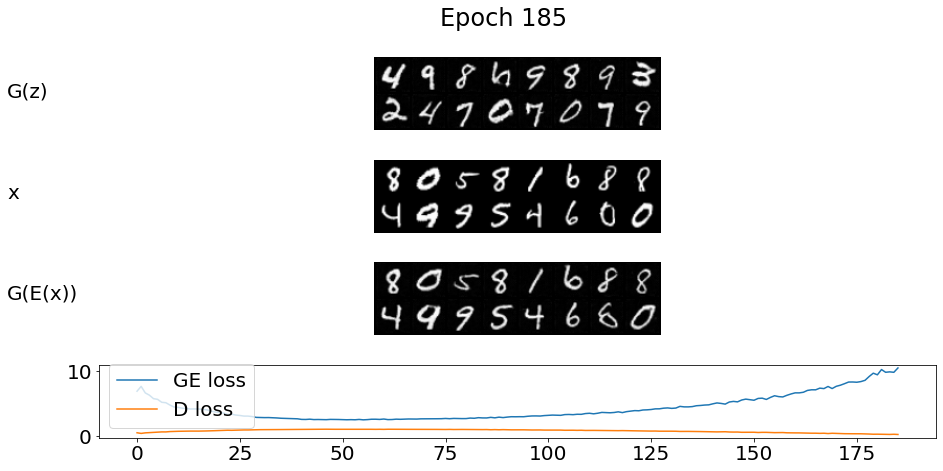

  0%|          | 1/469 [00:00<00:48,  9.65it/s]


Training... Epoch: 185, Discrimiantor Loss: 0.283, Generator Loss: 10.497


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


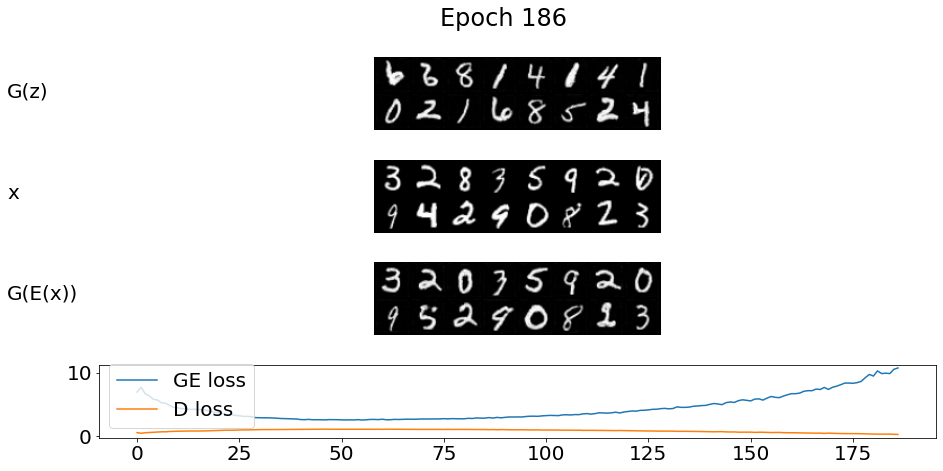

  0%|          | 1/469 [00:00<00:49,  9.53it/s]


Training... Epoch: 186, Discrimiantor Loss: 0.257, Generator Loss: 10.716


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


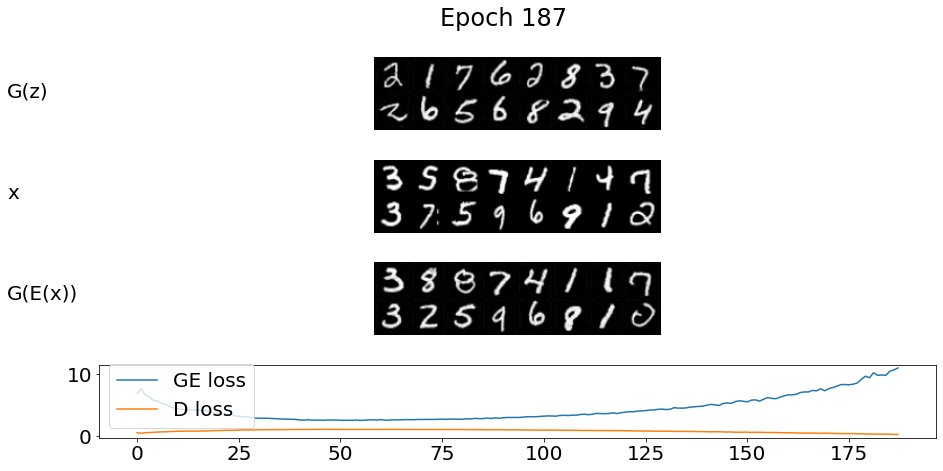

  0%|          | 1/469 [00:00<00:48,  9.63it/s]


Training... Epoch: 187, Discrimiantor Loss: 0.252, Generator Loss: 11.031


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


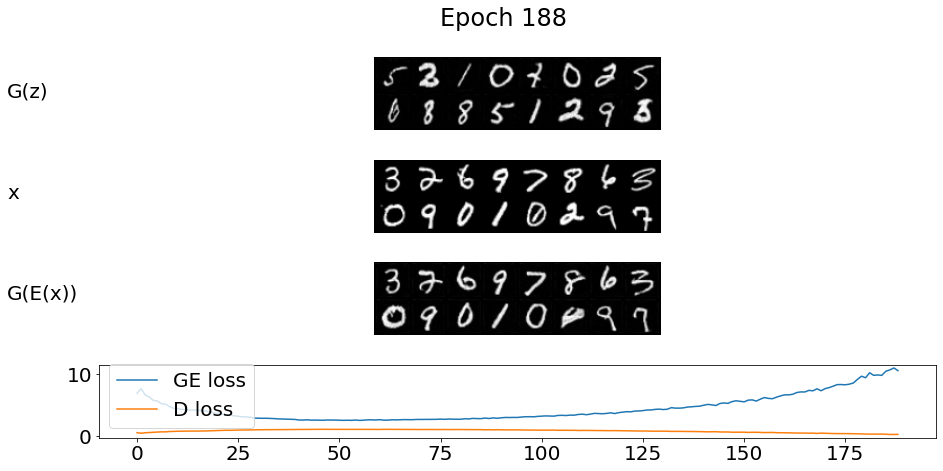

  0%|          | 1/469 [00:00<00:49,  9.51it/s]


Training... Epoch: 188, Discrimiantor Loss: 0.269, Generator Loss: 10.598


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


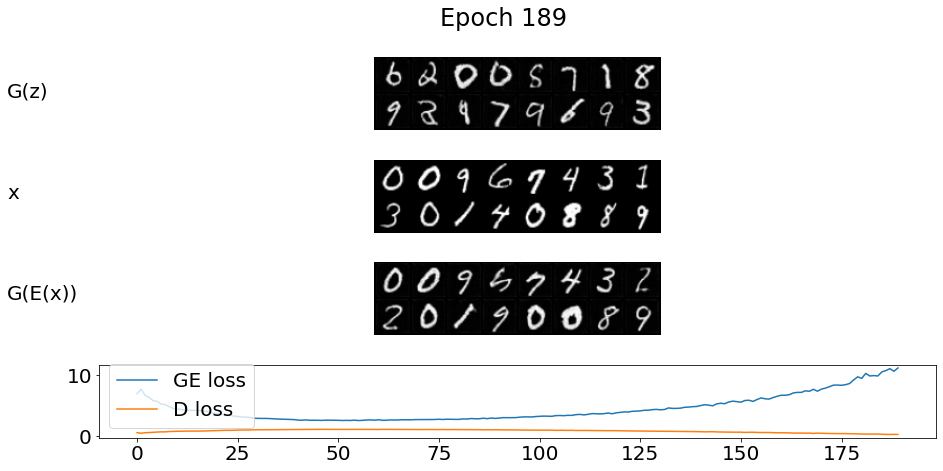

  0%|          | 1/469 [00:00<00:49,  9.45it/s]


Training... Epoch: 189, Discrimiantor Loss: 0.247, Generator Loss: 11.147


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


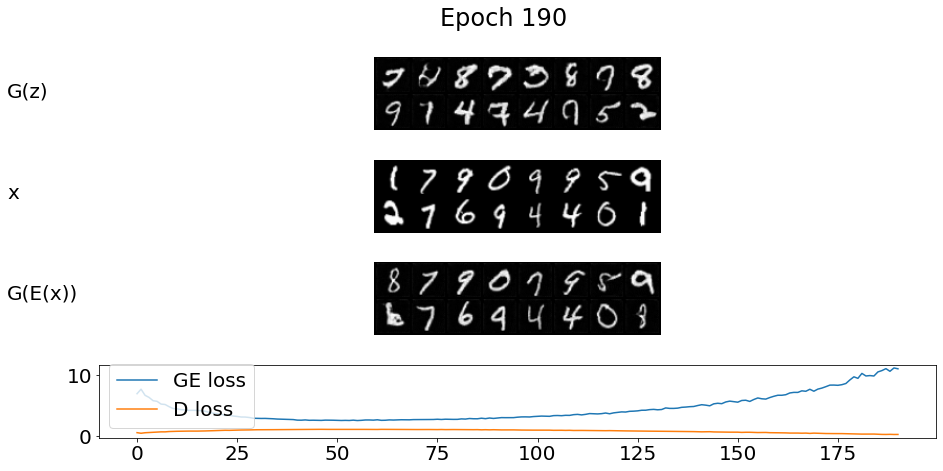

  0%|          | 1/469 [00:00<00:48,  9.64it/s]


Training... Epoch: 190, Discrimiantor Loss: 0.252, Generator Loss: 11.008


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


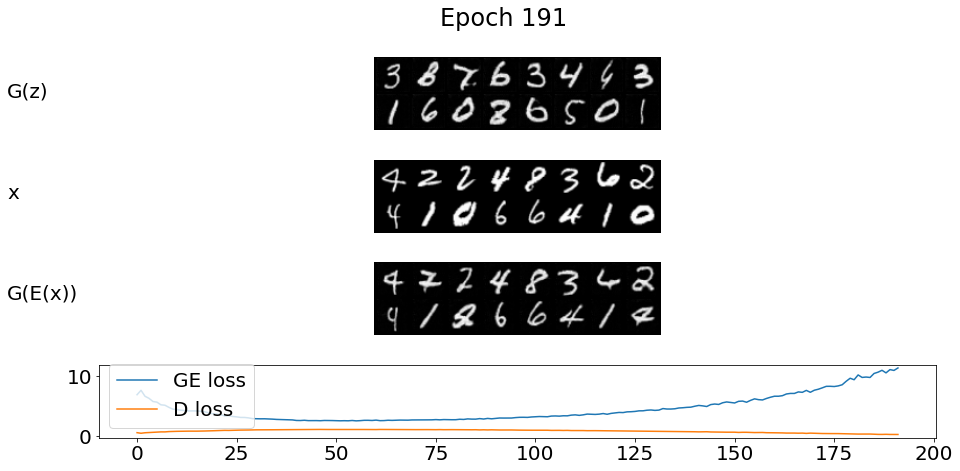

  0%|          | 1/469 [00:00<00:48,  9.74it/s]


Training... Epoch: 191, Discrimiantor Loss: 0.242, Generator Loss: 11.426


100%|██████████| 469/469 [01:00<00:00,  7.74it/s]


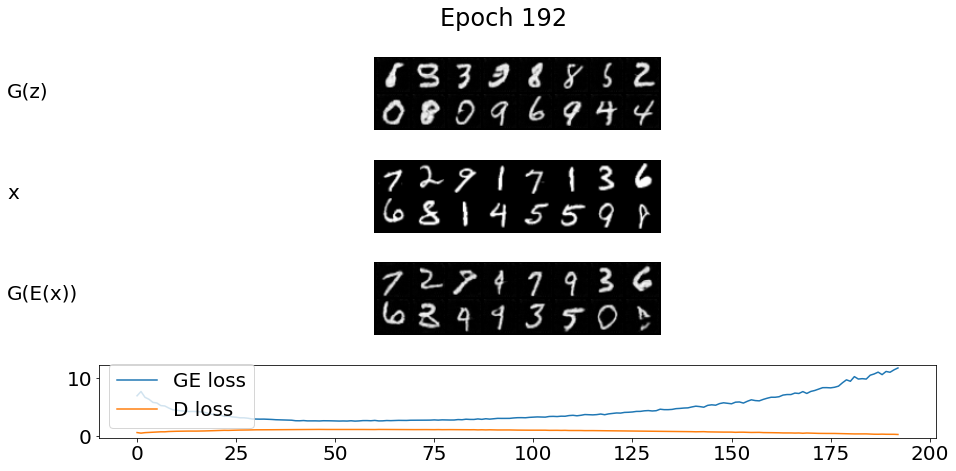

  0%|          | 1/469 [00:00<00:55,  8.43it/s]


Training... Epoch: 192, Discrimiantor Loss: 0.213, Generator Loss: 11.757


100%|██████████| 469/469 [01:00<00:00,  7.73it/s]


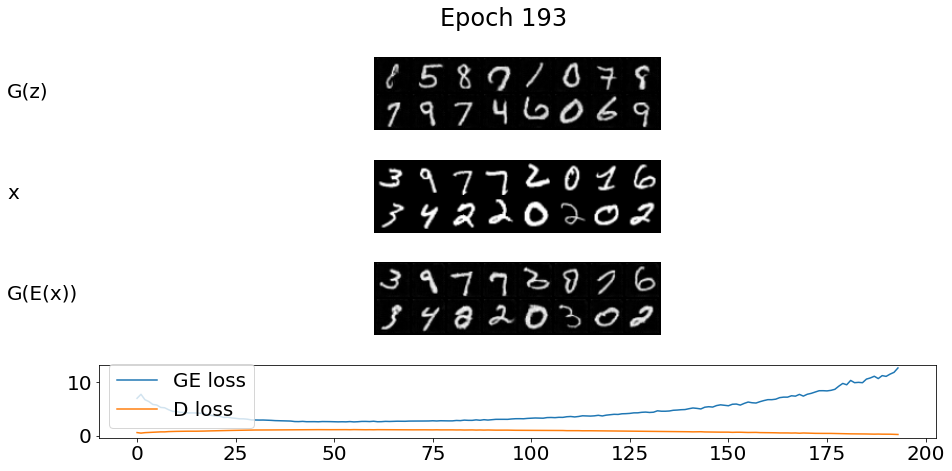

  0%|          | 1/469 [00:00<00:49,  9.49it/s]


Training... Epoch: 193, Discrimiantor Loss: 0.192, Generator Loss: 12.577


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


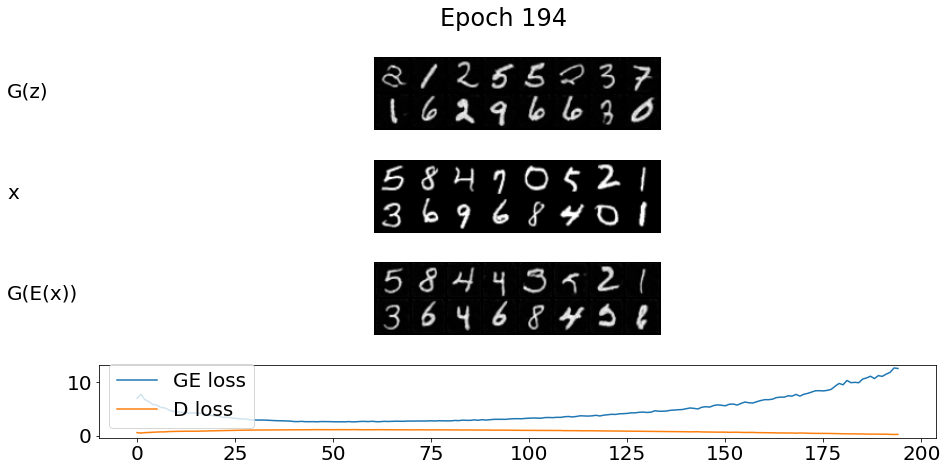

  0%|          | 1/469 [00:00<00:50,  9.18it/s]


Training... Epoch: 194, Discrimiantor Loss: 0.209, Generator Loss: 12.480


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


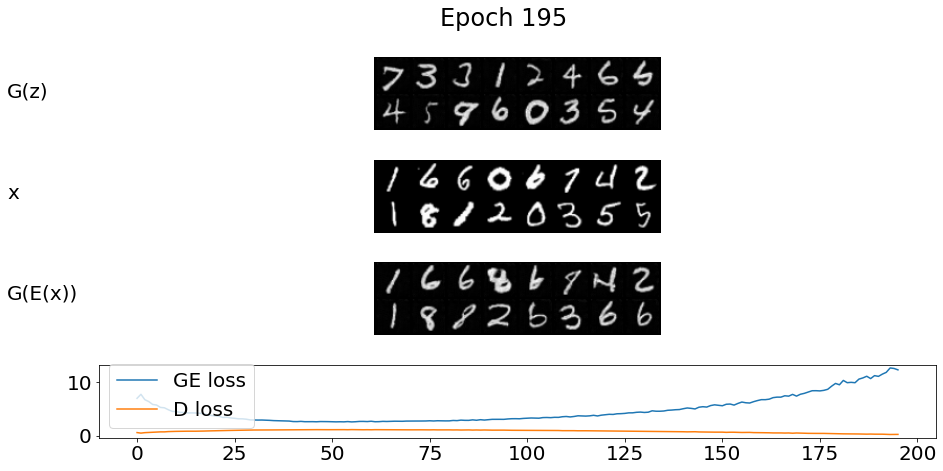

  0%|          | 1/469 [00:00<00:49,  9.44it/s]


Training... Epoch: 195, Discrimiantor Loss: 0.207, Generator Loss: 12.220


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


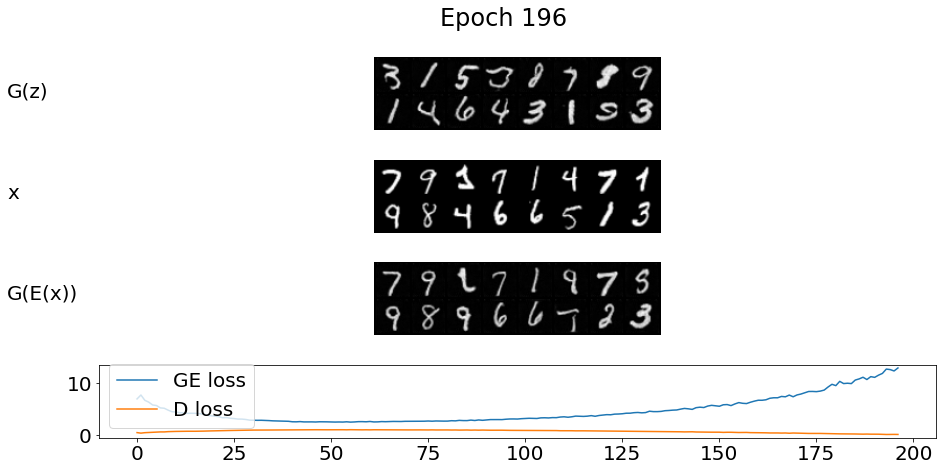

  0%|          | 1/469 [00:00<00:54,  8.66it/s]


Training... Epoch: 196, Discrimiantor Loss: 0.198, Generator Loss: 12.792


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


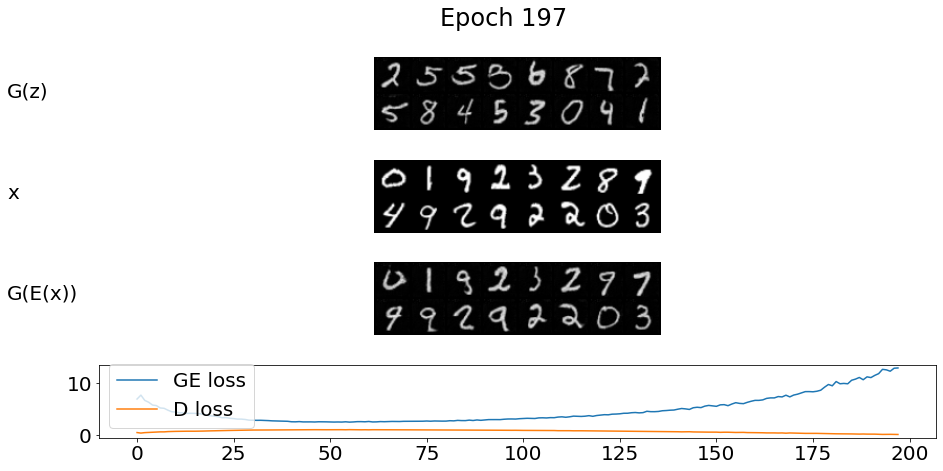

  0%|          | 1/469 [00:00<00:48,  9.55it/s]


Training... Epoch: 197, Discrimiantor Loss: 0.180, Generator Loss: 12.842


100%|██████████| 469/469 [01:00<00:00,  7.71it/s]


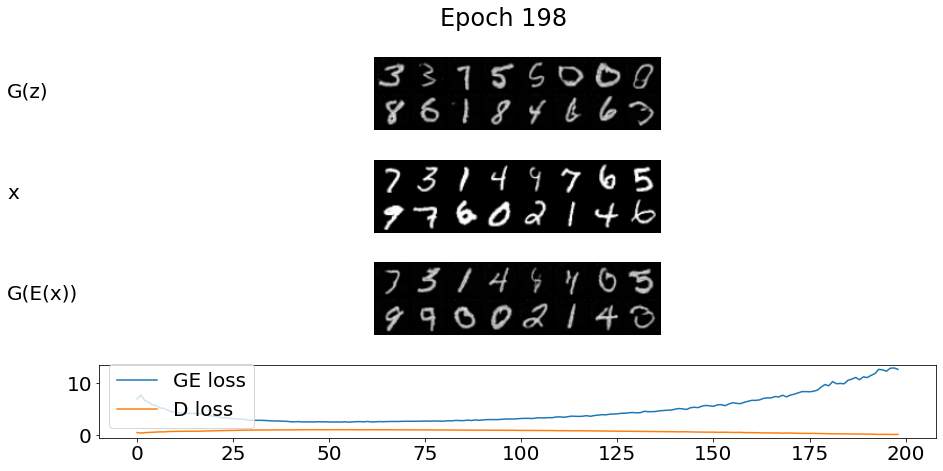

  0%|          | 1/469 [00:00<00:48,  9.65it/s]


Training... Epoch: 198, Discrimiantor Loss: 0.200, Generator Loss: 12.577


100%|██████████| 469/469 [01:00<00:00,  7.74it/s]


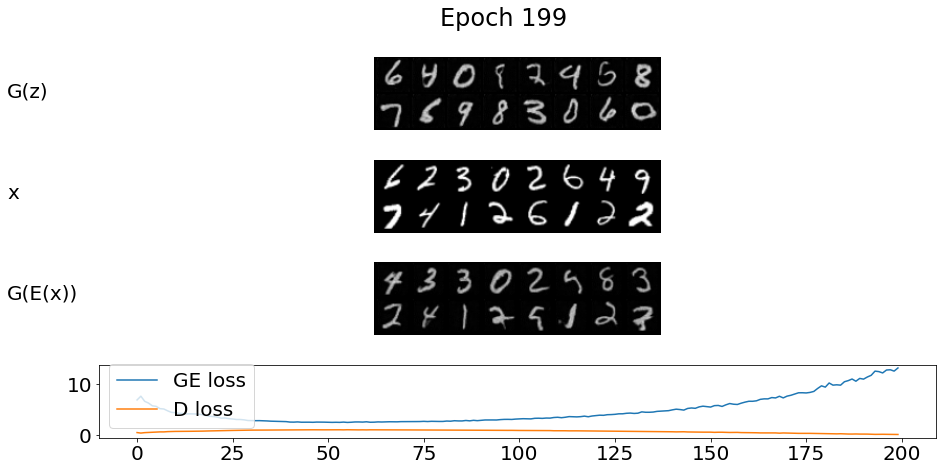

  0%|          | 1/469 [00:00<00:49,  9.53it/s]


Training... Epoch: 199, Discrimiantor Loss: 0.171, Generator Loss: 13.198


100%|██████████| 469/469 [01:00<00:00,  7.72it/s]


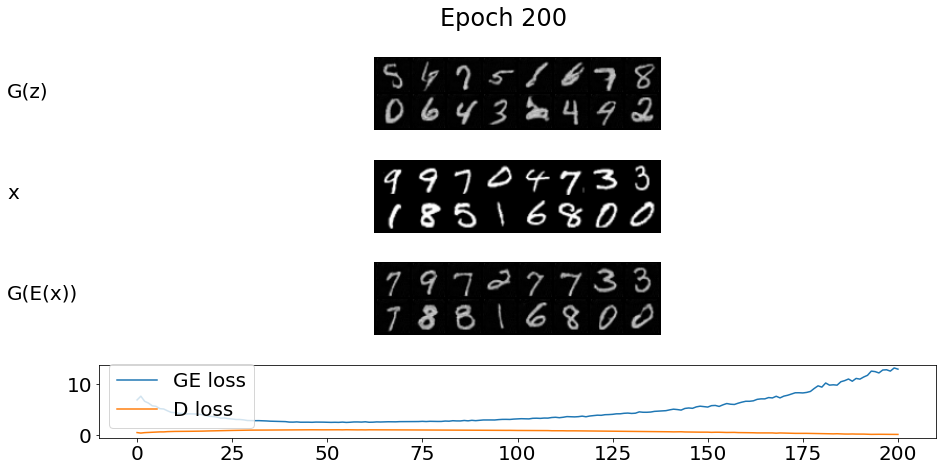


Training... Epoch: 200, Discrimiantor Loss: 0.182, Generator Loss: 12.963


In [ ]:

DATASET               = "SVHN" #Avaiable dataset: "MNIST","SVHN","cifar10"
NUMBER_OF_EPOCH       = 200
RL_ADAM               = 1e-4
BATCH_SIZE            = 128
LATENT_DIMENSION      = 256
ADD_NOISE             = True
IMAGE_COLOR_DEEP      = 0       #Color of the images. If we have rgb the value is 3 otherwise if we have black-white images the value is 1

PROCESS_LEARNING      = True    # This parameter allow us to decice if we want to train (True) or load (False) the Bigan Models
TEST_1NN              = False   # This parameter allow us to decide if we want to test the 1nn (low size of parameters)
LEARN_MODEL_1NN       = True   # This parameter allow us to decice if we want to train (True) or load (False) the 1NN Model

PLOTTING_AND_SAVE_IMAGE_OF_BIGAN_LEARNING_EVERY_  = 1   # This parameter allow us to decide after how many iterations the software save and plot the learning image of BIGAN (1 = ALWAYS)

if DATASET == "MNIST" :

  IMAGE_COLOR_DEEP = 1
  train,test = get_MNIST()

elif DATASET == "CIFAR_10":

  IMAGE_COLOR_DEEP = 3
  train,test = get_cifar10()

elif DATASET == "SVHN":

  IMAGE_COLOR_DEEP = 3
  train,test = get_SVHN()
  
else:

  IMAGE_COLOR_DEEP = 3
  train,test = get_CELEB_A()
      


#check if cuda is available.
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')


bigan = TrainerBiGAN(train, device)


# train or import models
if PROCESS_LEARNING:
  bigan.train()
else:
  bigan.import_models()
  bigan.test_model()

# Save models and images 

In [ ]:
# Crete the folder to save models and images

shutil.make_archive('/prj_gen_images', 'zip', '/prj_gen_images')
files.download('/prj_gen_images.zip') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
model_D = 'D.pt'
model_G = 'G.pt'
model_E = 'E.pt'

G,D,E = bigan.getModel()

if not os.path.exists("/prj_models"):
    os.makedirs("/prj_models")

path = F"/prj_models/{model_D}" 
torch.save(D.state_dict(), path)
path = F"/prj_models/{model_G}" 
torch.save(G.state_dict(), path)
path = F"/prj_models/{model_E}" 
torch.save(E.state_dict(), path)

shutil.make_archive('/prj_models', 'zip', '/prj_models')
files.download('/prj_models.zip') 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Evaluation
1-NEAREST NEIGHBOUR

In [ ]:
# functions used for the evaluation section

def get_SVHN(batchSize, data_dir=DATASET_DIR):
    """Returning cifar dataloder."""
    transform         = transforms.Compose([transforms.Resize(32), #3x32x32 images.
                                            transforms.ToTensor()])
    train             = datasets.SVHN(root=data_dir, split='train', download=True, transform=transform)
    test              = datasets.SVHN(root=data_dir, split='test', download=True, transform=transform)
    train_dataloader  = DataLoader(train, batch_size= batchSize, shuffle=False)
    test_dataloader   = DataLoader(test, batch_size= batchSize, shuffle=False)
    DATASET           = "SVHN"
    return train_dataloader,test_dataloader

def get_MNIST(batchSize, data_dir=DATASET_DIR):
    """Returning cifar dataloder."""
    transform         = transforms.Compose([transforms.Resize(32), #1x32x32 images.
                                            transforms.ToTensor()])
    train             = datasets.MNIST(root=data_dir, train=True, download=True, transform=transform)
    test              = datasets.MNIST(root=data_dir, train=False, download=True, transform=transform)
    train_dataloader  = DataLoader(train, batch_size=batchSize, shuffle= False)
    test_dataloader   = DataLoader(test, batch_size=batchSize, shuffle= False)
    DATASET           = "MNIST"
    return train_dataloader,test_dataloader

def get_cifar10(batchSize, data_dir=DATASET_DIR):
    """Returning cifar dataloder."""
    transform         = transforms.Compose([transforms.Resize(32), #1x32x32 images.
                                            transforms.ToTensor()])
    train             = datasets.cifar10(root=data_dir, train=True, download=True, transform=transform)
    test              = datasets.cifar10(root=data_dir, train=False, download=True, transform=transform)
    train_dataloader  = DataLoader(train, batch_size=batchSize, shuffle= False)
    test_dataloader   = DataLoader(test, batch_size=batchSize, shuffle= False)
    DATASET           = "cifar10"
    return train_dataloader,test_dataloader


def print_image(imageBigan, original, i):
  vutils.save_image(imageBigan, '/prj_gen_images/{}_eval_model.png'.format(i))
  vutils.save_image(original,   '/prj_gen_images/{}_eval_original.png'.format(i))

  ge_img  = mpimg.imread(       '/prj_gen_images/{}_eval_model.png'.format(i))
  x_img   = mpimg.imread(       '/prj_gen_images/{}_eval_original.png'.format(i))
  
  fig, ax = plt.subplots(2, 1, figsize=(10, 10))
  plt.rcParams.update({'font.size': 20})
  fig.text(0.10, 0.70, 'G(E(x))', ha='left')
  fig.text(0.10, 0.30, 'x', ha='left')

  ax[0].imshow(ge_img, cmap='gray')
  ax[0].axis('off')
  ax[1].imshow(x_img, cmap='gray')
  ax[1].axis('off')

  plt.show()



def test_image(X_train):
    img = X_train[0].squeeze()
    plt.imshow(img)
    plt.show()

def extract_data(data, size):
  X = []; Y = [] 
  for i,(xs,labels)  in enumerate(data):  # take batches
    complete_tag = False
    for x in xs:                # take single element
      X.append(x.numpy())
      if len(X) >= size:
        break 
    for label in labels:        # take single label
      Y.append(label.numpy())
      if len(Y) >= size:
        complete_tag = True  
        break
    if complete_tag: # we got all the elements, exit
      break
  return  X, Y



# save and load using pickle lib
def save_KNN(KNN):
    KNN_model = '1NN.pt'
    if not os.path.exists("/prj_1NN_model"):
        os.makedirs("/prj_1NN_model")

    path = F"/prj_1NN_model/{KNN_model}"
    pickle.dump(KNN, open(path, 'wb'))

    shutil.make_archive('/prj_1NN_model', 'zip', '/prj_1NN_model')
    files.download('/prj_1NN_model.zip')

def load_KNN(X_test, test):
  path = '/content/drive/My Drive/Colab Notebooks/NN/Models/1-NN/'
  %ls
  model_path = path + '1NN.pt'
  print('Loading model from : \n - {}\n'.format(model_path))
  # load the model from disk
  if model_path is not None:
      KNN = pickle.load(open(model_path, 'rb'))
  if test:
    y_test_pred = KNN.predict(X_test)
    acc = accuracy_score(y_test_pred,y_test)
    print('\n---------------------->Accuracy: %f' % (acc))
  return KNN


## Learning 1-NN 

Extracting data from MNIST....
image shape(1, 32, 32)
End extraction phase, time: 10.035778760910034 [s]


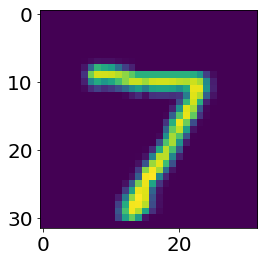

learning the model....
End learning phase, time: 59.52140140533447 [s]
Making predictions....
End prediction phase, time: 1417.0250318050385 [s]

---------------------->Accuracy: 0.971900


In [ ]:
if LEARN_MODEL_1NN:

  KNN = KNeighborsClassifier(n_neighbors=1)

  train_KNN   = None
  test_KNN    = None

  if DATASET == "MNIST" :

    train_KNN, test_KNN = get_MNIST(batchSize=128)

  elif DATASET == "CIFAR_10":

    train_KNN, test_KNN = get_cifar10(batchSize=128)

  elif DATASET == "SVHN":

    train_KNN, test_KNN = get_SVHN(batchSize=128)
    
  else:
    train_KNN, test_KNN = get_CELEB_A(batchSize=128)



  # get the size of the dataset
  train_size  = train_KNN.dataset.data.shape
  test_size   = test_KNN.dataset.data.shape


  if not(TEST_1NN): # maximum values for the complete evaluation
      train_size  = train_size[0]
      test_size   = test_size[0]
  else:  # size just the test the classifier
      train_size  = 2000
      test_size   = 500

  num_test = test_size # X_test.size

  # **************************************************************************************************
  startTime = time.time()
  print("Extracting data from {}....".format(DATASET))
  X_train, y_train = extract_data(train_KNN, train_size)
  print("image shape{}".format(X_train[0].shape))
  X_test, y_test = extract_data(test_KNN, test_size)
  print("End extraction phase, time: {} [s]".format(time.time() -startTime))

  test_image(X_test)
  X_train = np.asarray(X_train)
  """
  scikit-learn expects 2d num arrays for the training dataset for a fit function.
  The dataset you are passing in is a 3d array you need to reshape the array into a 2d.
  """
  X_train = np.reshape(X_train, (X_train.shape[0], -1))
  # **************************************************************************************************
  startTime = time.time()
  print("learning the model....")
  KNN.fit(X_train, y_train)
  print("End learning phase, time: {} [s]".format(time.time() - startTime))
  X_test = np.asarray(X_test)
  X_test = np.reshape(X_test, (X_test.shape[0], -1))
  # **************************************************************************************************
  startTime = time.time()
  print("Making predictions....")
  y_test_pred = KNN.predict(X_test)
  print("End prediction phase, time: {} [s]".format(time.time() - startTime))
  # **************************************************************************************************
  acc = accuracy_score(y_test_pred,y_test)
  print('\n---------------------->Accuracy: %f' % (acc))

  # save the model
  # save_KNN(KNN)

##Save 1NN

In [ ]:
if LEARN_MODEL_1NN:
  save_KNN(KNN)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## 1-NN evaluations of BIGAN 

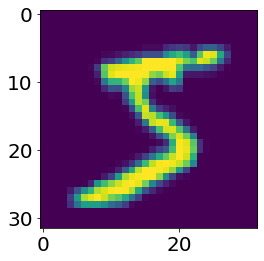

(10000, 1, 32, 32)
10000
[7 2 1 ... 9 8 6]
[array(7), array(2), array(1), array(0), array(4), array(1), array(4), array(9), array(5), array(9), array(0), array(6), array(9), array(0), array(1), array(5), array(9), array(7), array(3), array(4), array(9), array(6), array(6), array(5), array(4), array(0), array(7), array(4), array(0), array(1), array(3), array(1), array(3), array(4), array(7), array(2), array(7), array(1), array(2), array(1), array(1), array(7), array(4), array(2), array(3), array(5), array(1), array(2), array(4), array(4), array(6), array(3), array(5), array(5), array(6), array(0), array(4), array(1), array(9), array(5), array(7), array(8), array(9), array(3), array(7), array(4), array(6), array(4), array(3), array(0), array(7), array(0), array(2), array(9), array(1), array(7), array(3), array(2), array(9), array(7), array(7), array(6), array(2), array(7), array(8), array(4), array(7), array(3), array(6), array(1), array(3), array(6), array(9), array(3), array(1), array(

In [ ]:
# bigan and test taken from the main block
train_KNN, test_KNN = get_MNIST(batchSize = 128)

# get the size of the dataset
train_size  = train_KNN.dataset.data.shape
test_size   = test_KNN.dataset.data.shape

if not(TEST_1NN): # maximum values for the complete evaluation
    train_size  = train_size[0]
    test_size   = test_size[0]
else:  # size just the test the classifier
    train_size  = 2000
    test_size   = 500


X_train, y_train  = extract_data(train_KNN, train_size)
X_test, y_test    = extract_data(test_KNN, test_size)



# ************************** training 1-nn classifier **********************************************
# todo import the model built in the test 0 section 
X_test = np.asarray(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], -1))

if LEARN_MODEL_1NN:

  KNN           = KNeighborsClassifier(n_neighbors=1)
  X_train       = np.asarray(X_train)
  test_image(X_train)
  X_train       =  np.reshape(X_train, (X_train.shape[0], -1))
  KNN.fit(X_train, y_train)
  y_test_pred   = KNN.predict(X_test)

else:
  # load it
  KNN           = load_KNN(X_test, TEST_1NN)

# **************************************************************************************************

# ****************************** prediction by the model *******************************************
GE_result = []

with torch.no_grad():
    tmp = True
    for i,(x, label) in enumerate(test_KNN):
      E_bigan = bigan.E(x.float().to(device))
      y_tensor = bigan.G(E_bigan)
      y = y_tensor.cpu().numpy()
      for elem in y:   # take each element in the batch 
        if len(GE_result) < test_size:
          GE_result.append(elem)
      if i * BATCH_SIZE >= test_size:
        break

# adjust the bigan prediction for 1-NN
GE_result = np.asarray(GE_result)

print(GE_result.shape)

GE_result = np.reshape(GE_result, (GE_result.shape[0], -1))

# **************************************************************************************************

# ***************************** final evaluation by 1-NN *******************************************


y_BIGAN_test_pred = KNN.predict(GE_result)

print(len(y_BIGAN_test_pred))
print(y_BIGAN_test_pred)

# ACCURACY EVALUATION THROUGH LABELS
print(y_test)
print(len(y_test))
num_correct = np.sum(y_test == y_BIGAN_test_pred)

# ACCURACY EVALUATION THROUGH 1-NN DATASET PREDICTIONS
# print(y_test_pred)
# print(y_test_pred)
# num_correct = np.sum(y_test_pred == y_BIGAN_test_pred)

accuracy = float(num_correct) / test_size
print('Got %d / %d correct => accuracy: %f' % (num_correct, test_size, accuracy))